<a href="https://colab.research.google.com/github/schumbar/CMPE256/blob/main/assignment_03/CMPE256_Unstructured_Audio_and_Wave_Files.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Assignment 03: Feature Engineering Unstructured Data (Audio & Wave Files)
By Shawn Chumbar

Sources:
1. [Librosa Display Specshow Documentation](https://librosa.org/doc/main/generated/librosa.display.specshow.html)

2. [Librosa Feature Melspectrogram Documentation](https://librosa.org/doc/main/generated/librosa.feature.melspectrogram.html)

3. [Librosa STFT Documentation](https://librosa.org/doc/main/generated/librosa.stft.html)

4. [Librosa Beat Tracker Documentation](https://librosa.org/doc/main/generated/librosa.beat.beat_track.html)

5. [Librosa CQT Documentation](https://librosa.org/doc/main/generated/librosa.cqt.html)

6. [CMPE256 In-class Demo Files](https://sjsu.instructure.com/courses/1576186/files/folder/Session5/InClassDemoFiles)

**Tasks:**

Learning Objective: The purpose of this assignment is to derive feature engineering spectrograms of wave files.

1. Display a spectrogram/chromagram/cqt/etc.

2. Compute a mel-scaled spectrogram.

3. Short-time Fourier transform (STFT).

4. Beat Tracker.

5. Compute the constant-Q transform of an audio signal.

## Setup

In [155]:
!pip install librosa

In [156]:
!pip install matplotlib

In [157]:
!pip3 install numba>=0.53

In [158]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [159]:
import librosa
import numpy as np
import numpy as np
import scipy
import matplotlib.pyplot as plt

import librosa
import librosa.display

### File Location and File Names
I have edited the file names to be easier to identify. Please see the list of file names below with what those files represent:

1. **europa.wav**: Audio from NASA's Juno Mission: Europa Flyby
2. **parker.mp3**: Johns Hopkins APL - Parker Solar Probe - Whistler Mode Waves
3. **whistler.mp3**: Whistler Waves
4. **KIC7671081B.mp3**: Star KIC7671081B Light Curve Waves
5. **KIC12268220C.mp3**: Star KIC12268220C Light Curve Waves to Sound




In [160]:
def get_location(file_name):
  file_location = '/content/drive/MyDrive/Colab Notebooks/CMPE256/assignment_03/dataset/'
  full_file_name = file_location + file_name
  return full_file_name

# I've renamed some of these voice files to have a cleaner look
europa_file_path = get_location('europa.wav')
parker_file_path = get_location('parker.mp3')
whistler_file_path = get_location('whistler.mp3')
KIC7671081B_file_path = get_location('KIC7671081B.mp3')
KIC12268220C_file_path = get_location('KIC12268220C.mp3')

## Europa


### Setup

In [161]:
current_file = europa_file_path

In [162]:
audio_data = current_file
x , sr = librosa.load(audio_data)
print(type(x), type(sr))
print(x.shape, sr)

<class 'numpy.ndarray'> <class 'int'>
(260848,) 22050


In [163]:
librosa.load(audio_data, sr=44100)

(array([-0.00393779, -0.00216301,  0.00120264, ...,  0.0060122 ,
         0.00361361,  0.00150867], dtype=float32),
 44100)

In [164]:
import IPython.display as ipd
ipd.Audio(audio_data)

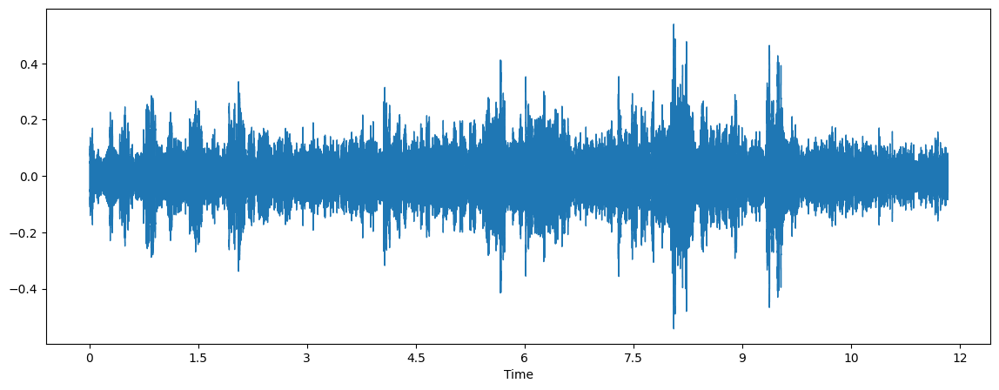

In [165]:
%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display
plt.figure(figsize=(14, 5))
librosa.display.waveshow(x, sr=sr)

In [166]:
# Build a simple chroma filter bank
chromafb = librosa.filters.chroma(sr=22050, n_fft=4096)

chromafb

array([[1.70601543e-05, 2.82992725e-04, 1.03555294e-03, ...,
        5.23030704e-21, 4.43047226e-21, 3.75236833e-21],
       [1.66987356e-05, 3.18591396e-04, 1.46405352e-03, ...,
        1.25662976e-13, 1.10109757e-13, 9.64649842e-14],
       [1.61444223e-05, 3.48842266e-04, 1.90847355e-03, ...,
        5.52980168e-08, 5.01214537e-08, 4.54209257e-08],
       ...,
       [1.68931711e-05, 3.02419503e-04, 1.25730084e-03, ...,
        4.03871397e-17, 4.63902409e-17, 5.32694454e-17],
       [1.71591892e-05, 2.65152019e-04, 8.56101280e-04, ...,
        2.25072222e-25, 2.67424414e-25, 3.17644285e-25],
       [1.72155414e-05, 2.44485302e-04, 6.75355259e-04, ...,
        3.98721026e-30, 3.26509862e-30, 2.67339596e-30]], dtype=float32)

In [167]:
# Use quarter-tones instead of semitones
librosa.filters.chroma(sr=22050, n_fft=4096, n_chroma=24)

array([[1.2062923e-05, 2.0009540e-04, 7.3222251e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.1952894e-05, 2.1304651e-04, 8.7951310e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.1807369e-05, 2.2526611e-04, 1.0352081e-03, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       ...,
       [1.2171624e-05, 1.7373025e-04, 4.8452709e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.2172794e-05, 1.7286799e-04, 4.7753262e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.2136448e-05, 1.8663100e-04, 5.9735152e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00]], dtype=float32)

In [168]:
# Equally weight all octaves
librosa.filters.chroma(sr=22050, n_fft=4096, octwidth=None)

array([[3.06632757e-01, 2.43654341e-01, 1.60742402e-01, ...,
        2.75466492e-20, 2.33491276e-20, 1.97881458e-20],
       [3.00136745e-01, 2.74304509e-01, 2.27255851e-01, ...,
        6.61833761e-13, 5.80291837e-13, 5.08708906e-13],
       [2.90173739e-01, 3.00350249e-01, 2.96240419e-01, ...,
        2.91240070e-07, 2.64146166e-07, 2.39527623e-07],
       ...,
       [3.03631455e-01, 2.60380656e-01, 1.95162937e-01, ...,
        2.12708409e-16, 2.44482217e-16, 2.80916862e-16],
       [3.08412760e-01, 2.28293657e-01, 1.32887244e-01, ...,
        1.18539604e-24, 1.40935927e-24, 1.67509979e-24],
       [3.09425622e-01, 2.10499778e-01, 1.04831174e-01, ...,
        2.09995848e-29, 1.72074678e-29, 1.40981758e-29]], dtype=float32)

### Step 1: Display Spectrogram, Chromogram, and CQT

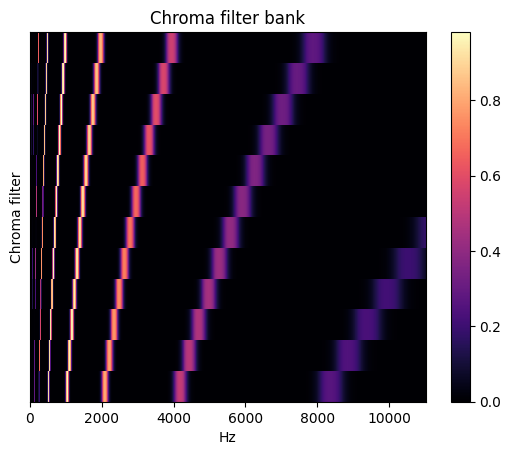

In [169]:
#https://librosa.org/doc-playground/main/generated/librosa.filters.chroma.html?highlight=chroma#librosa.filters.chroma
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
img = librosa.display.specshow(chromafb, x_axis='linear', ax=ax)
ax.set(ylabel='Chroma filter', title='Chroma filter bank')
fig.colorbar(img, ax=ax)


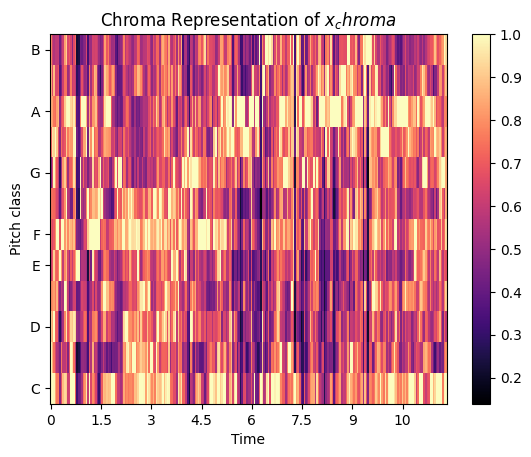

In [170]:
#https://librosa.org/doc-playground/main/auto_examples/plot_music_sync.html?highlight=chroma

# Extract Chroma Features

hop_length = 1024

x_chroma = librosa.feature.chroma_cqt(y=x, sr=sr,
                                         hop_length=hop_length)

fig, ax = plt.subplots(nrows=1, sharey=True)
img = librosa.display.specshow(x_chroma, x_axis='time',
                               y_axis='chroma',
                               hop_length=hop_length, ax=ax)
ax.set(title='Chroma Representation of $x_chroma$')
fig.colorbar(img, ax=ax)

In [171]:
#https://librosa.org/doc-playground/main/generated/librosa.feature.chroma_stft.html?highlight=ibrosa%20feature%20chroma_stft#librosa.feature.chroma_stft
#Energy
librosa.feature.chroma_stft(y=x, sr=sr)

array([[0.61634874, 0.4849285 , 0.51474786, ..., 0.6616401 , 0.9255943 ,
        0.57819104],
       [0.4828674 , 0.5870249 , 0.635961  , ..., 0.706573  , 0.77270734,
        0.51354074],
       [0.34135598, 0.44609743, 0.6792504 , ..., 0.63273895, 1.        ,
        0.5355197 ],
       ...,
       [0.52580196, 0.75280136, 1.        , ..., 0.86899996, 0.6838907 ,
        0.29304835],
       [1.        , 1.        , 0.8122901 , ..., 0.5610647 , 0.9699289 ,
        0.517936  ],
       [0.54446876, 0.33025807, 0.30387682, ..., 0.45404723, 0.9052126 ,
        0.55098355]], dtype=float32)

In [172]:
# Use an energy (magnitude) spectrum instead of power spectrogram
S = np.abs(librosa.stft(x))
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
chroma

array([[0.8523884 , 0.7027443 , 0.83226293, ..., 0.7439692 , 0.67444134,
        0.6467846 ],
       [0.71534836, 0.72438467, 0.86669636, ..., 0.7205255 , 0.78733724,
        0.69714874],
       [0.54826695, 0.4273349 , 0.66006976, ..., 0.70185775, 0.8309079 ,
        0.7107963 ],
       ...,
       [1.        , 1.        , 1.        , ..., 0.768     , 0.8569112 ,
        0.7198222 ],
       [0.8788838 , 0.57510406, 0.57173055, ..., 0.6974177 , 0.9580055 ,
        0.8859217 ],
       [0.9274096 , 0.6068394 , 0.7014278 , ..., 0.77326685, 1.        ,
        0.91081214]], dtype=float32)

In [173]:
# Use an energy (magnitude) spectrum instead of power spectrogram
S = np.abs(librosa.stft(x))
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
chroma

array([[0.8523884 , 0.7027443 , 0.83226293, ..., 0.7439692 , 0.67444134,
        0.6467846 ],
       [0.71534836, 0.72438467, 0.86669636, ..., 0.7205255 , 0.78733724,
        0.69714874],
       [0.54826695, 0.4273349 , 0.66006976, ..., 0.70185775, 0.8309079 ,
        0.7107963 ],
       ...,
       [1.        , 1.        , 1.        , ..., 0.768     , 0.8569112 ,
        0.7198222 ],
       [0.8788838 , 0.57510406, 0.57173055, ..., 0.6974177 , 0.9580055 ,
        0.8859217 ],
       [0.9274096 , 0.6068394 , 0.7014278 , ..., 0.77326685, 1.        ,
        0.91081214]], dtype=float32)

In [174]:
# Use a pre-computed power spectrogram with a larger frame
S = np.abs(librosa.stft(x, n_fft=4096))**2
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
chroma

array([[0.5215754 , 0.5597408 , 0.4955959 , ..., 0.52692044, 1.        ,
        0.944313  ],
       [0.57953656, 0.6789489 , 0.6561465 , ..., 0.3534917 , 0.6210698 ,
        0.8226475 ],
       [0.4138862 , 0.58092386, 0.5527901 , ..., 0.2216527 , 0.6244564 ,
        0.8381206 ],
       ...,
       [0.69132817, 0.90700096, 1.        , ..., 0.34405348, 0.67587095,
        0.7932645 ],
       [1.        , 1.        , 0.9758091 , ..., 0.37259188, 0.72786933,
        0.8015127 ],
       [0.4022414 , 0.34899393, 0.557816  , ..., 0.45417416, 0.9246404 ,
        0.7333227 ]], dtype=float32)

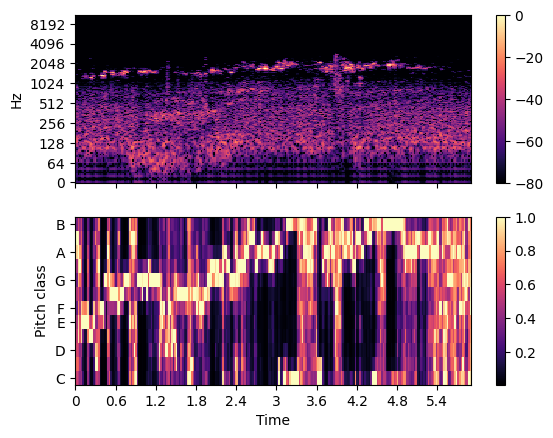

In [175]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(nrows=2, sharex=True)
img = librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),
                               y_axis='log', x_axis='time', ax=ax[0])
fig.colorbar(img, ax=[ax[0]])
ax[0].label_outer()
img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax[1])
fig.colorbar(img, ax=[ax[1]])

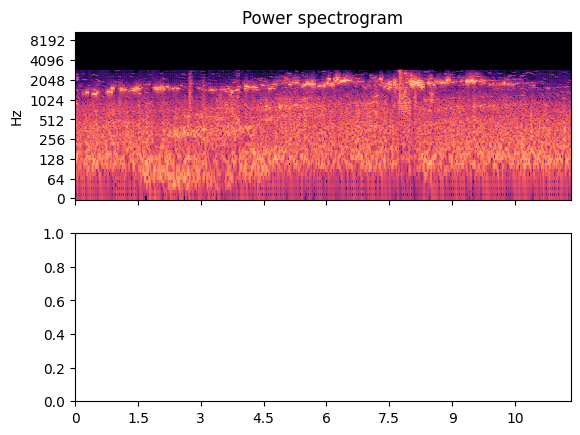

In [176]:
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()

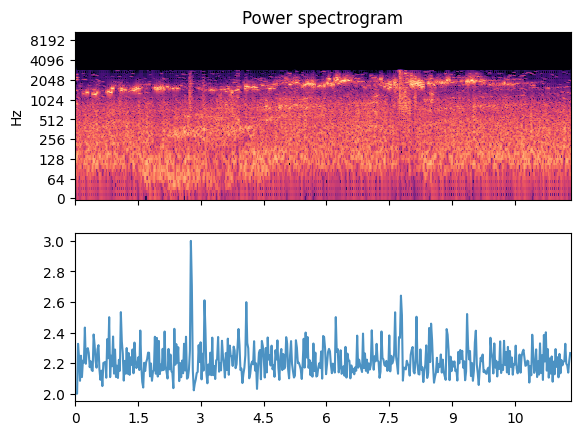

In [177]:
# Construct a standard onset function
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()
onset_env = librosa.onset.onset_strength(y=x, sr=sr)
ax[1].plot(times, 2 + onset_env / onset_env.max(), alpha=0.8,
           label='Mean (mel)')

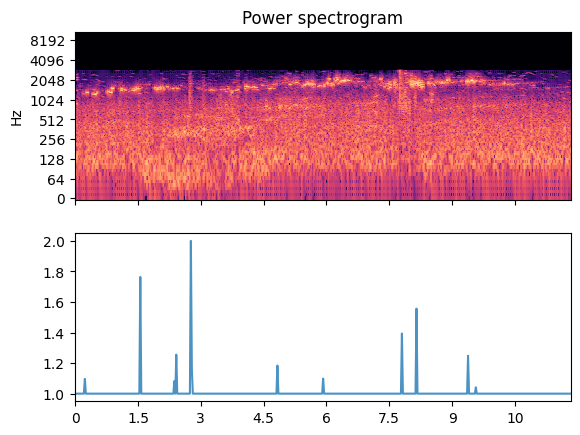

In [178]:
# Median aggregation, and custom mel options
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()

onset_env = librosa.onset.onset_strength(y=x, sr=sr,
                                         aggregate=np.median,
                                         fmax=8000, n_mels=256)
ax[1].plot(times, 1 + onset_env / onset_env.max(), alpha=0.8,
           label='Median (custom mel)')


[Text(0, 0.5, 'Normalized strength'), []]

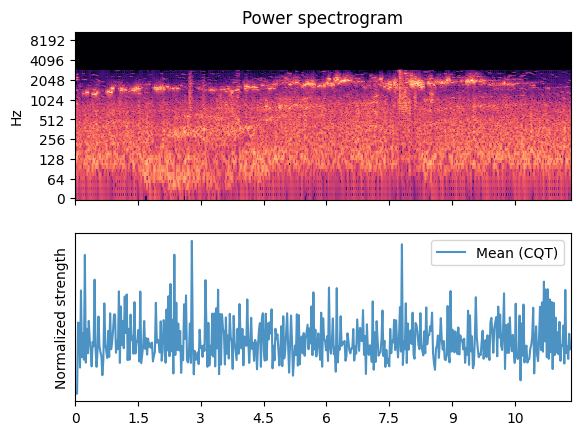

In [179]:
# Constant-Q spectrogram instead of Mel
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()


C = np.abs(librosa.cqt(y=x, sr=sr))
onset_env = librosa.onset.onset_strength(sr=sr, S=librosa.amplitude_to_db(C, ref=np.max))
ax[1].plot(times, onset_env / onset_env.max(), alpha=0.8,
         label='Mean (CQT)')
ax[1].legend()
ax[1].set(ylabel='Normalized strength', yticks=[])


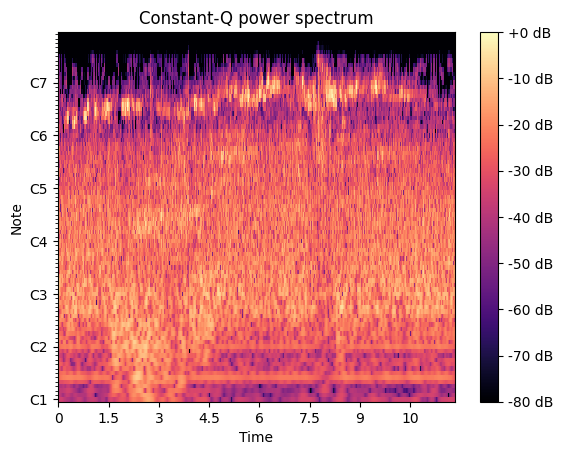

In [180]:
C = np.abs(librosa.cqt(x, sr=sr))
fig, ax = plt.subplots()
img = librosa.display.specshow(librosa.amplitude_to_db(C, ref=np.max),
                               sr=sr, x_axis='time', y_axis='cqt_note', ax=ax)
ax.set_title('Constant-Q power spectrum')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

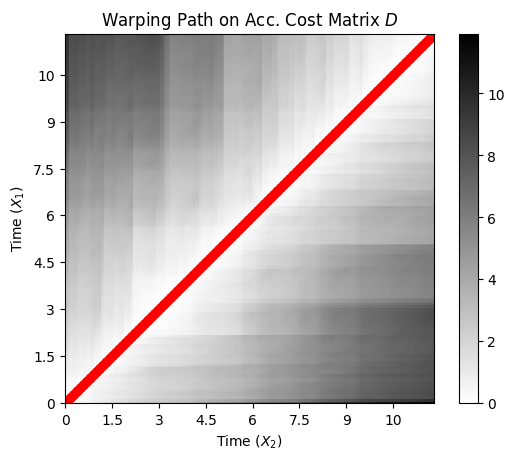

In [181]:
D, wp = librosa.sequence.dtw(X=x_chroma,Y=x_chroma, metric='cosine')
wp_s = librosa.frames_to_time(wp, sr=sr, hop_length=hop_length)

fig, ax = plt.subplots()
img = librosa.display.specshow(D, x_axis='time', y_axis='time', sr=sr,
                               cmap='gray_r', hop_length=hop_length, ax=ax)
ax.plot(wp_s[:, 1], wp_s[:, 0], marker='o', color='r')
ax.set(title='Warping Path on Acc. Cost Matrix $D$',
       xlabel='Time $(X_2)$', ylabel='Time $(X_1)$')
fig.colorbar(img, ax=ax)


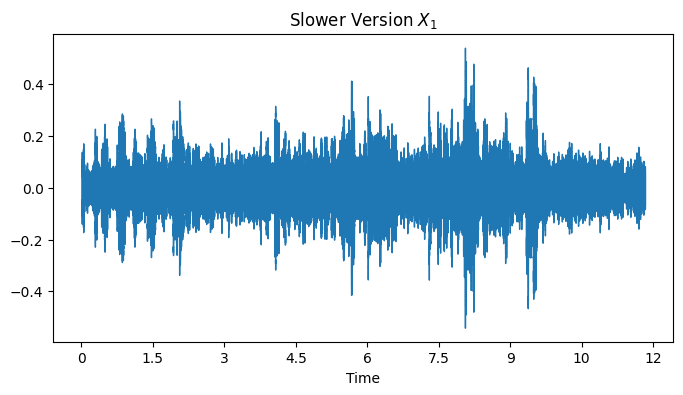

In [182]:
#Alternative Visualization in the Time Domain
fig, ax1 = plt.subplots(nrows=1, sharex=True, sharey=True, figsize=(8, 4))

# Plot x_1
librosa.display.waveshow(x, sr=sr, ax=ax1)
ax1.set(title='Slower Version $X_1$')
ax1.label_outer()


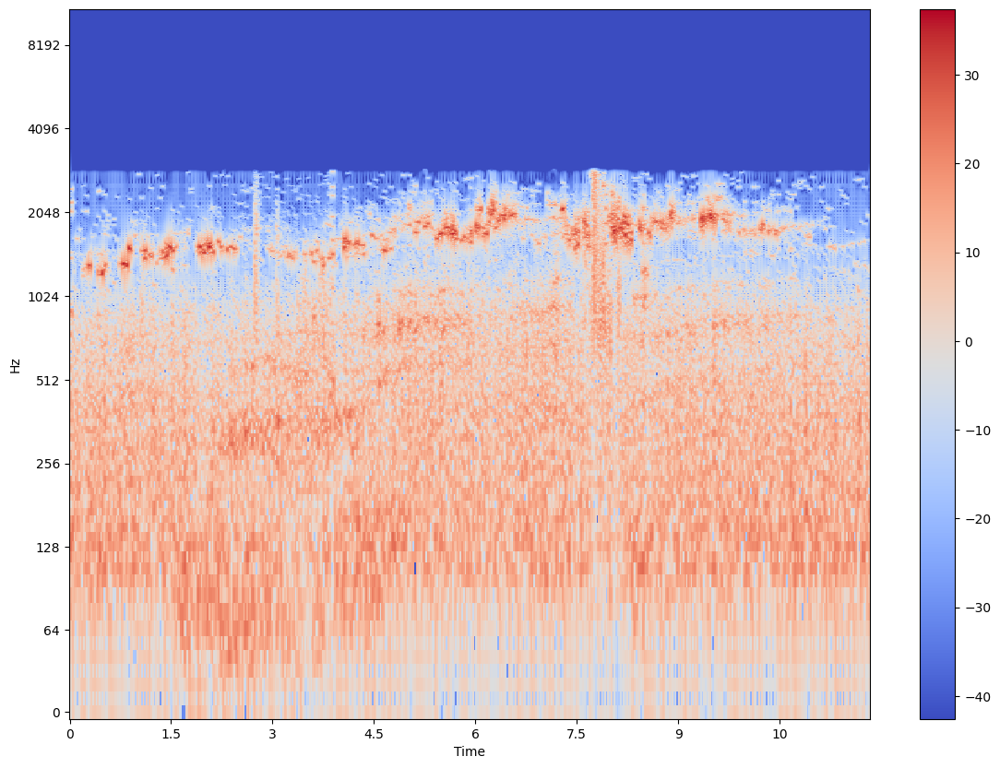

In [183]:
# Spectrogram
import matplotlib.pyplot as plt
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 10))

librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()

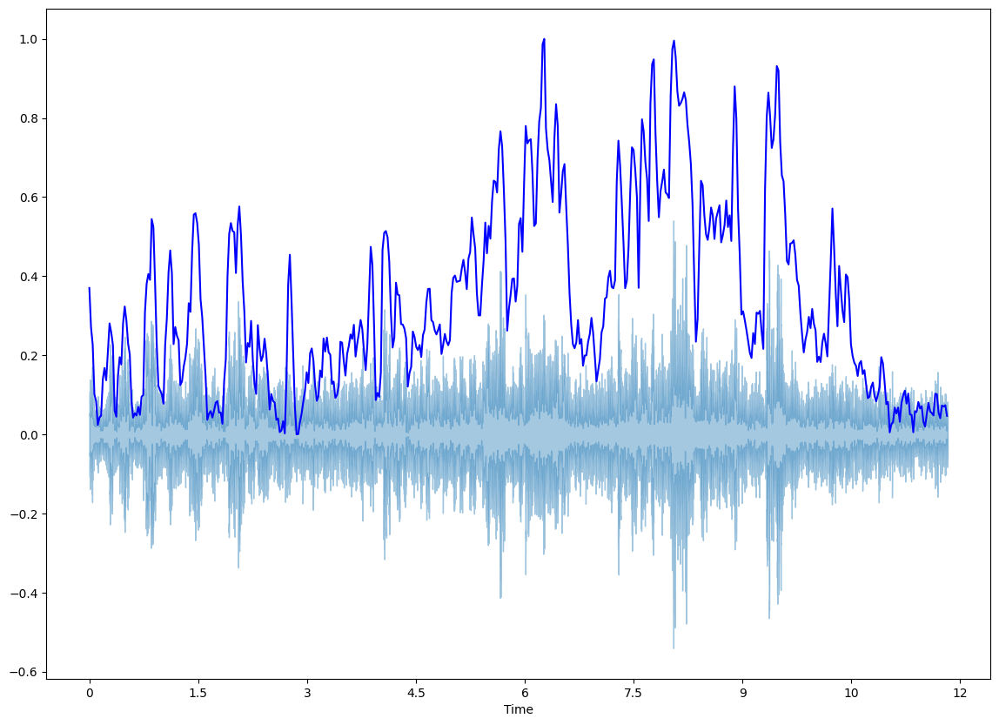

In [184]:
# Spectral Centroid
import sklearn
from sklearn import preprocessing
#https://zhuanlan.zhihu.com/p/144922679
#labelEncoder= preprocessing.LabelEncoder()

spectral_centroids = librosa.feature.spectral_centroid(y=x, sr=sr)[0]
spectral_centroids.shape
plt.figure(figsize=(14, 10))
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='b')

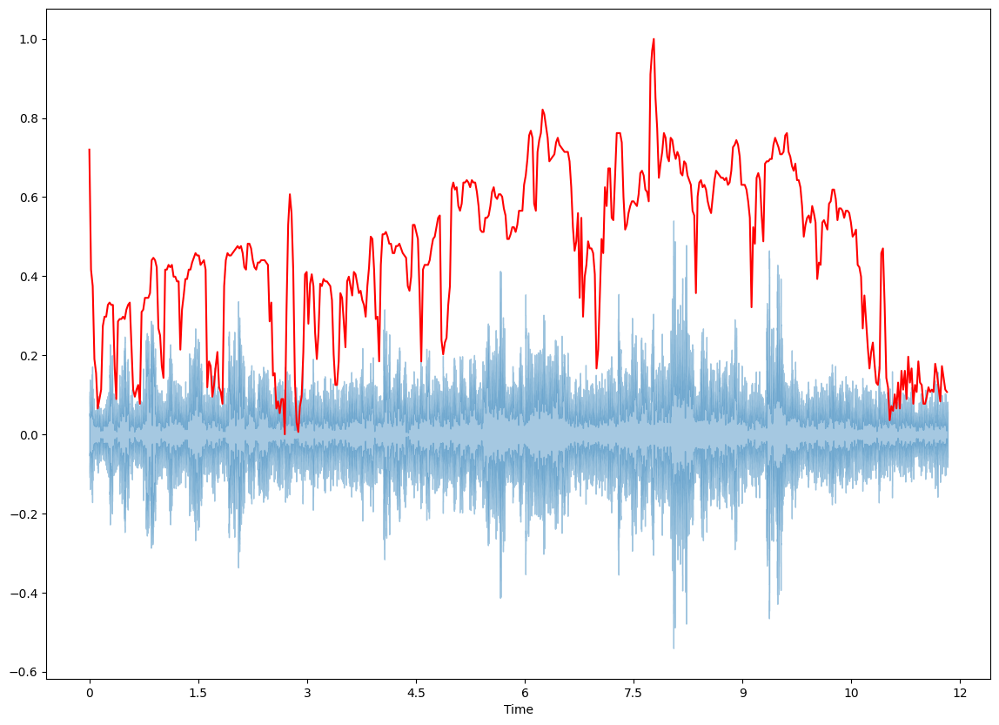

In [185]:
# Spectral Rolloff
spectral_rolloff = librosa.feature.spectral_rolloff(y=x+0.01, sr=sr)[0]
plt.figure(figsize=(14, 10))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='r')

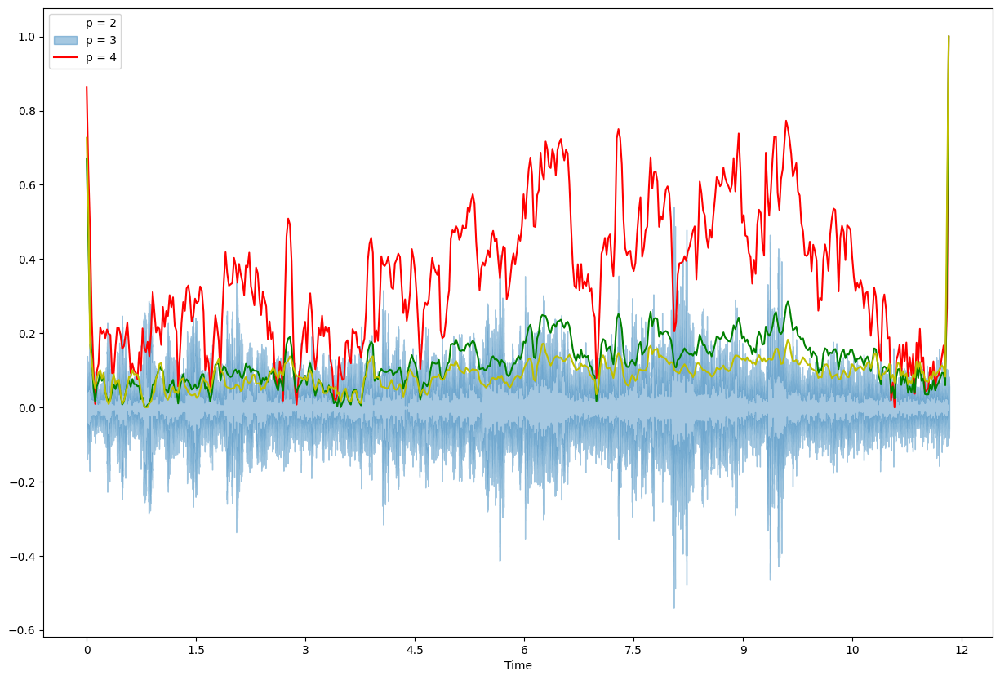

In [186]:
# Spectral Bandwidth
spectral_bandwidth_2 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr)[0]
spectral_bandwidth_3 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=3)[0]
spectral_bandwidth_4 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=4)[0]
plt.figure(figsize=(15, 10))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_bandwidth_2), color='r')
plt.plot(t, normalize(spectral_bandwidth_3), color='g')
plt.plot(t, normalize(spectral_bandwidth_4), color='y')
plt.legend(('p = 2', 'p = 3', 'p = 4'))

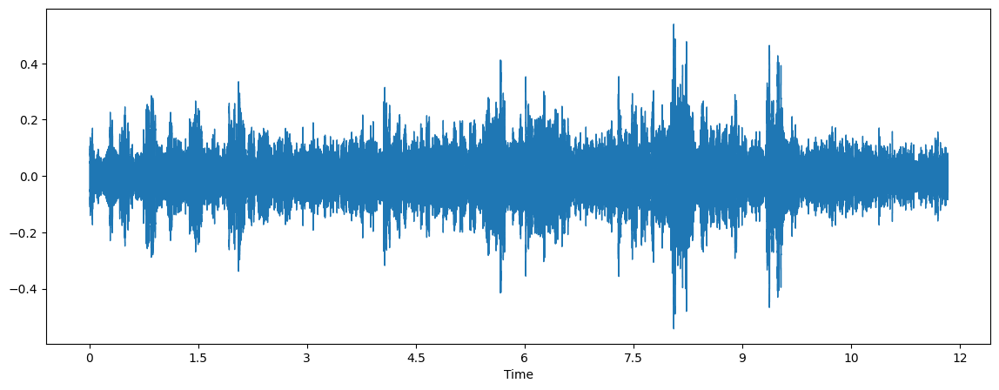

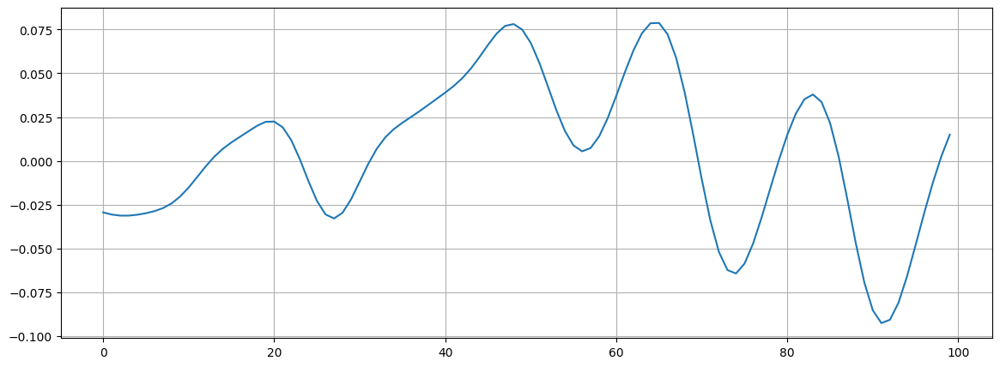

In [187]:
# Zero-Crossing Rate
x, sr = librosa.load(audio_data)
#Plot the signal:
plt.figure(figsize=(14, 5))
librosa.display.waveshow(x, sr=sr)
# Zooming in
n0 = 9000
n1 = 9100
plt.figure(figsize=(14, 5))
plt.plot(x[n0:n1])
plt.grid()

In [188]:
zero_crossings = librosa.zero_crossings(x[n0:n1], pad=False)
print(sum(zero_crossings))

7


(20, 510)


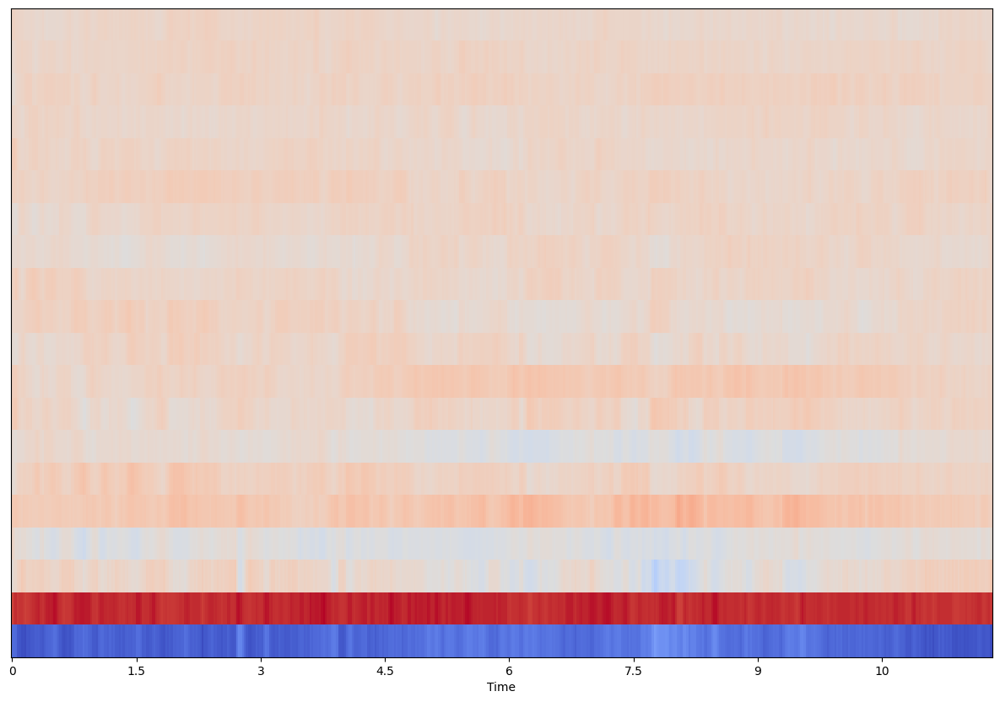

In [189]:
mfccs = librosa.feature.mfcc(y=x, sr=sr)
print(mfccs.shape)
plt.figure(figsize=(15, 10))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

In [190]:
librosa.load(audio_data, sr=44100)

(array([-0.00393779, -0.00216301,  0.00120264, ...,  0.0060122 ,
         0.00361361,  0.00150867], dtype=float32),
 44100)

In [191]:
ipd.Audio(audio_data)

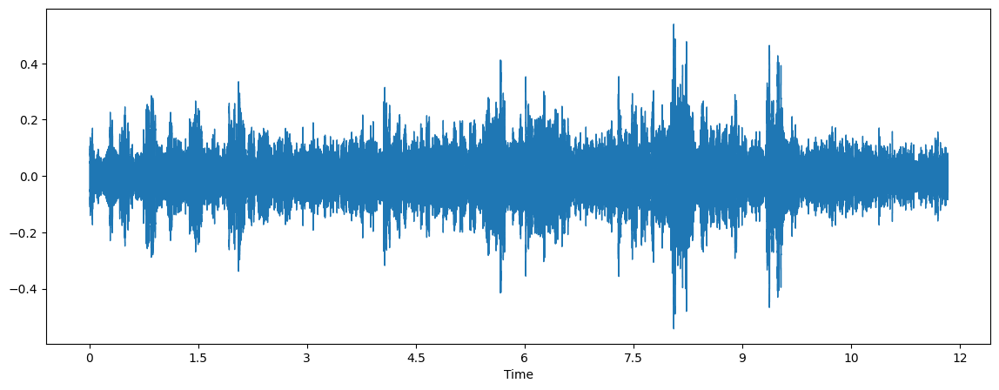

In [192]:
%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display
plt.figure(figsize=(14, 5))
librosa.display.waveshow(x, sr=sr)

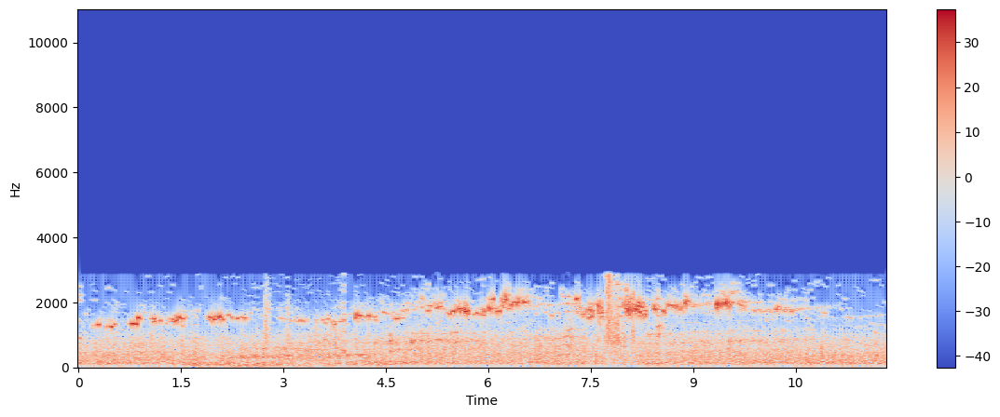

In [193]:
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()

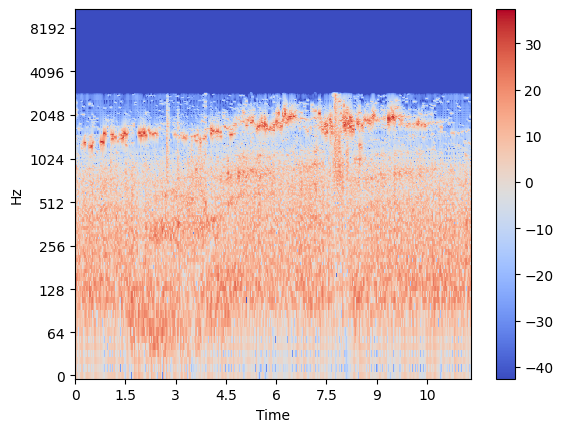

In [194]:
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()

In [195]:
import sklearn
spectral_centroids = librosa.feature.spectral_centroid(y=x, sr=sr)[0]
spectral_centroids.shape
# # Computing the time variable for visualization
# plt.figure(figsize=(12, 4))frames = range(len(spectral_centroids))
# t = librosa.frames_to_time(frames)
# # Normalising the spectral centroid for visualisation
# def normalize(x, axis=0):
#     return sklearn.preprocessing.minmax_scale(x, axis=axis)
# #Plotting the Spectral Centroid along the waveform
# librosa.display.waveplot(x, sr=sr, alpha=0.4)
# plt.plot(t, normalize(spectral_centroids), color='b')

(510,)

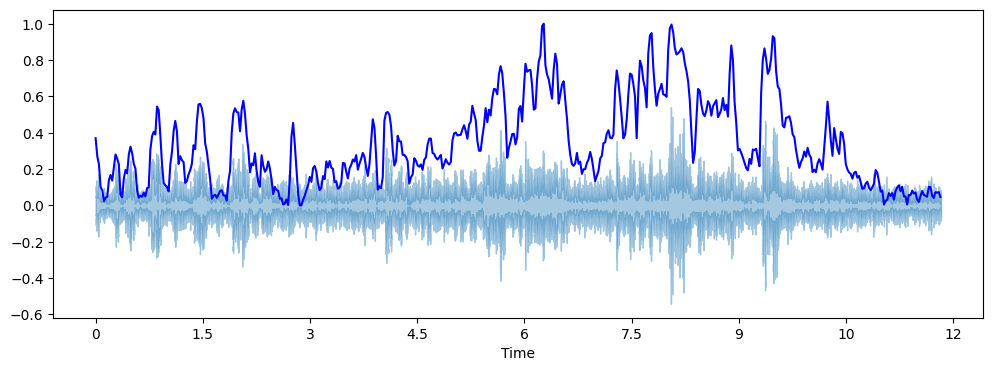

In [196]:
plt.figure(figsize=(12, 4))
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='b')

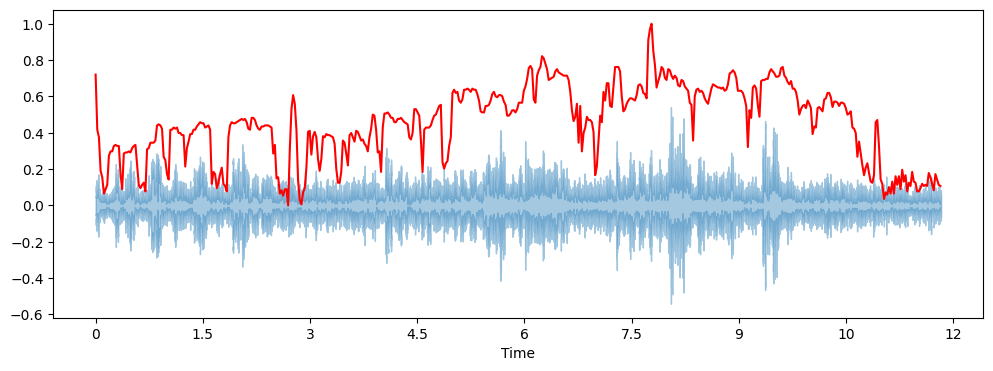

In [197]:
spectral_rolloff = librosa.feature.spectral_rolloff(y=x+0.01, sr=sr)[0]
plt.figure(figsize=(12, 4))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='r')

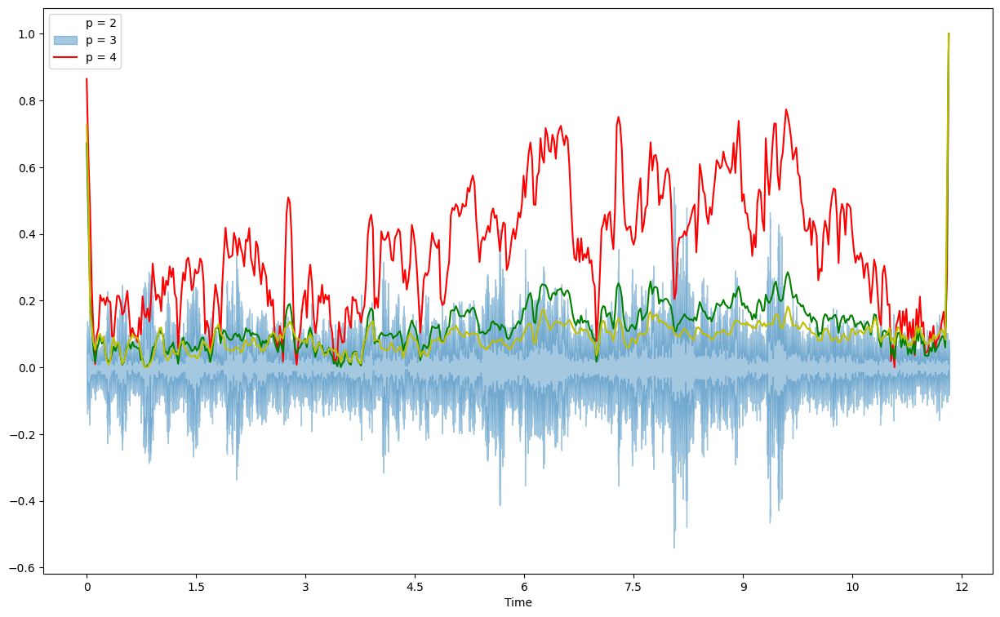

In [198]:
spectral_bandwidth_2 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr)[0]
spectral_bandwidth_3 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=3)[0]
spectral_bandwidth_4 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=4)[0]
plt.figure(figsize=(15, 9))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_bandwidth_2), color='r')
plt.plot(t, normalize(spectral_bandwidth_3), color='g')
plt.plot(t, normalize(spectral_bandwidth_4), color='y')
plt.legend(('p = 2', 'p = 3', 'p = 4'))

In [199]:
mfccs = librosa.feature.mfcc(y=x, sr=sr)
print(mfccs.shape)


(20, 510)


In [200]:
mfccs

array([[-3.1639075e+02, -3.1850870e+02, -3.2111038e+02, ...,
        -3.4605145e+02, -3.4581390e+02, -3.6543951e+02],
       [ 2.3168088e+02,  2.5576953e+02,  2.6087823e+02, ...,
         2.5545044e+02,  2.5967148e+02,  2.4948849e+02],
       [-2.6037407e+01, -1.0992560e+01, -9.9534521e+00, ...,
         1.1209778e+01,  1.7522583e+01,  3.2058769e+01],
       ...,
       [-2.1686966e+01, -2.2709105e+01, -1.0427998e+01, ...,
         1.8226733e+00,  2.5473791e-01, -1.3080887e+00],
       [-1.2636904e+01, -1.0076096e+01, -4.0907421e+00, ...,
        -6.2259951e+00, -9.9953747e+00, -1.4743214e+01],
       [ 4.4997034e+00,  5.6616154e+00, -7.7035105e-01, ...,
        -1.0567598e+01, -1.0403496e+01, -7.3807125e+00]], dtype=float32)

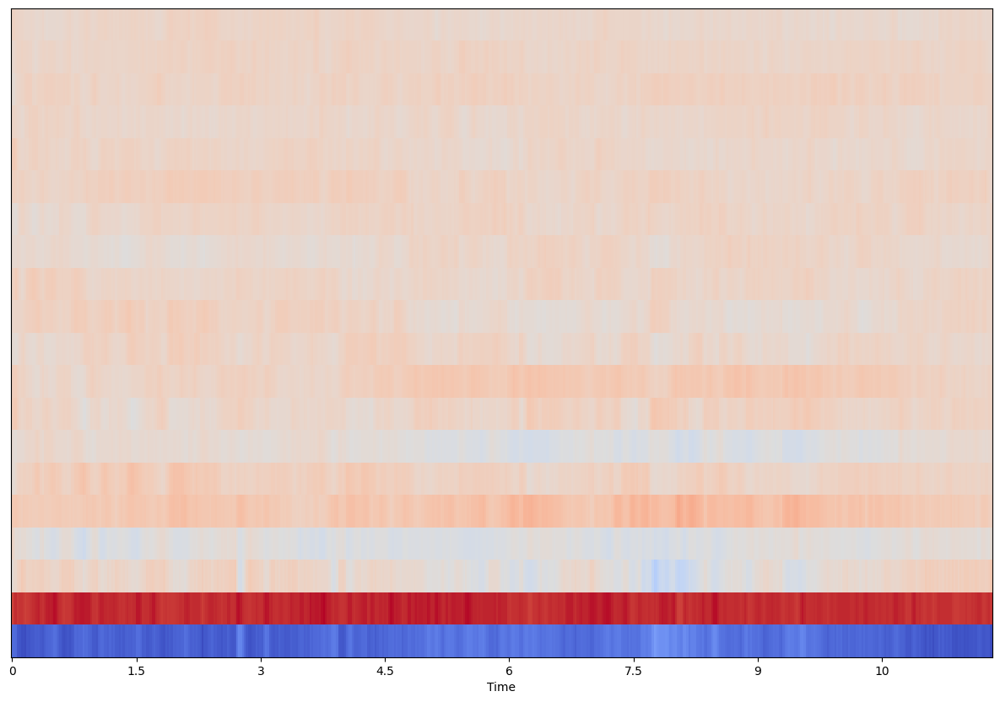

In [201]:
#Displaying  the MFCCs:
plt.figure(figsize=(15, 10))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

### Step 2: Compute Mel-Scaled Spectrogram
The Mel scale is a perceptual scale of pitches judged by listeners to be equal in distance from one another. The reference point between this scale and normal frequency measurement is defined by assigning a perceptual pitch of 1000 mels to a 1000 Hz tone, 40 dB above the listener's threshold.

This scale is used in speech and music processing, particularly for voice recognition, because it approximates human hearing much more closely than the linear frequency scale.

Now, we will compute a Mel-scaled spectrogram for the same audio file.

This process involves converting the conventional frequency scale into the Mel scale, which correlates better with human auditory perception.

In [202]:
y, sr = librosa.load(audio_data)
librosa.feature.melspectrogram(y=y, sr=sr)

array([[3.95852923e-02, 1.10066697e-01, 4.21354353e-01, ...,
        5.27004711e-02, 6.57515526e-02, 1.06540821e-01],
       [2.43720949e-01, 3.33501637e-01, 8.34967971e-01, ...,
        1.23108491e-01, 2.31139362e-01, 3.51933688e-01],
       [6.64399445e-01, 1.48397791e+00, 8.78724694e-01, ...,
        3.74876946e-01, 1.05329776e+00, 1.09519506e+00],
       ...,
       [5.66498443e-07, 1.41066337e-07, 2.62492652e-15, ...,
        3.16302368e-15, 1.08213427e-09, 3.05010026e-08],
       [5.58404508e-07, 1.39053483e-07, 9.93769801e-15, ...,
        1.27206536e-14, 1.06009790e-09, 2.98794802e-08],
       [5.53210100e-07, 1.37762413e-07, 4.06776646e-15, ...,
        4.02828329e-15, 1.04605480e-09, 2.94838109e-08]], dtype=float32)

In [203]:
S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128,
                                    fmax=8000)

[Text(0.5, 1.0, 'Mel-frequency spectrogram')]

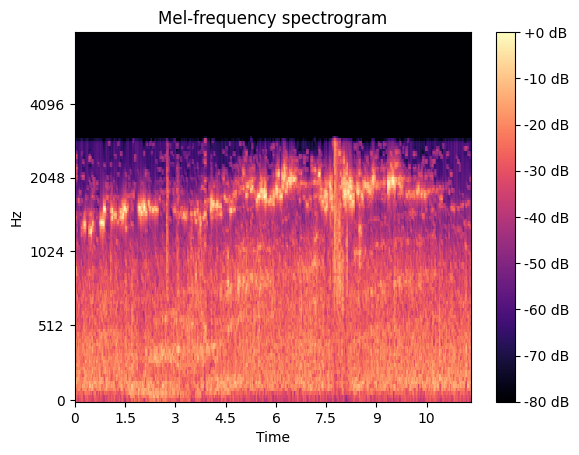

In [204]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
S_dB = librosa.power_to_db(S, ref=np.max)
img = librosa.display.specshow(S_dB, x_axis='time',
                         y_axis='mel', sr=sr,
                         fmax=8000, ax=ax)
fig.colorbar(img, ax=ax, format='%+2.0f dB')
ax.set(title='Mel-frequency spectrogram')

### Step 3: Short-Time Fourier Transform (STFT)

The Short-Time Fourier Transform (STFT) analyzes the frequency content of a signal over time by applying the Fourier Transform to overlapping short segments or windows of the signal. This produces a time-frequency representation called a spectrogram. The window length determines a trade-off: longer windows provide better frequency resolution but worse time resolution, and vice versa. Commonly used in audio and speech processing, the STFT reveals how the signal's frequency components evolve over time.


In [205]:
y, sr = librosa.load(audio_data)
S = np.abs(librosa.stft(y))
S

array([[2.9153874e-02, 9.4478714e-01, 1.8554453e+00, ..., 6.0516071e-01,
        5.7281518e-01, 9.4542527e-01],
       [2.2906379e-01, 7.4469656e-01, 1.8799356e+00, ..., 2.0990178e-01,
        4.5090801e-01, 6.1944139e-01],
       [4.9343640e-01, 1.1113710e+00, 2.0394847e+00, ..., 8.2539433e-01,
        8.4654456e-01, 1.1238755e+00],
       ...,
       [2.4360137e-03, 1.2156456e-03, 1.4498535e-07, ..., 6.8257108e-08,
        1.0605284e-04, 5.6229695e-04],
       [2.4359911e-03, 1.2154055e-03, 3.1334685e-07, ..., 6.7264210e-08,
        1.0592679e-04, 5.6204735e-04],
       [2.4360477e-03, 1.2158812e-03, 4.0045566e-07, ..., 1.3123264e-07,
        1.0551623e-04, 5.6175381e-04]], dtype=float32)

In [206]:
S_left = librosa.stft(y, center=False)

In [207]:
D_short = librosa.stft(y, hop_length=64)

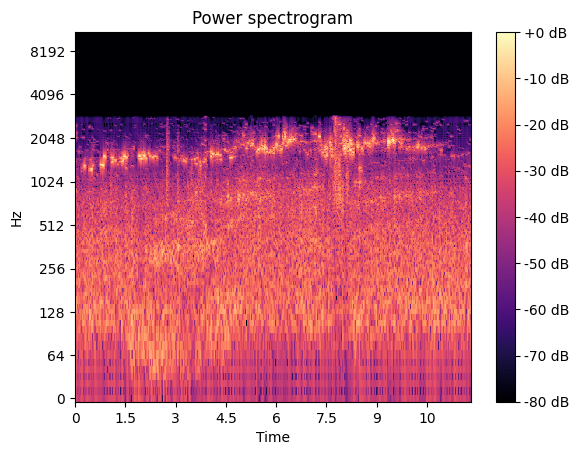

In [208]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
img = librosa.display.specshow(
    librosa.amplitude_to_db(S,ref=np.max),
    y_axis='log',
    x_axis='time',
    ax=ax
    )
ax.set_title('Power spectrogram')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

### Step 4: Beat Tracker

The `librosa` beat tracker detects the rhythmic pulse or "beats" in an audio signal. By analyzing the onset strength of a signal, which corresponds to sudden changes or events in the audio, it determines the timing of beats. Beat tracking is essential for various music analysis tasks, such as tempo estimation, rhythm analysis, and synchronization. In applications like DJ software, automatic music tagging, or dance choreography, the detected beats can be used to align tracks, categorize music, or coordinate movements to the rhythm.


In [209]:
y, sr = librosa.load(audio_data)

In [210]:
tempo, beats = librosa.beat.beat_track(y=y, sr=sr)

In [211]:
tempo

172.265625

In [212]:
beats

array([ 52,  67,  85, 102, 119, 133, 148, 163, 178, 193, 208, 222, 236,
       250, 264, 278, 292, 306, 321, 336, 351])

In [213]:
onset_env = librosa.onset.onset_strength(y=y, sr=sr,
                                         aggregate=np.median)
tempo, beats = librosa.beat.beat_track(onset_envelope=onset_env,
                                       sr=sr)

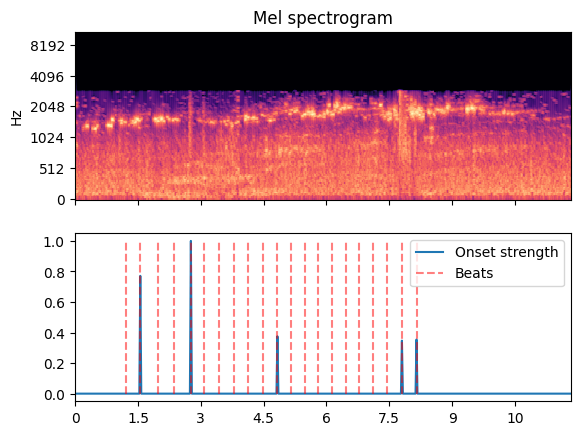

In [214]:
import matplotlib.pyplot as plt
hop_length = 512
fig, ax = plt.subplots(nrows=2, sharex=True)
times = librosa.times_like(onset_env, sr=sr, hop_length=hop_length)
M = librosa.feature.melspectrogram(y=y, sr=sr, hop_length=hop_length)
librosa.display.specshow(librosa.power_to_db(M, ref=np.max),
                         y_axis='mel', x_axis='time', hop_length=hop_length,
                         ax=ax[0])
ax[0].label_outer()
ax[0].set(title='Mel spectrogram')
ax[1].plot(times, librosa.util.normalize(onset_env),
         label='Onset strength')
ax[1].vlines(times[beats], 0, 1, alpha=0.5, color='r',
           linestyle='--', label='Beats')
ax[1].legend()

### Step 5: Compute Constant-Q Transform of Audio Signal

The Constant Q Transform (CQT) in librosa provides a time-frequency representation of an audio signal where the frequency bins are geometrically spaced. Unlike the linear spacing of the Short-Time Fourier Transform (STFT), the CQT's spacing mirrors the logarithmic perception of pitch in human hearing. This makes the CQT especially useful for musical analysis. In the CQT, the "Q-factor" (a ratio of the center frequency to bandwidth) remains constant across all frequencies, ensuring that each frequency bin has consistent resolution. When visualized, harmonics of musical notes align vertically in a CQT spectrogram, making it valuable for studying harmonic structures. In librosa, the cqt function efficiently computes this representation.

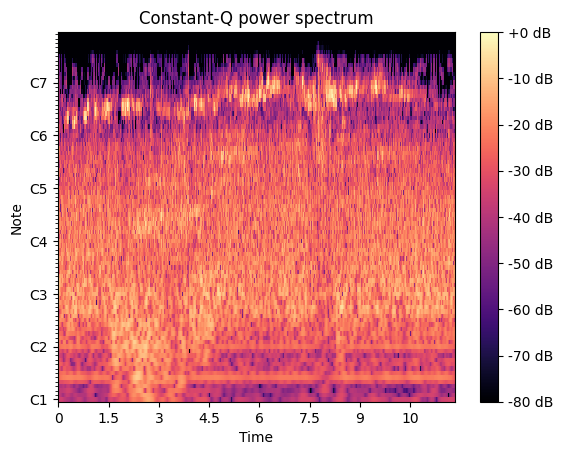

In [215]:
import matplotlib.pyplot as plt
y, sr = librosa.load(audio_data)
C = np.abs(librosa.cqt(y, sr=sr))
fig, ax = plt.subplots()
img = librosa.display.specshow(librosa.amplitude_to_db(C, ref=np.max),
                               sr=sr, x_axis='time', y_axis='cqt_note', ax=ax)
ax.set_title('Constant-Q power spectrum')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

In [216]:
print("The Constant-Q Transform of the Audio Signal is:")
print(C)

The Constant-Q Transform of the Audio Signal is:
[[3.4345429e-02 3.4875486e-02 3.4782082e-02 ... 3.9409541e-02
  3.7645541e-02 3.4832921e-02]
 [2.6916351e-02 2.7194869e-02 2.5782079e-02 ... 2.0448033e-02
  2.1657135e-02 2.1751506e-02]
 [2.1339627e-02 2.3471914e-02 2.4764543e-02 ... 1.0334363e-02
  9.3240393e-03 8.5551217e-03]
 ...
 [2.8516327e-03 1.6949940e-05 2.1788905e-05 ... 9.8683595e-06
  1.5325979e-06 4.7092431e-06]
 [2.5477749e-03 8.2781053e-06 9.6573212e-06 ... 6.6356038e-06
  6.9516460e-07 3.4485945e-06]
 [2.2945434e-03 7.5416201e-06 7.6510805e-06 ... 5.1371885e-06
  1.1794793e-06 2.6832836e-06]]


## Parker


### Setup

In [217]:
current_file = parker_file_path

In [218]:
audio_data = current_file
x , sr = librosa.load(audio_data)
print(type(x), type(sr))
print(x.shape, sr)

<class 'numpy.ndarray'> <class 'int'>
(308700,) 22050


In [219]:
librosa.load(audio_data, sr=44100)

(array([-0.0015847 , -0.00704776, -0.01335788, ...,  0.00042864,
         0.00049548,  0.0003892 ], dtype=float32),
 44100)

In [220]:
import IPython.display as ipd
ipd.Audio(audio_data)

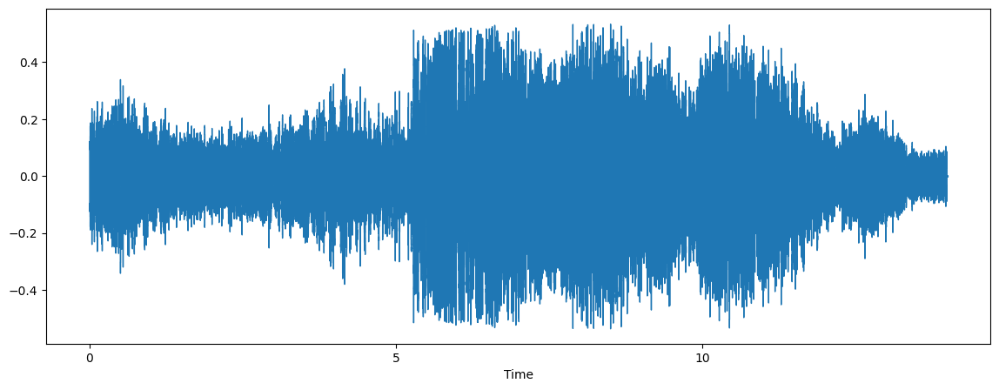

In [221]:
%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display
plt.figure(figsize=(14, 5))
librosa.display.waveshow(x, sr=sr)

In [222]:
# Build a simple chroma filter bank
chromafb = librosa.filters.chroma(sr=22050, n_fft=4096)

chromafb

array([[1.70601543e-05, 2.82992725e-04, 1.03555294e-03, ...,
        5.23030704e-21, 4.43047226e-21, 3.75236833e-21],
       [1.66987356e-05, 3.18591396e-04, 1.46405352e-03, ...,
        1.25662976e-13, 1.10109757e-13, 9.64649842e-14],
       [1.61444223e-05, 3.48842266e-04, 1.90847355e-03, ...,
        5.52980168e-08, 5.01214537e-08, 4.54209257e-08],
       ...,
       [1.68931711e-05, 3.02419503e-04, 1.25730084e-03, ...,
        4.03871397e-17, 4.63902409e-17, 5.32694454e-17],
       [1.71591892e-05, 2.65152019e-04, 8.56101280e-04, ...,
        2.25072222e-25, 2.67424414e-25, 3.17644285e-25],
       [1.72155414e-05, 2.44485302e-04, 6.75355259e-04, ...,
        3.98721026e-30, 3.26509862e-30, 2.67339596e-30]], dtype=float32)

In [223]:
# Use quarter-tones instead of semitones
librosa.filters.chroma(sr=22050, n_fft=4096, n_chroma=24)

array([[1.2062923e-05, 2.0009540e-04, 7.3222251e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.1952894e-05, 2.1304651e-04, 8.7951310e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.1807369e-05, 2.2526611e-04, 1.0352081e-03, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       ...,
       [1.2171624e-05, 1.7373025e-04, 4.8452709e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.2172794e-05, 1.7286799e-04, 4.7753262e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.2136448e-05, 1.8663100e-04, 5.9735152e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00]], dtype=float32)

In [224]:
# Equally weight all octaves
librosa.filters.chroma(sr=22050, n_fft=4096, octwidth=None)

array([[3.06632757e-01, 2.43654341e-01, 1.60742402e-01, ...,
        2.75466492e-20, 2.33491276e-20, 1.97881458e-20],
       [3.00136745e-01, 2.74304509e-01, 2.27255851e-01, ...,
        6.61833761e-13, 5.80291837e-13, 5.08708906e-13],
       [2.90173739e-01, 3.00350249e-01, 2.96240419e-01, ...,
        2.91240070e-07, 2.64146166e-07, 2.39527623e-07],
       ...,
       [3.03631455e-01, 2.60380656e-01, 1.95162937e-01, ...,
        2.12708409e-16, 2.44482217e-16, 2.80916862e-16],
       [3.08412760e-01, 2.28293657e-01, 1.32887244e-01, ...,
        1.18539604e-24, 1.40935927e-24, 1.67509979e-24],
       [3.09425622e-01, 2.10499778e-01, 1.04831174e-01, ...,
        2.09995848e-29, 1.72074678e-29, 1.40981758e-29]], dtype=float32)

### Step 1: Display Spectrogram, Chromogram, and CQT

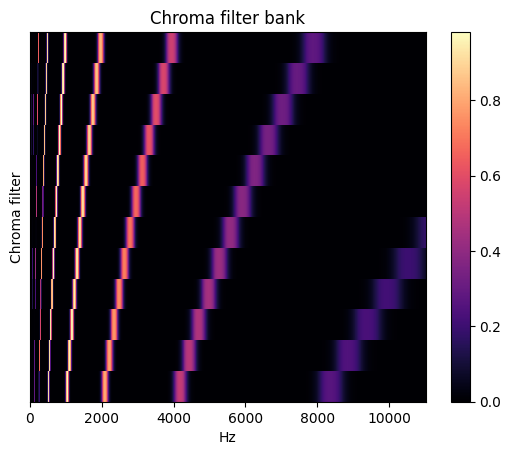

In [225]:
#https://librosa.org/doc-playground/main/generated/librosa.filters.chroma.html?highlight=chroma#librosa.filters.chroma
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
img = librosa.display.specshow(chromafb, x_axis='linear', ax=ax)
ax.set(ylabel='Chroma filter', title='Chroma filter bank')
fig.colorbar(img, ax=ax)


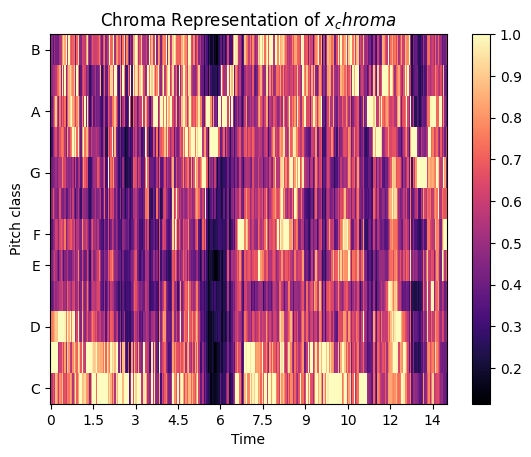

In [226]:
#https://librosa.org/doc-playground/main/auto_examples/plot_music_sync.html?highlight=chroma

# Extract Chroma Features

hop_length = 1024

x_chroma = librosa.feature.chroma_cqt(y=x, sr=sr,
                                         hop_length=hop_length)

fig, ax = plt.subplots(nrows=1, sharey=True)
img = librosa.display.specshow(x_chroma, x_axis='time',
                               y_axis='chroma',
                               hop_length=hop_length, ax=ax)
ax.set(title='Chroma Representation of $x_chroma$')
fig.colorbar(img, ax=ax)

In [227]:
#https://librosa.org/doc-playground/main/generated/librosa.feature.chroma_stft.html?highlight=ibrosa%20feature%20chroma_stft#librosa.feature.chroma_stft
#Energy
librosa.feature.chroma_stft(y=x, sr=sr)

array([[0.32244918, 0.37615985, 0.40432605, ..., 0.09147009, 0.09739957,
        0.06802355],
       [1.        , 1.        , 1.        , ..., 0.09466669, 0.08779548,
        0.06431664],
       [0.5324339 , 0.55343306, 0.71757054, ..., 0.08532543, 0.10556449,
        0.09700584],
       ...,
       [0.04557947, 0.04863139, 0.08774488, ..., 0.23884958, 0.34467188,
        0.3311523 ],
       [0.08080078, 0.14507906, 0.17270449, ..., 0.14231361, 0.18650609,
        0.17921157],
       [0.07319956, 0.18939821, 0.25593477, ..., 0.15292153, 0.25682655,
        0.20745596]], dtype=float32)

In [228]:
# Use an energy (magnitude) spectrum instead of power spectrogram
S = np.abs(librosa.stft(x))
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
chroma

array([[1.        , 0.97099286, 0.8474191 , ..., 0.57768553, 0.49889976,
        0.42030367],
       [0.99702716, 1.        , 1.        , ..., 0.5700448 , 0.55502576,
        0.48131084],
       [0.4600556 , 0.65818655, 0.64376426, ..., 0.53417   , 0.58668536,
        0.5767618 ],
       ...,
       [0.44038194, 0.45780727, 0.436151  , ..., 0.61441404, 0.6991277 ,
        0.7072669 ],
       [0.42083976, 0.6341014 , 0.54147416, ..., 0.6357081 , 0.7389257 ,
        0.68809533],
       [0.5022604 , 0.6647535 , 0.6344194 , ..., 0.54533654, 0.57766825,
        0.49864095]], dtype=float32)

In [229]:
# Use an energy (magnitude) spectrum instead of power spectrogram
S = np.abs(librosa.stft(x))
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
chroma

array([[1.        , 0.97099286, 0.8474191 , ..., 0.57768553, 0.49889976,
        0.42030367],
       [0.99702716, 1.        , 1.        , ..., 0.5700448 , 0.55502576,
        0.48131084],
       [0.4600556 , 0.65818655, 0.64376426, ..., 0.53417   , 0.58668536,
        0.5767618 ],
       ...,
       [0.44038194, 0.45780727, 0.436151  , ..., 0.61441404, 0.6991277 ,
        0.7072669 ],
       [0.42083976, 0.6341014 , 0.54147416, ..., 0.6357081 , 0.7389257 ,
        0.68809533],
       [0.5022604 , 0.6647535 , 0.6344194 , ..., 0.54533654, 0.57766825,
        0.49864095]], dtype=float32)

In [230]:
# Use a pre-computed power spectrogram with a larger frame
S = np.abs(librosa.stft(x, n_fft=4096))**2
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
chroma

array([[0.3225757 , 0.3439886 , 0.32663518, ..., 0.11605576, 0.09563019,
        0.07792281],
       [1.        , 1.        , 0.8831796 , ..., 0.11463697, 0.09300474,
        0.07551035],
       [0.54755694, 0.7674315 , 1.        , ..., 0.10699687, 0.09440514,
        0.10290454],
       ...,
       [0.04666682, 0.07155176, 0.20856269, ..., 0.49699193, 0.33350688,
        0.34401292],
       [0.11763694, 0.15161118, 0.2015659 , ..., 1.        , 0.2939068 ,
        0.1763871 ],
       [0.1351394 , 0.19564213, 0.23107795, ..., 0.38635293, 0.2250839 ,
        0.23087306]], dtype=float32)

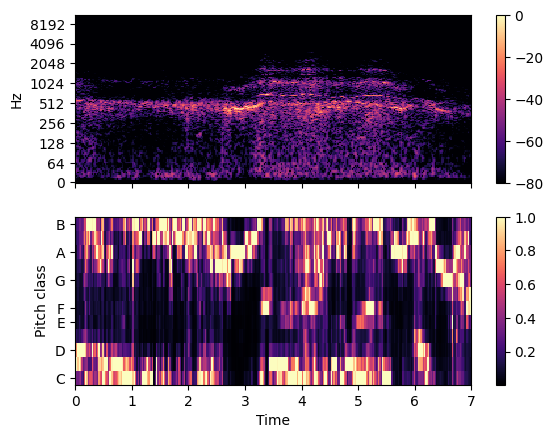

In [231]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(nrows=2, sharex=True)
img = librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),
                               y_axis='log', x_axis='time', ax=ax[0])
fig.colorbar(img, ax=[ax[0]])
ax[0].label_outer()
img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax[1])
fig.colorbar(img, ax=[ax[1]])

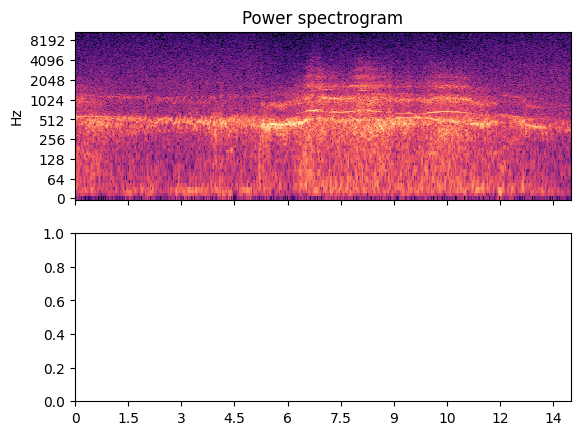

In [232]:
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()

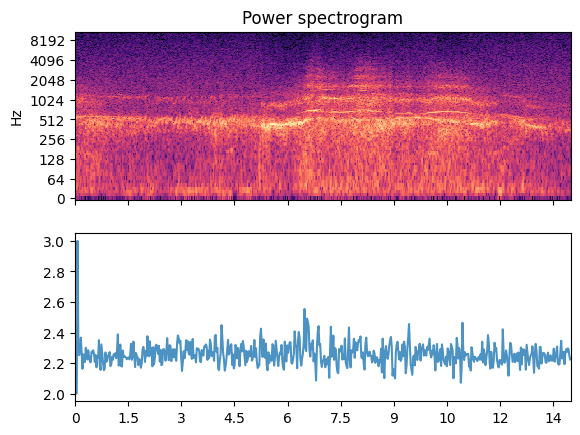

In [233]:
# Construct a standard onset function
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()
onset_env = librosa.onset.onset_strength(y=x, sr=sr)
ax[1].plot(times, 2 + onset_env / onset_env.max(), alpha=0.8,
           label='Mean (mel)')

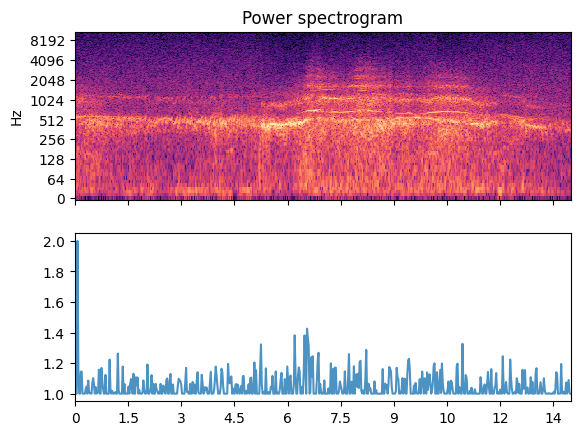

In [234]:
# Median aggregation, and custom mel options
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()

onset_env = librosa.onset.onset_strength(y=x, sr=sr,
                                         aggregate=np.median,
                                         fmax=8000, n_mels=256)
ax[1].plot(times, 1 + onset_env / onset_env.max(), alpha=0.8,
           label='Median (custom mel)')


[Text(0, 0.5, 'Normalized strength'), []]

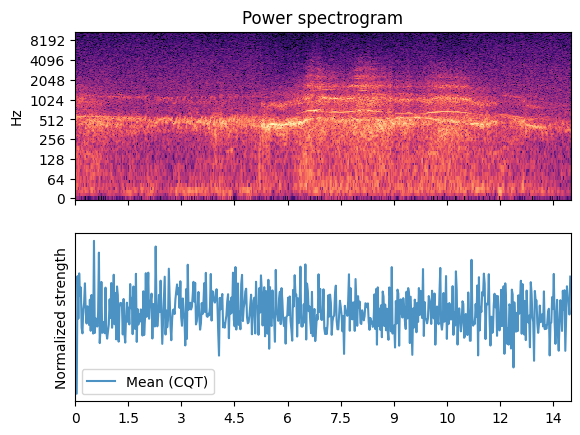

In [235]:
# Constant-Q spectrogram instead of Mel
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()


C = np.abs(librosa.cqt(y=x, sr=sr))
onset_env = librosa.onset.onset_strength(sr=sr, S=librosa.amplitude_to_db(C, ref=np.max))
ax[1].plot(times, onset_env / onset_env.max(), alpha=0.8,
         label='Mean (CQT)')
ax[1].legend()
ax[1].set(ylabel='Normalized strength', yticks=[])


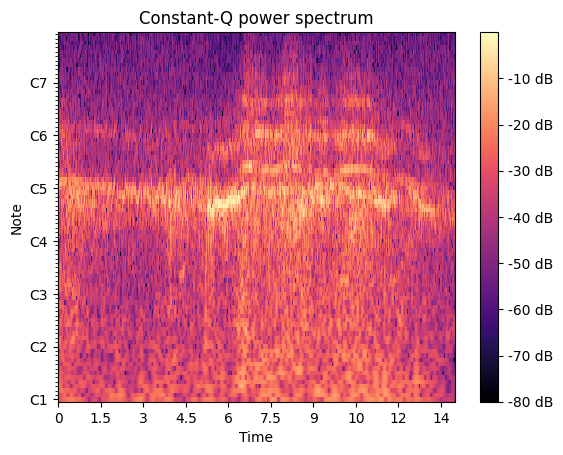

In [236]:
C = np.abs(librosa.cqt(x, sr=sr))
fig, ax = plt.subplots()
img = librosa.display.specshow(librosa.amplitude_to_db(C, ref=np.max),
                               sr=sr, x_axis='time', y_axis='cqt_note', ax=ax)
ax.set_title('Constant-Q power spectrum')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

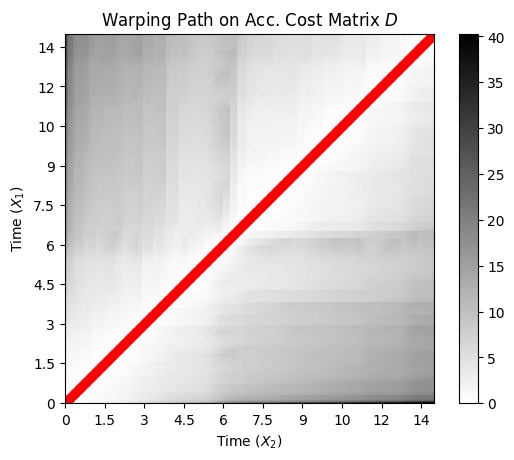

In [237]:
D, wp = librosa.sequence.dtw(X=x_chroma,Y=x_chroma, metric='cosine')
wp_s = librosa.frames_to_time(wp, sr=sr, hop_length=hop_length)

fig, ax = plt.subplots()
img = librosa.display.specshow(D, x_axis='time', y_axis='time', sr=sr,
                               cmap='gray_r', hop_length=hop_length, ax=ax)
ax.plot(wp_s[:, 1], wp_s[:, 0], marker='o', color='r')
ax.set(title='Warping Path on Acc. Cost Matrix $D$',
       xlabel='Time $(X_2)$', ylabel='Time $(X_1)$')
fig.colorbar(img, ax=ax)


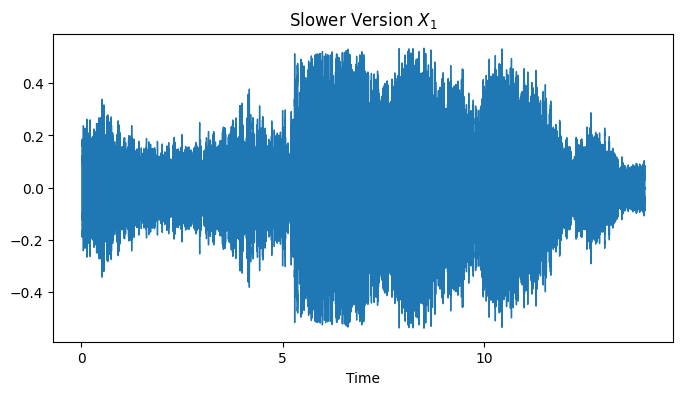

In [238]:
#Alternative Visualization in the Time Domain
fig, ax1 = plt.subplots(nrows=1, sharex=True, sharey=True, figsize=(8, 4))

# Plot x_1
librosa.display.waveshow(x, sr=sr, ax=ax1)
ax1.set(title='Slower Version $X_1$')
ax1.label_outer()


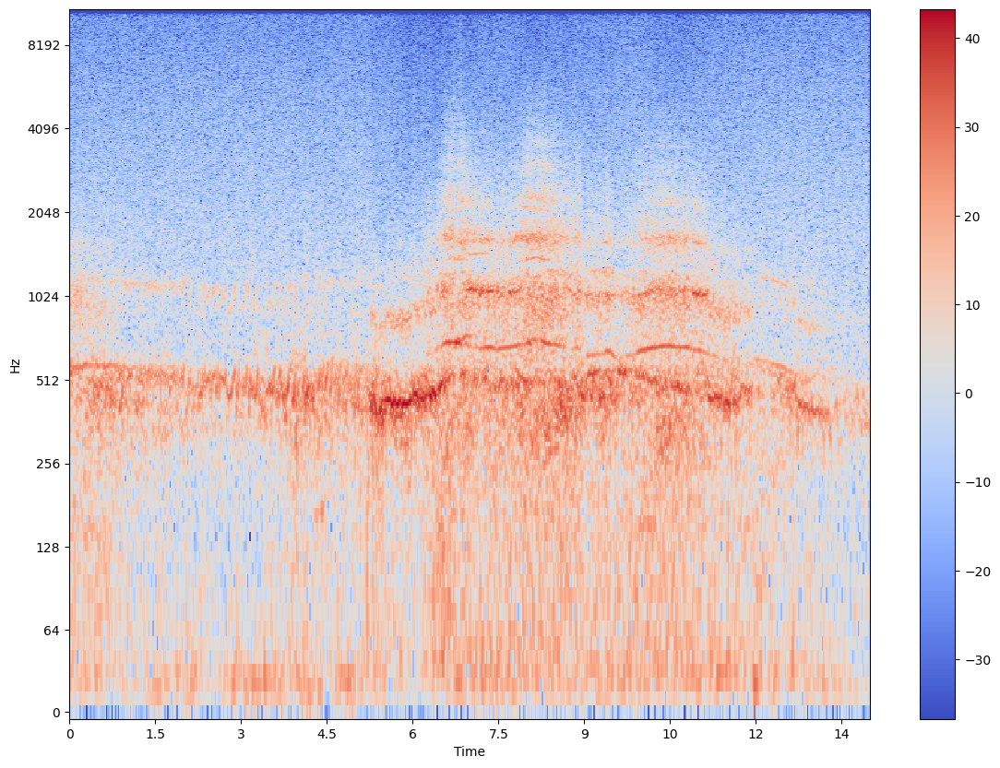

In [239]:
# Spectrogram
import matplotlib.pyplot as plt
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 10))

librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()

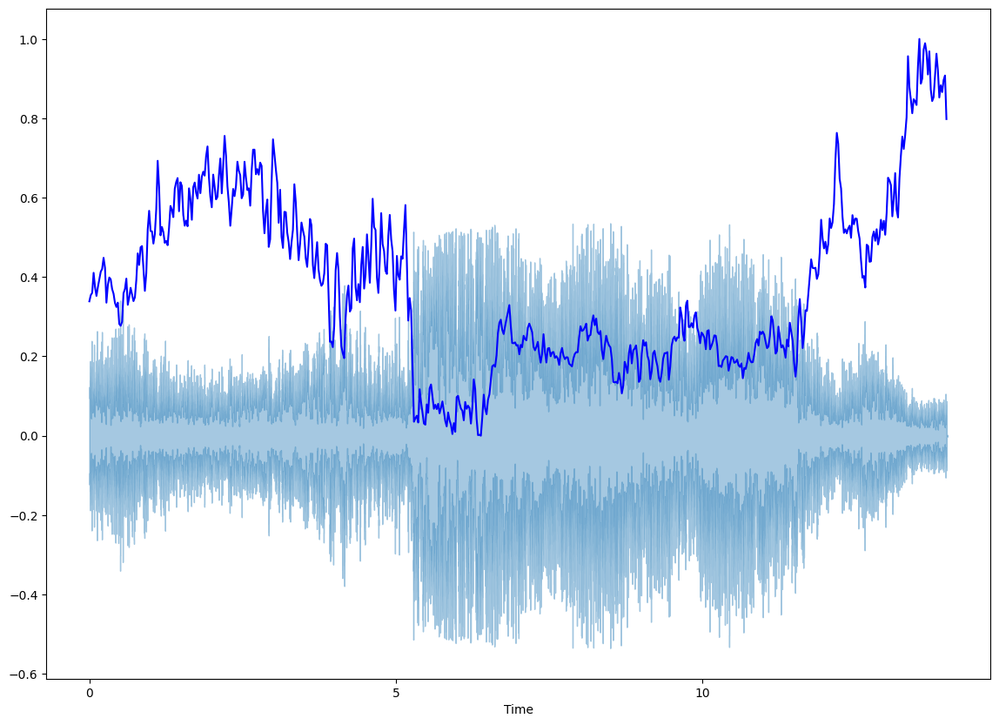

In [240]:
# Spectral Centroid
import sklearn
from sklearn import preprocessing
#https://zhuanlan.zhihu.com/p/144922679
#labelEncoder= preprocessing.LabelEncoder()

spectral_centroids = librosa.feature.spectral_centroid(y=x, sr=sr)[0]
spectral_centroids.shape
plt.figure(figsize=(14, 10))
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='b')

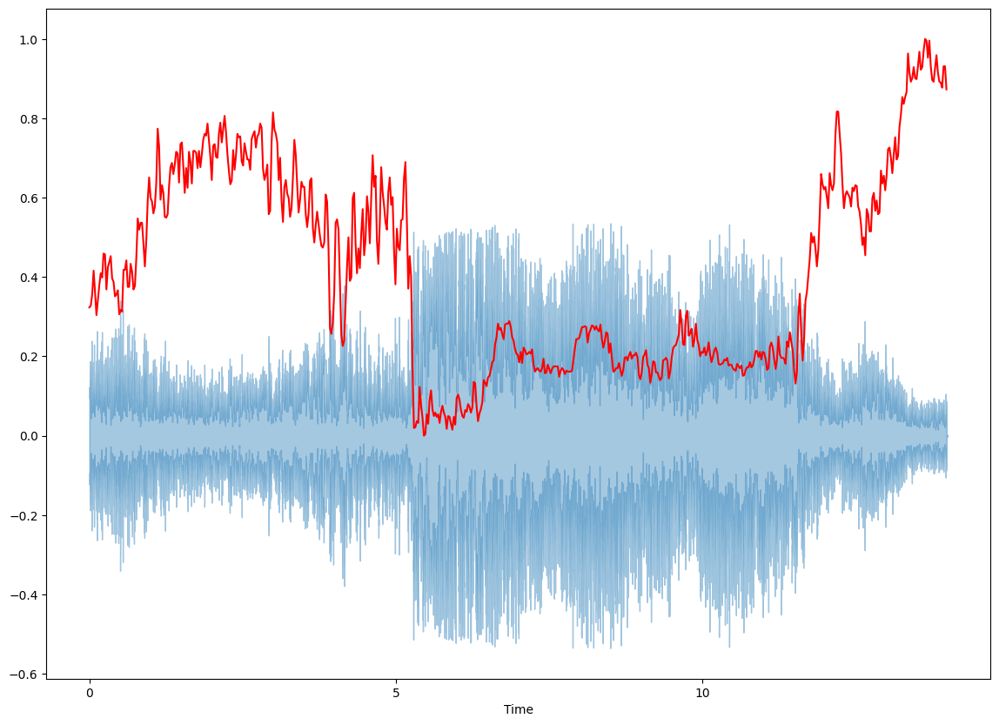

In [241]:
# Spectral Rolloff
spectral_rolloff = librosa.feature.spectral_rolloff(y=x+0.01, sr=sr)[0]
plt.figure(figsize=(14, 10))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='r')

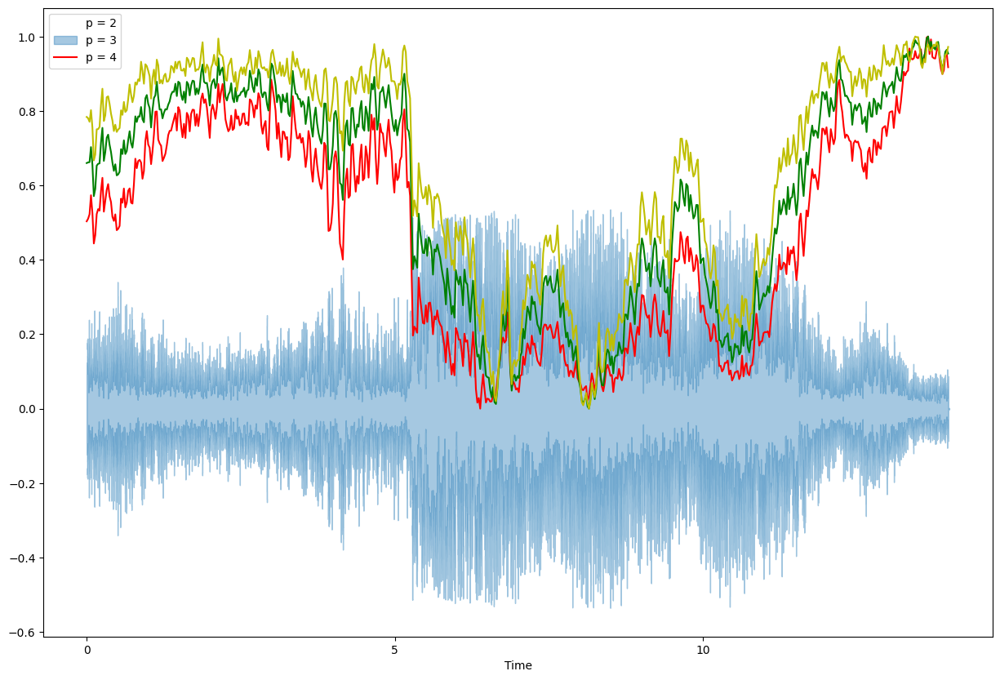

In [242]:
# Spectral Bandwidth
spectral_bandwidth_2 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr)[0]
spectral_bandwidth_3 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=3)[0]
spectral_bandwidth_4 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=4)[0]
plt.figure(figsize=(15, 10))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_bandwidth_2), color='r')
plt.plot(t, normalize(spectral_bandwidth_3), color='g')
plt.plot(t, normalize(spectral_bandwidth_4), color='y')
plt.legend(('p = 2', 'p = 3', 'p = 4'))

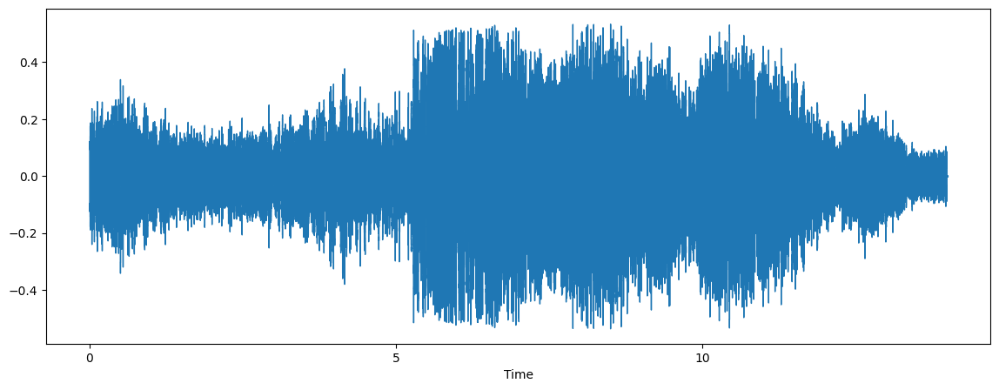

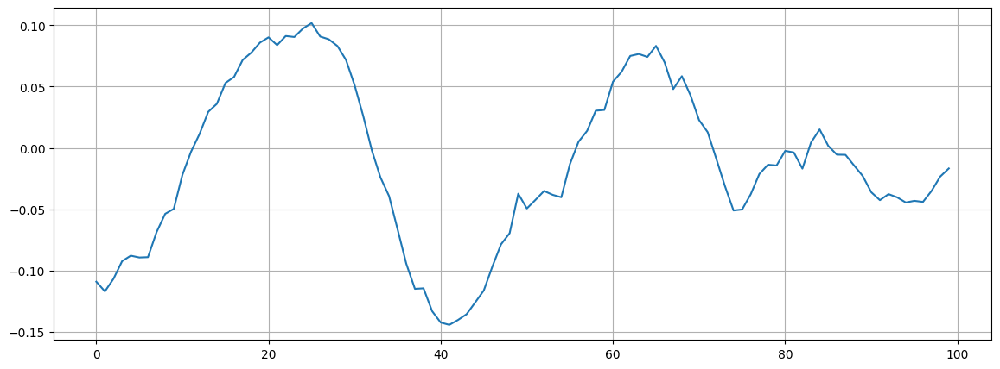

In [243]:
# Zero-Crossing Rate
x, sr = librosa.load(audio_data)
#Plot the signal:
plt.figure(figsize=(14, 5))
librosa.display.waveshow(x, sr=sr)
# Zooming in
n0 = 9000
n1 = 9100
plt.figure(figsize=(14, 5))
plt.plot(x[n0:n1])
plt.grid()

In [244]:
zero_crossings = librosa.zero_crossings(x[n0:n1], pad=False)
print(sum(zero_crossings))

6


(20, 603)


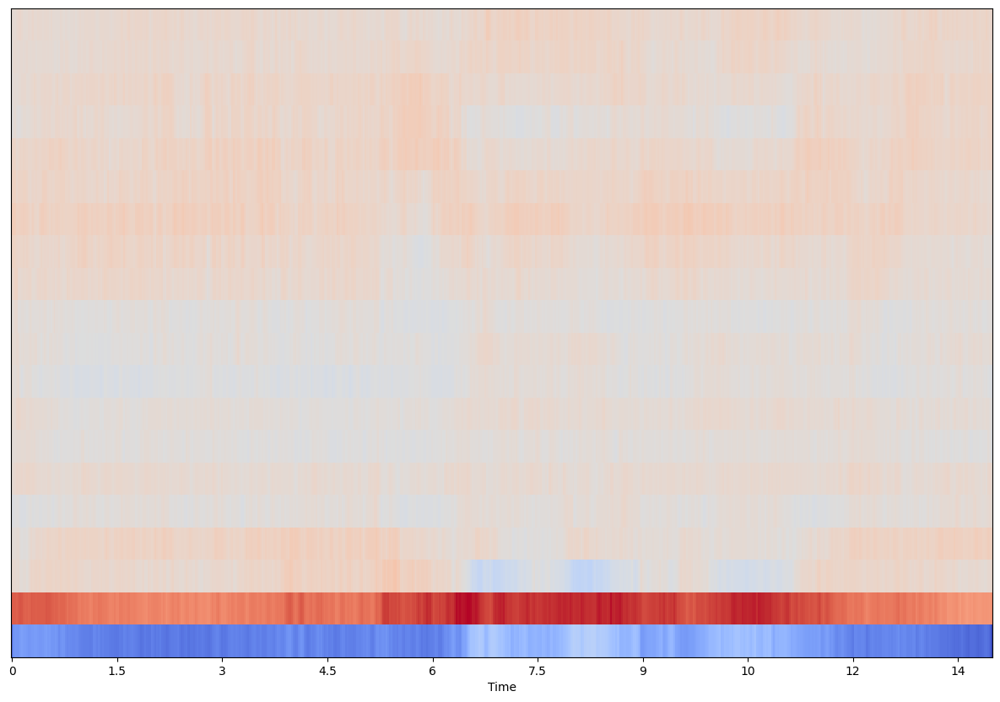

In [245]:
mfccs = librosa.feature.mfcc(y=x, sr=sr)
print(mfccs.shape)
plt.figure(figsize=(15, 10))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

In [246]:
librosa.load(audio_data, sr=44100)

(array([-0.0015847 , -0.00704776, -0.01335788, ...,  0.00042864,
         0.00049548,  0.0003892 ], dtype=float32),
 44100)

In [247]:
ipd.Audio(audio_data)

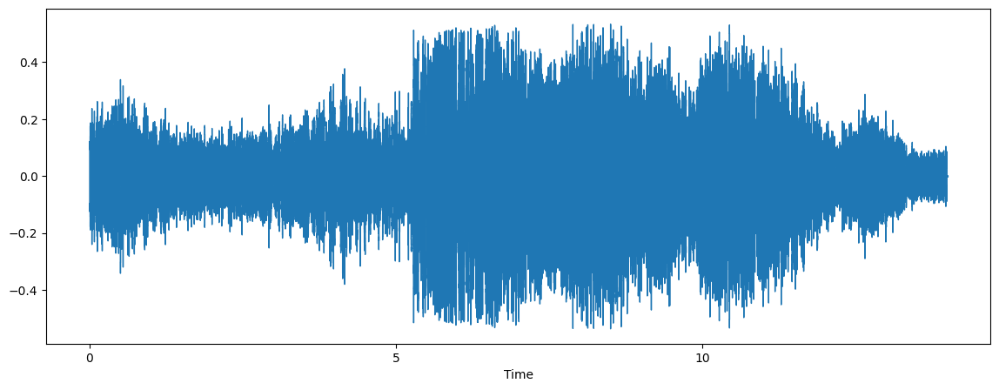

In [248]:
%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display
plt.figure(figsize=(14, 5))
librosa.display.waveshow(x, sr=sr)

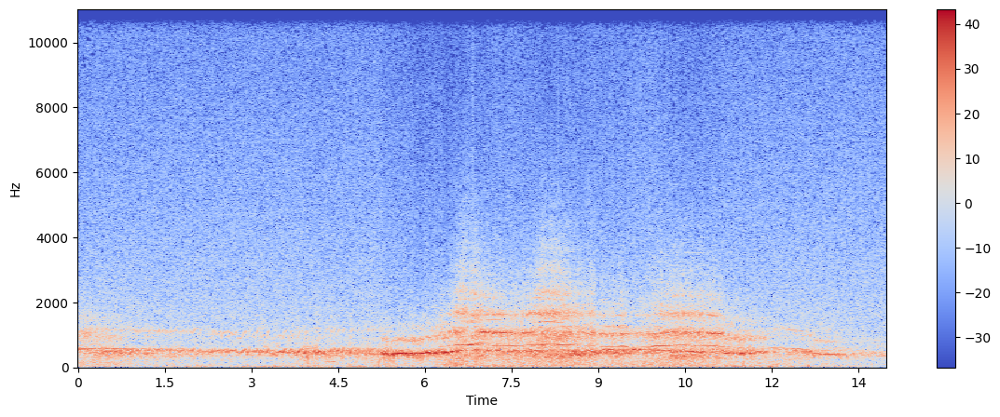

In [249]:
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()

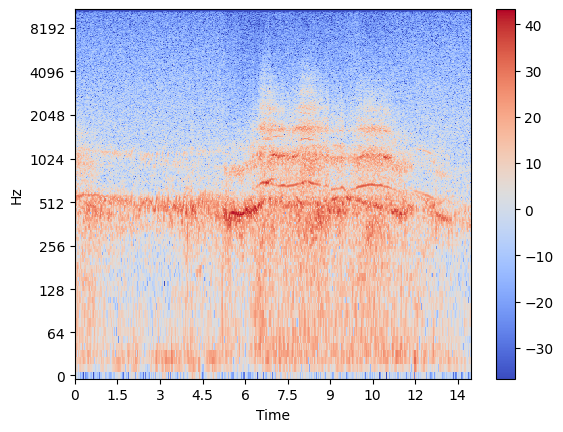

In [250]:
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()

In [251]:
import sklearn
spectral_centroids = librosa.feature.spectral_centroid(y=x, sr=sr)[0]
spectral_centroids.shape
# # Computing the time variable for visualization
# plt.figure(figsize=(12, 4))frames = range(len(spectral_centroids))
# t = librosa.frames_to_time(frames)
# # Normalising the spectral centroid for visualisation
# def normalize(x, axis=0):
#     return sklearn.preprocessing.minmax_scale(x, axis=axis)
# #Plotting the Spectral Centroid along the waveform
# librosa.display.waveplot(x, sr=sr, alpha=0.4)
# plt.plot(t, normalize(spectral_centroids), color='b')

(603,)

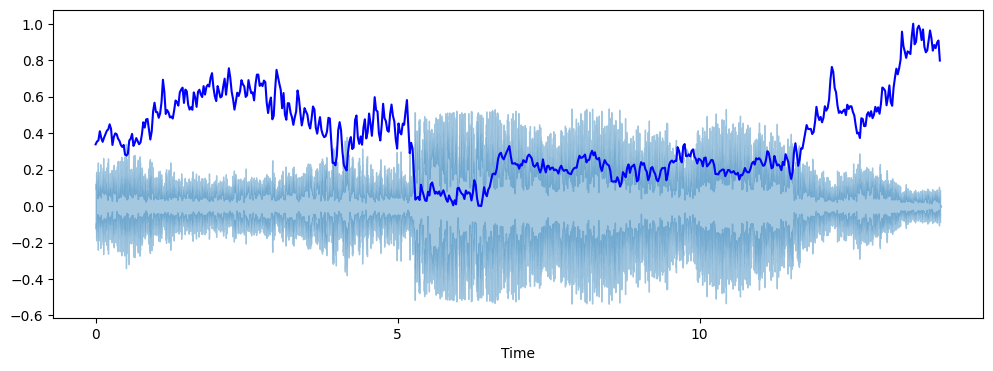

In [252]:
plt.figure(figsize=(12, 4))
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='b')

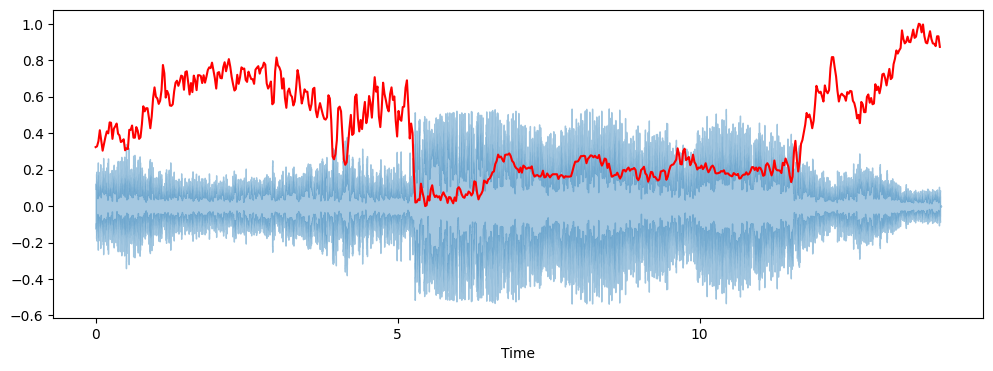

In [253]:
spectral_rolloff = librosa.feature.spectral_rolloff(y=x+0.01, sr=sr)[0]
plt.figure(figsize=(12, 4))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='r')

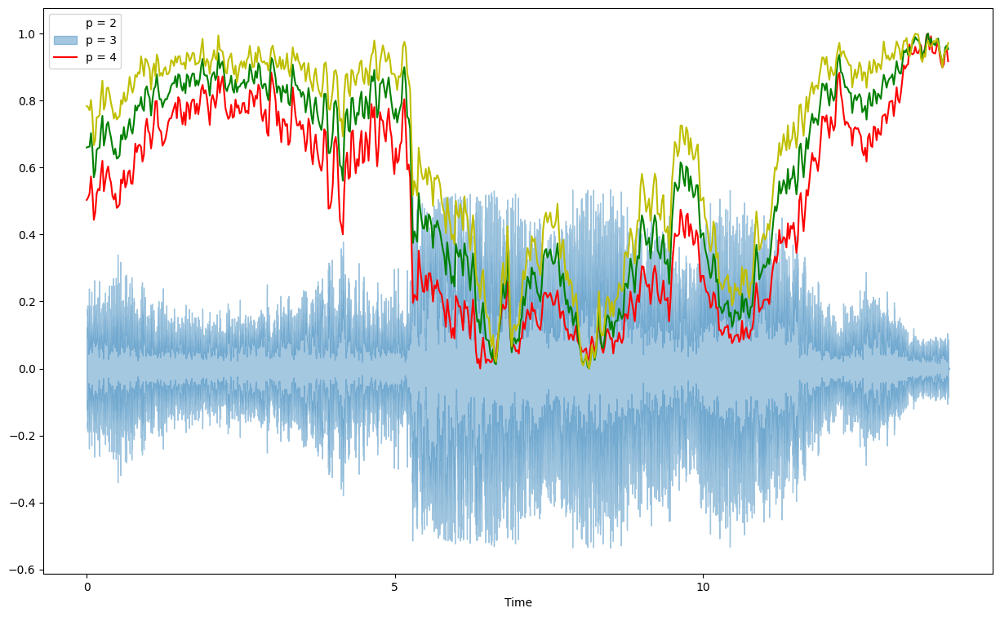

In [254]:
spectral_bandwidth_2 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr)[0]
spectral_bandwidth_3 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=3)[0]
spectral_bandwidth_4 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=4)[0]
plt.figure(figsize=(15, 9))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_bandwidth_2), color='r')
plt.plot(t, normalize(spectral_bandwidth_3), color='g')
plt.plot(t, normalize(spectral_bandwidth_4), color='y')
plt.legend(('p = 2', 'p = 3', 'p = 4'))

In [255]:
mfccs = librosa.feature.mfcc(y=x, sr=sr)
print(mfccs.shape)


(20, 603)


In [256]:
mfccs

array([[-1.8895425e+02, -1.4834189e+02, -1.4261252e+02, ...,
        -1.8060658e+02, -1.8759727e+02, -2.1480110e+02],
       [ 1.3824043e+02,  1.3771359e+02,  1.3777570e+02, ...,
         8.9315048e+01,  8.8086159e+01,  9.3047012e+01],
       [ 1.2797934e+00,  6.3622081e-01,  2.5489055e-02, ...,
         7.3255408e-01,  6.1674225e-01,  2.8724742e+00],
       ...,
       [-8.5397701e+00, -6.2319279e+00, -4.4753933e+00, ...,
         1.0689600e+01,  1.1338041e+01,  1.2199445e+01],
       [-9.5859623e+00, -3.3788280e+00, -1.4433395e+00, ...,
         7.4249039e+00,  2.8161101e+00,  9.0697730e-01],
       [-4.0551548e+00, -1.9793206e+00, -2.1006935e+00, ...,
         7.5042300e+00,  2.8030212e+00,  5.0810966e+00]], dtype=float32)

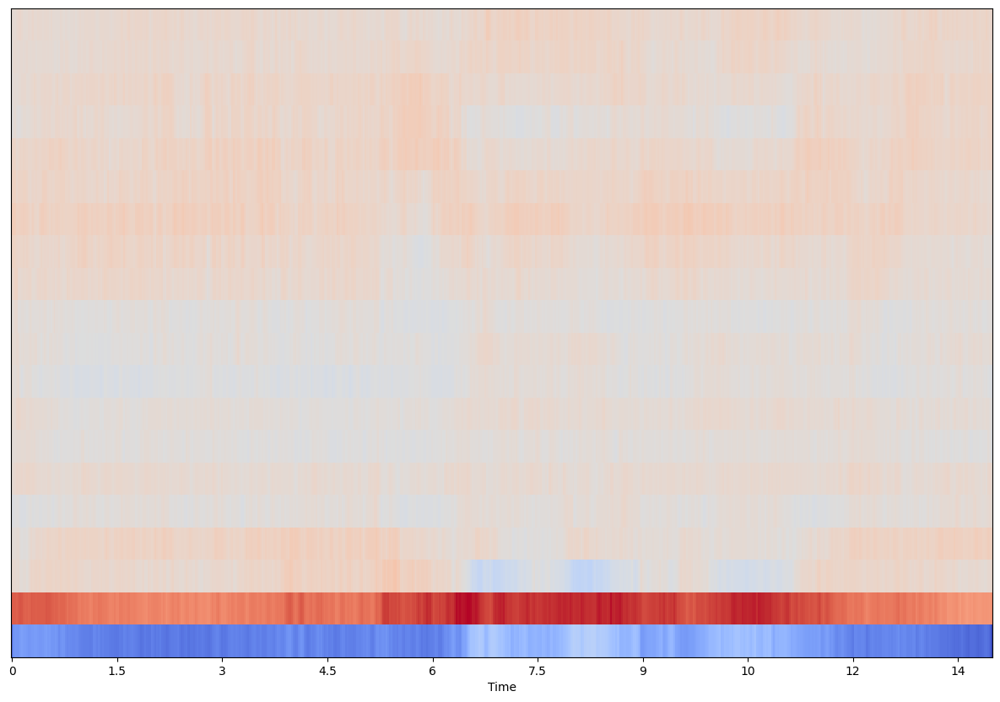

In [257]:
#Displaying  the MFCCs:
plt.figure(figsize=(15, 10))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

### Step 2: Compute Mel-Scaled Spectrogram
The Mel scale is a perceptual scale of pitches judged by listeners to be equal in distance from one another. The reference point between this scale and normal frequency measurement is defined by assigning a perceptual pitch of 1000 mels to a 1000 Hz tone, 40 dB above the listener's threshold.

This scale is used in speech and music processing, particularly for voice recognition, because it approximates human hearing much more closely than the linear frequency scale.

Now, we will compute a Mel-scaled spectrogram for the same audio file.

This process involves converting the conventional frequency scale into the Mel scale, which correlates better with human auditory perception.

In [258]:
y, sr = librosa.load(audio_data)
librosa.feature.melspectrogram(y=y, sr=sr)

array([[5.9533834e-01, 3.2363591e+00, 3.8285902e+00, ..., 6.3203883e-01,
        2.3288694e-01, 1.1636706e-01],
       [6.6143513e-01, 2.2983584e+00, 4.5434270e+00, ..., 2.0294057e-01,
        1.1854868e-01, 5.6000214e-02],
       [4.6608499e-01, 2.5166168e+00, 3.9115415e+00, ..., 4.9200928e-01,
        7.6739603e-01, 2.3057455e-01],
       ...,
       [4.8176819e-04, 6.3660671e-04, 6.3233788e-04, ..., 1.2285601e-03,
        1.1253151e-03, 4.8138906e-04],
       [1.3355790e-04, 4.6616825e-04, 5.8360241e-04, ..., 6.2678679e-04,
        3.7184689e-04, 1.2871492e-04],
       [1.1068466e-05, 4.9261780e-05, 6.4610671e-05, ..., 3.4823093e-05,
        3.2080879e-05, 2.1291262e-05]], dtype=float32)

In [259]:
S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128,
                                    fmax=8000)

[Text(0.5, 1.0, 'Mel-frequency spectrogram')]

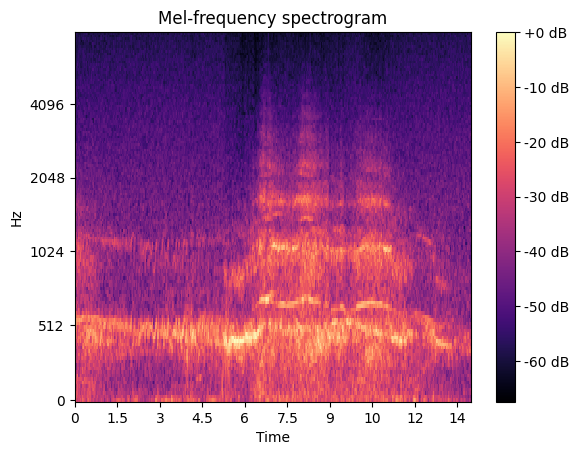

In [260]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
S_dB = librosa.power_to_db(S, ref=np.max)
img = librosa.display.specshow(S_dB, x_axis='time',
                         y_axis='mel', sr=sr,
                         fmax=8000, ax=ax)
fig.colorbar(img, ax=ax, format='%+2.0f dB')
ax.set(title='Mel-frequency spectrogram')

### Step 3: Short-Time Fourier Transform (STFT)

The Short-Time Fourier Transform (STFT) analyzes the frequency content of a signal over time by applying the Fourier Transform to overlapping short segments or windows of the signal. This produces a time-frequency representation called a spectrogram. The window length determines a trade-off: longer windows provide better frequency resolution but worse time resolution, and vice versa. Commonly used in audio and speech processing, the STFT reveals how the signal's frequency components evolve over time.


In [261]:
y, sr = librosa.load(audio_data)
S = np.abs(librosa.stft(y))
S

array([[3.14106494e-02, 7.10177183e-01, 8.98013949e-01, ...,
        2.33582199e-01, 4.20253932e-01, 2.43717015e-01],
       [1.19156277e+00, 2.03039765e+00, 2.75737977e+00, ...,
        1.76188397e+00, 1.52493417e+00, 8.96243989e-01],
       [2.43630719e+00, 5.60402966e+00, 3.41069651e+00, ...,
        3.19810772e+00, 2.20514369e+00, 1.36458182e+00],
       ...,
       [3.98428747e-05, 2.58419623e-05, 1.41675719e-06, ...,
        5.85611986e-07, 1.03624029e-06, 1.17901109e-04],
       [2.74994982e-05, 2.10523212e-05, 1.33270100e-06, ...,
        5.69607721e-08, 7.61166120e-07, 1.17080213e-04],
       [2.10364033e-05, 1.82107178e-05, 1.43379543e-06, ...,
        1.51218742e-07, 6.55430654e-07, 1.16375384e-04]], dtype=float32)

In [262]:
S_left = librosa.stft(y, center=False)

In [263]:
D_short = librosa.stft(y, hop_length=64)

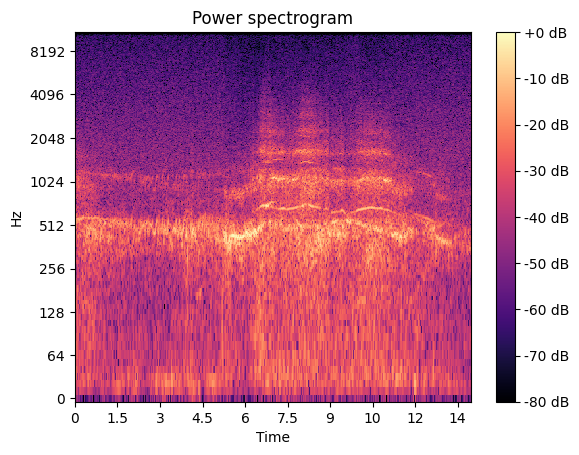

In [264]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
img = librosa.display.specshow(
    librosa.amplitude_to_db(S,ref=np.max),
    y_axis='log',
    x_axis='time',
    ax=ax
    )
ax.set_title('Power spectrogram')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

### Step 4: Beat Tracker

The `librosa` beat tracker detects the rhythmic pulse or "beats" in an audio signal. By analyzing the onset strength of a signal, which corresponds to sudden changes or events in the audio, it determines the timing of beats. Beat tracking is essential for various music analysis tasks, such as tempo estimation, rhythm analysis, and synchronization. In applications like DJ software, automatic music tagging, or dance choreography, the detected beats can be used to align tracks, categorize music, or coordinate movements to the rhythm.


In [265]:
y, sr = librosa.load(audio_data)

In [266]:
tempo, beats = librosa.beat.beat_track(y=y, sr=sr)

In [267]:
tempo

151.99908088235293

In [268]:
beats

array([  3,  21,  37,  54,  71,  88, 104, 120, 137, 154, 171, 189, 208,
       226, 244, 261, 279, 295, 311, 328, 346, 364, 382, 400, 418, 436,
       454, 471, 487, 503, 520])

In [269]:
onset_env = librosa.onset.onset_strength(y=y, sr=sr,
                                         aggregate=np.median)
tempo, beats = librosa.beat.beat_track(onset_envelope=onset_env,
                                       sr=sr)

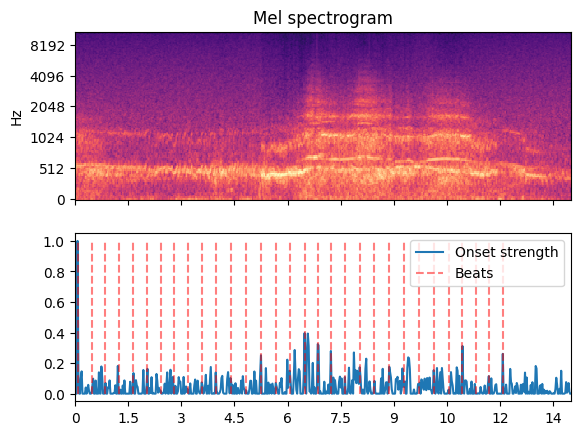

In [270]:
import matplotlib.pyplot as plt
hop_length = 512
fig, ax = plt.subplots(nrows=2, sharex=True)
times = librosa.times_like(onset_env, sr=sr, hop_length=hop_length)
M = librosa.feature.melspectrogram(y=y, sr=sr, hop_length=hop_length)
librosa.display.specshow(librosa.power_to_db(M, ref=np.max),
                         y_axis='mel', x_axis='time', hop_length=hop_length,
                         ax=ax[0])
ax[0].label_outer()
ax[0].set(title='Mel spectrogram')
ax[1].plot(times, librosa.util.normalize(onset_env),
         label='Onset strength')
ax[1].vlines(times[beats], 0, 1, alpha=0.5, color='r',
           linestyle='--', label='Beats')
ax[1].legend()

### Step 5: Compute Constant-Q Transform of Audio Signal

The Constant Q Transform (CQT) in librosa provides a time-frequency representation of an audio signal where the frequency bins are geometrically spaced. Unlike the linear spacing of the Short-Time Fourier Transform (STFT), the CQT's spacing mirrors the logarithmic perception of pitch in human hearing. This makes the CQT especially useful for musical analysis. In the CQT, the "Q-factor" (a ratio of the center frequency to bandwidth) remains constant across all frequencies, ensuring that each frequency bin has consistent resolution. When visualized, harmonics of musical notes align vertically in a CQT spectrogram, making it valuable for studying harmonic structures. In librosa, the cqt function efficiently computes this representation.

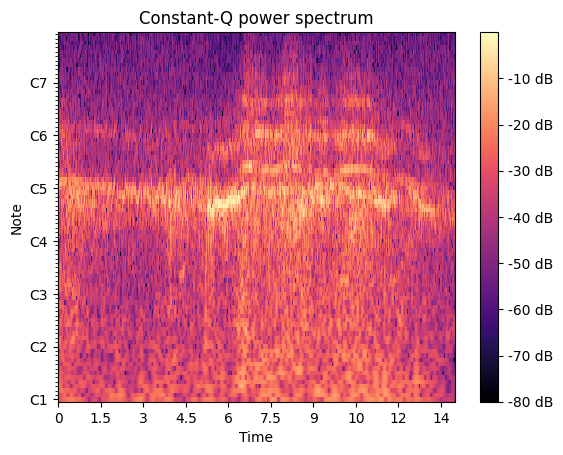

In [271]:
import matplotlib.pyplot as plt
y, sr = librosa.load(audio_data)
C = np.abs(librosa.cqt(y, sr=sr))
fig, ax = plt.subplots()
img = librosa.display.specshow(librosa.amplitude_to_db(C, ref=np.max),
                               sr=sr, x_axis='time', y_axis='cqt_note', ax=ax)
ax.set_title('Constant-Q power spectrum')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

In [272]:
print("The Constant-Q Transform of the Audio Signal is:")
print(C)

The Constant-Q Transform of the Audio Signal is:
[[0.1824954  0.18484539 0.18532869 ... 0.0656022  0.05678483 0.04799412]
 [0.2101074  0.20589612 0.19127831 ... 0.0747847  0.06744717 0.05845777]
 [0.2850946  0.31656805 0.34153697 ... 0.05891882 0.05972377 0.05673729]
 ...
 [0.00247639 0.02010582 0.00939667 ... 0.02373834 0.0150714  0.005322  ]
 [0.0030604  0.0110643  0.00308691 ... 0.01461237 0.0089988  0.01247508]
 [0.00664073 0.00626534 0.01081729 ... 0.0020642  0.00931193 0.00530176]]


## Whistler


### Setup

In [273]:
current_file = whistler_file_path

In [274]:
audio_data = current_file
x , sr = librosa.load(audio_data)
print(type(x), type(sr))
print(x.shape, sr)

<class 'numpy.ndarray'> <class 'int'>
(680996,) 22050


In [275]:
librosa.load(audio_data, sr=44100)

(array([0.0000000e+00, 1.5085531e-10, 3.9470605e-10, ..., 7.5010937e-03,
        1.6088143e-02, 1.5781028e-02], dtype=float32),
 44100)

In [276]:
import IPython.display as ipd
ipd.Audio(audio_data)

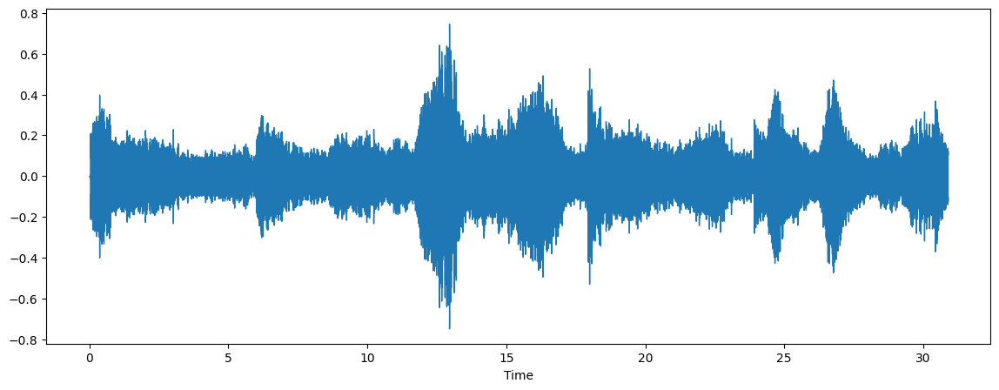

In [277]:
%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display
plt.figure(figsize=(14, 5))
librosa.display.waveshow(x, sr=sr)

In [278]:
# Build a simple chroma filter bank
chromafb = librosa.filters.chroma(sr=22050, n_fft=4096)

chromafb

array([[1.70601543e-05, 2.82992725e-04, 1.03555294e-03, ...,
        5.23030704e-21, 4.43047226e-21, 3.75236833e-21],
       [1.66987356e-05, 3.18591396e-04, 1.46405352e-03, ...,
        1.25662976e-13, 1.10109757e-13, 9.64649842e-14],
       [1.61444223e-05, 3.48842266e-04, 1.90847355e-03, ...,
        5.52980168e-08, 5.01214537e-08, 4.54209257e-08],
       ...,
       [1.68931711e-05, 3.02419503e-04, 1.25730084e-03, ...,
        4.03871397e-17, 4.63902409e-17, 5.32694454e-17],
       [1.71591892e-05, 2.65152019e-04, 8.56101280e-04, ...,
        2.25072222e-25, 2.67424414e-25, 3.17644285e-25],
       [1.72155414e-05, 2.44485302e-04, 6.75355259e-04, ...,
        3.98721026e-30, 3.26509862e-30, 2.67339596e-30]], dtype=float32)

In [279]:
# Use quarter-tones instead of semitones
librosa.filters.chroma(sr=22050, n_fft=4096, n_chroma=24)

array([[1.2062923e-05, 2.0009540e-04, 7.3222251e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.1952894e-05, 2.1304651e-04, 8.7951310e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.1807369e-05, 2.2526611e-04, 1.0352081e-03, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       ...,
       [1.2171624e-05, 1.7373025e-04, 4.8452709e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.2172794e-05, 1.7286799e-04, 4.7753262e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.2136448e-05, 1.8663100e-04, 5.9735152e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00]], dtype=float32)

In [280]:
# Equally weight all octaves
librosa.filters.chroma(sr=22050, n_fft=4096, octwidth=None)

array([[3.06632757e-01, 2.43654341e-01, 1.60742402e-01, ...,
        2.75466492e-20, 2.33491276e-20, 1.97881458e-20],
       [3.00136745e-01, 2.74304509e-01, 2.27255851e-01, ...,
        6.61833761e-13, 5.80291837e-13, 5.08708906e-13],
       [2.90173739e-01, 3.00350249e-01, 2.96240419e-01, ...,
        2.91240070e-07, 2.64146166e-07, 2.39527623e-07],
       ...,
       [3.03631455e-01, 2.60380656e-01, 1.95162937e-01, ...,
        2.12708409e-16, 2.44482217e-16, 2.80916862e-16],
       [3.08412760e-01, 2.28293657e-01, 1.32887244e-01, ...,
        1.18539604e-24, 1.40935927e-24, 1.67509979e-24],
       [3.09425622e-01, 2.10499778e-01, 1.04831174e-01, ...,
        2.09995848e-29, 1.72074678e-29, 1.40981758e-29]], dtype=float32)

### Step 1: Display Spectrogram, Chromogram, and CQT

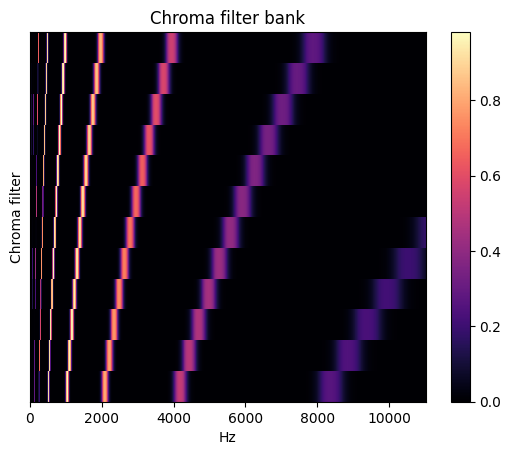

In [281]:
#https://librosa.org/doc-playground/main/generated/librosa.filters.chroma.html?highlight=chroma#librosa.filters.chroma
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
img = librosa.display.specshow(chromafb, x_axis='linear', ax=ax)
ax.set(ylabel='Chroma filter', title='Chroma filter bank')
fig.colorbar(img, ax=ax)


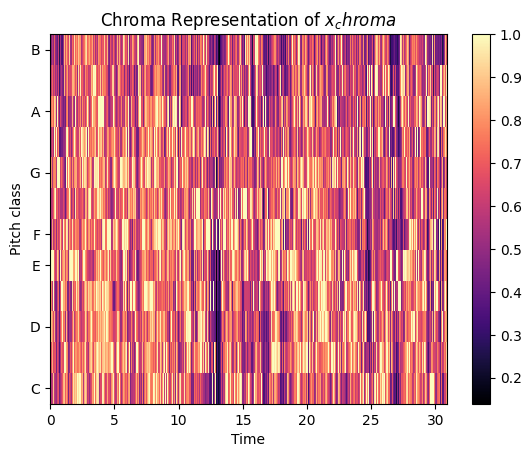

In [282]:
#https://librosa.org/doc-playground/main/auto_examples/plot_music_sync.html?highlight=chroma

# Extract Chroma Features

hop_length = 1024

x_chroma = librosa.feature.chroma_cqt(y=x, sr=sr,
                                         hop_length=hop_length)

fig, ax = plt.subplots(nrows=1, sharey=True)
img = librosa.display.specshow(x_chroma, x_axis='time',
                               y_axis='chroma',
                               hop_length=hop_length, ax=ax)
ax.set(title='Chroma Representation of $x_chroma$')
fig.colorbar(img, ax=ax)

In [283]:
#https://librosa.org/doc-playground/main/generated/librosa.feature.chroma_stft.html?highlight=ibrosa%20feature%20chroma_stft#librosa.feature.chroma_stft
#Energy
librosa.feature.chroma_stft(y=x, sr=sr)

array([[0.16744493, 0.15875697, 0.3198174 , ..., 0.37696442, 0.5152892 ,
        0.6623992 ],
       [0.18694001, 0.26244608, 0.6873935 , ..., 0.6393014 , 0.98703235,
        0.71582156],
       [0.34921032, 0.5158317 , 0.8928931 , ..., 0.71483874, 1.        ,
        0.613229  ],
       ...,
       [0.3656563 , 0.41936725, 0.6692897 , ..., 0.3781986 , 0.6965148 ,
        1.        ],
       [0.28936002, 0.23611113, 0.37056503, ..., 0.5734231 , 0.7053091 ,
        0.84677154],
       [0.21326962, 0.19983107, 0.3086337 , ..., 0.5247638 , 0.6466482 ,
        0.89387304]], dtype=float32)

In [284]:
# Use an energy (magnitude) spectrum instead of power spectrogram
S = np.abs(librosa.stft(x))
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
chroma

array([[0.48245066, 0.45076582, 0.5198629 , ..., 0.5893033 , 0.6881908 ,
        0.7902868 ],
       [0.68100494, 0.7364073 , 0.8486568 , ..., 0.80329734, 1.        ,
        0.8218947 ],
       [0.72494274, 0.80824727, 0.8923779 , ..., 0.8524239 , 0.85611445,
        0.7311064 ],
       ...,
       [0.80315393, 0.83085364, 0.89472044, ..., 0.65567183, 0.86237246,
        1.        ],
       [0.65931356, 0.60783404, 0.6400908 , ..., 0.7357387 , 0.8149858 ,
        0.9341155 ],
       [0.5975514 , 0.5230046 , 0.52838445, ..., 0.69558567, 0.75329596,
        0.86997193]], dtype=float32)

In [285]:
# Use an energy (magnitude) spectrum instead of power spectrogram
S = np.abs(librosa.stft(x))
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
chroma

array([[0.48245066, 0.45076582, 0.5198629 , ..., 0.5893033 , 0.6881908 ,
        0.7902868 ],
       [0.68100494, 0.7364073 , 0.8486568 , ..., 0.80329734, 1.        ,
        0.8218947 ],
       [0.72494274, 0.80824727, 0.8923779 , ..., 0.8524239 , 0.85611445,
        0.7311064 ],
       ...,
       [0.80315393, 0.83085364, 0.89472044, ..., 0.65567183, 0.86237246,
        1.        ],
       [0.65931356, 0.60783404, 0.6400908 , ..., 0.7357387 , 0.8149858 ,
        0.9341155 ],
       [0.5975514 , 0.5230046 , 0.52838445, ..., 0.69558567, 0.75329596,
        0.86997193]], dtype=float32)

In [286]:
# Use a pre-computed power spectrogram with a larger frame
S = np.abs(librosa.stft(x, n_fft=4096))**2
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
chroma

array([[0.18687738, 0.30689135, 0.32484472, ..., 0.46730238, 0.42229345,
        0.6173323 ],
       [0.47811398, 0.7134608 , 0.6108133 , ..., 0.33493036, 0.72037727,
        1.        ],
       [0.52241385, 0.5983249 , 0.58208764, ..., 0.5667452 , 0.8214228 ,
        0.7717536 ],
       ...,
       [0.45198438, 0.49545437, 0.41049334, ..., 1.        , 0.5590493 ,
        0.8776887 ],
       [0.2528332 , 0.33199525, 0.305126  , ..., 0.79943967, 0.704011  ,
        0.84513074],
       [0.22976668, 0.25188974, 0.25865185, ..., 0.97977537, 0.6903349 ,
        0.74349743]], dtype=float32)

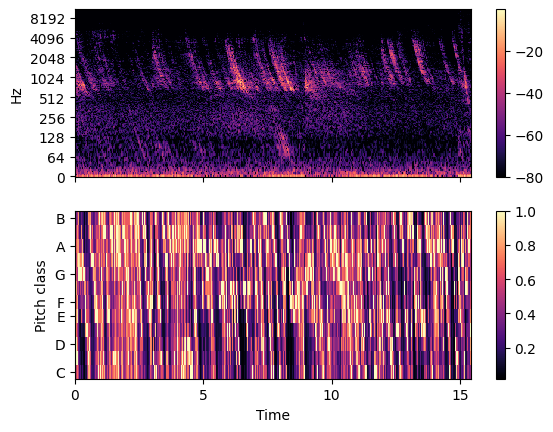

In [287]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(nrows=2, sharex=True)
img = librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),
                               y_axis='log', x_axis='time', ax=ax[0])
fig.colorbar(img, ax=[ax[0]])
ax[0].label_outer()
img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax[1])
fig.colorbar(img, ax=[ax[1]])

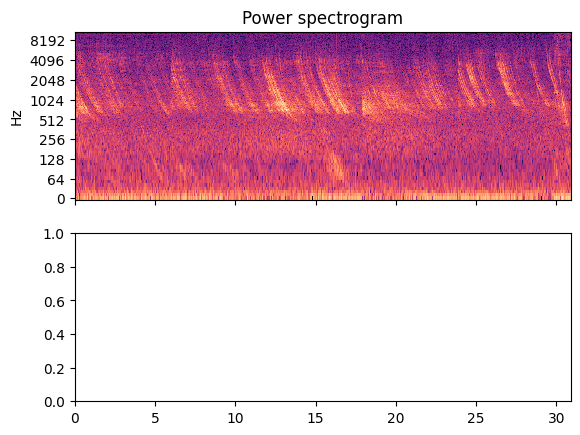

In [288]:
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()

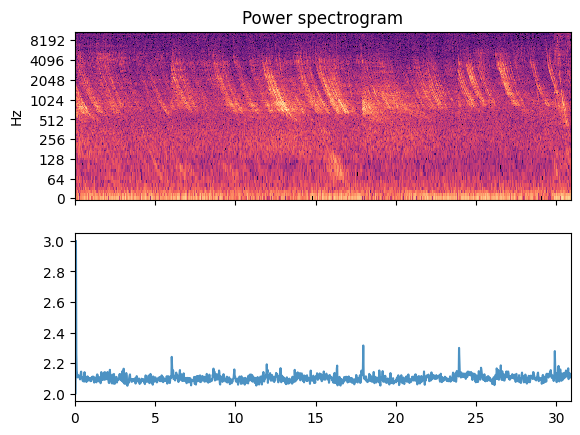

In [289]:
# Construct a standard onset function
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()
onset_env = librosa.onset.onset_strength(y=x, sr=sr)
ax[1].plot(times, 2 + onset_env / onset_env.max(), alpha=0.8,
           label='Mean (mel)')

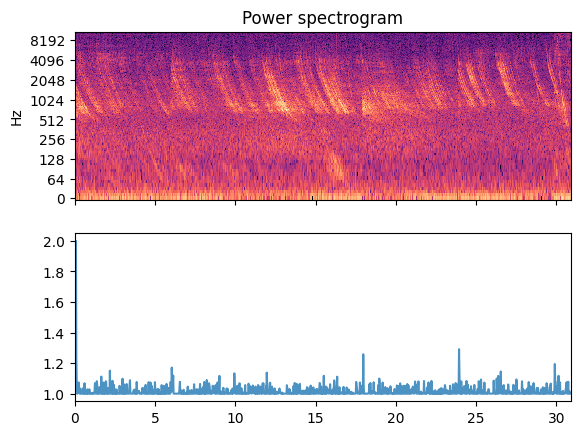

In [290]:
# Median aggregation, and custom mel options
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()

onset_env = librosa.onset.onset_strength(y=x, sr=sr,
                                         aggregate=np.median,
                                         fmax=8000, n_mels=256)
ax[1].plot(times, 1 + onset_env / onset_env.max(), alpha=0.8,
           label='Median (custom mel)')


[Text(0, 0.5, 'Normalized strength'), []]

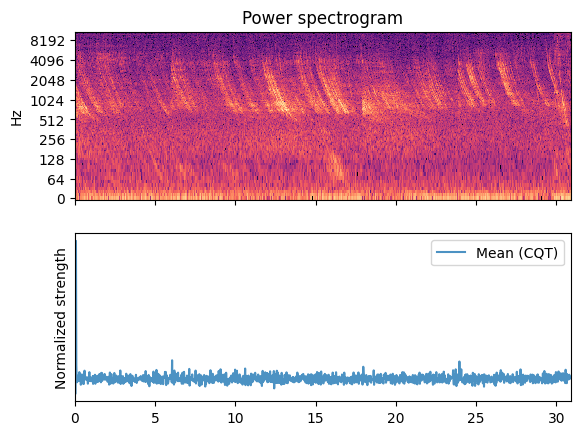

In [291]:
# Constant-Q spectrogram instead of Mel
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()


C = np.abs(librosa.cqt(y=x, sr=sr))
onset_env = librosa.onset.onset_strength(sr=sr, S=librosa.amplitude_to_db(C, ref=np.max))
ax[1].plot(times, onset_env / onset_env.max(), alpha=0.8,
         label='Mean (CQT)')
ax[1].legend()
ax[1].set(ylabel='Normalized strength', yticks=[])


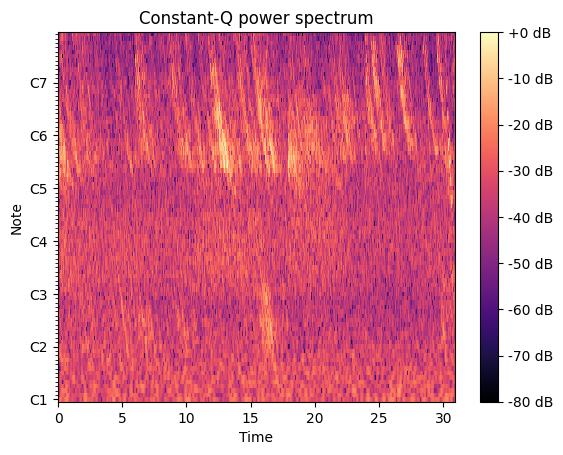

In [292]:
C = np.abs(librosa.cqt(x, sr=sr))
fig, ax = plt.subplots()
img = librosa.display.specshow(librosa.amplitude_to_db(C, ref=np.max),
                               sr=sr, x_axis='time', y_axis='cqt_note', ax=ax)
ax.set_title('Constant-Q power spectrum')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

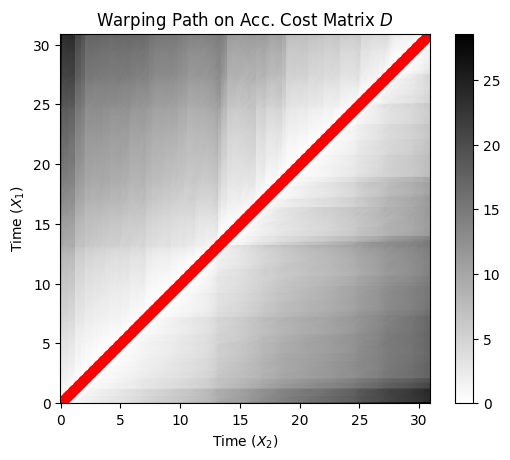

In [293]:
D, wp = librosa.sequence.dtw(X=x_chroma,Y=x_chroma, metric='cosine')
wp_s = librosa.frames_to_time(wp, sr=sr, hop_length=hop_length)

fig, ax = plt.subplots()
img = librosa.display.specshow(D, x_axis='time', y_axis='time', sr=sr,
                               cmap='gray_r', hop_length=hop_length, ax=ax)
ax.plot(wp_s[:, 1], wp_s[:, 0], marker='o', color='r')
ax.set(title='Warping Path on Acc. Cost Matrix $D$',
       xlabel='Time $(X_2)$', ylabel='Time $(X_1)$')
fig.colorbar(img, ax=ax)


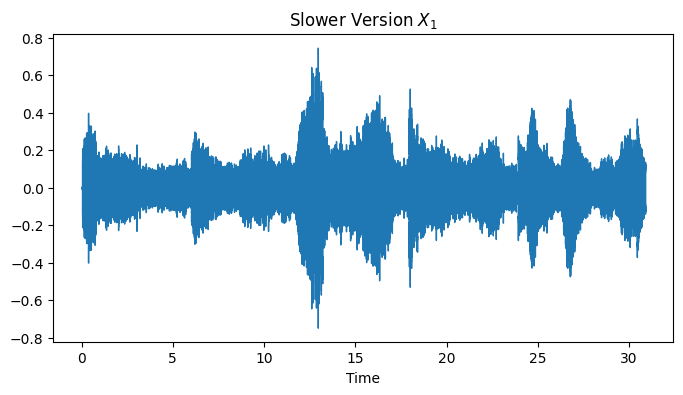

In [294]:
#Alternative Visualization in the Time Domain
fig, ax1 = plt.subplots(nrows=1, sharex=True, sharey=True, figsize=(8, 4))

# Plot x_1
librosa.display.waveshow(x, sr=sr, ax=ax1)
ax1.set(title='Slower Version $X_1$')
ax1.label_outer()


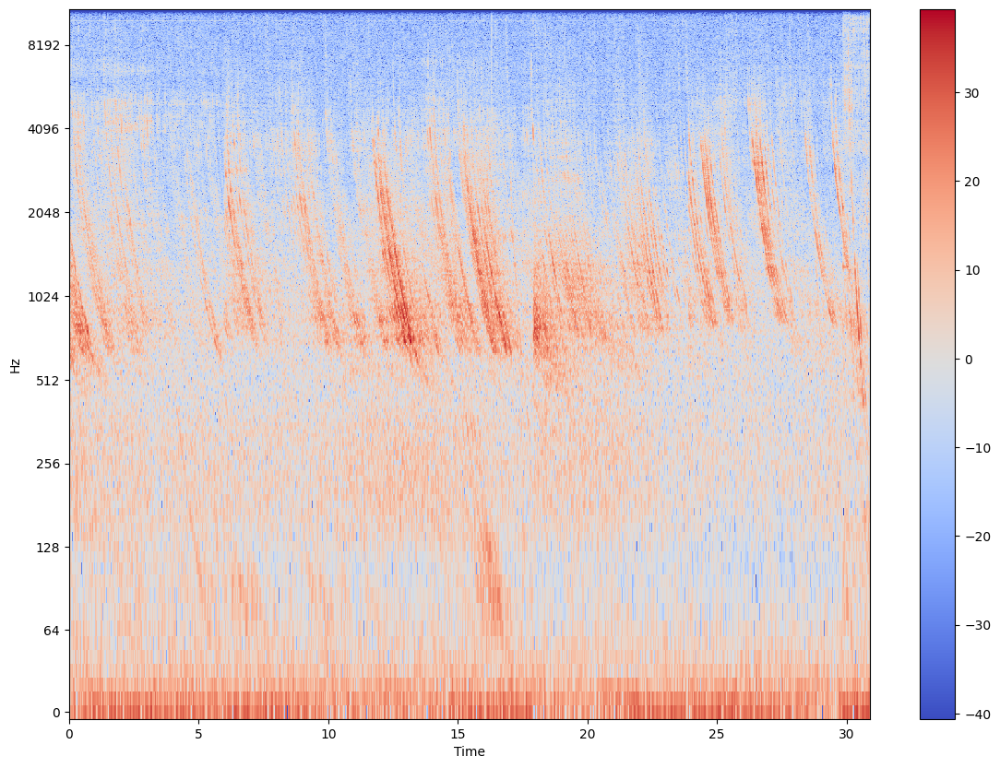

In [295]:
# Spectrogram
import matplotlib.pyplot as plt
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 10))

librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()

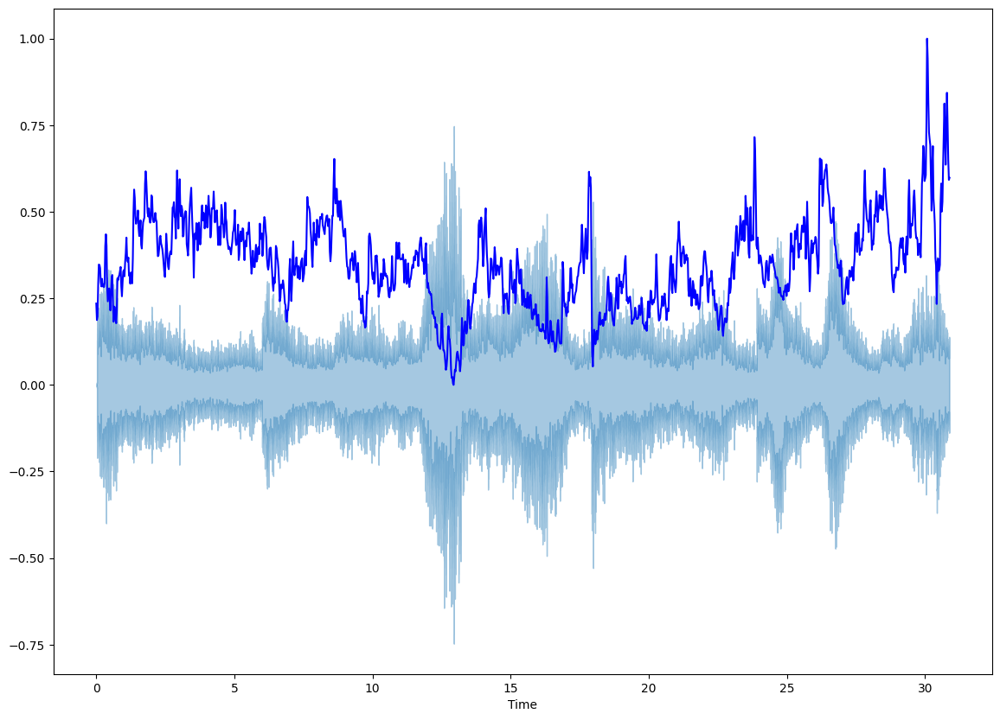

In [296]:
# Spectral Centroid
import sklearn
from sklearn import preprocessing
#https://zhuanlan.zhihu.com/p/144922679
#labelEncoder= preprocessing.LabelEncoder()

spectral_centroids = librosa.feature.spectral_centroid(y=x, sr=sr)[0]
spectral_centroids.shape
plt.figure(figsize=(14, 10))
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='b')

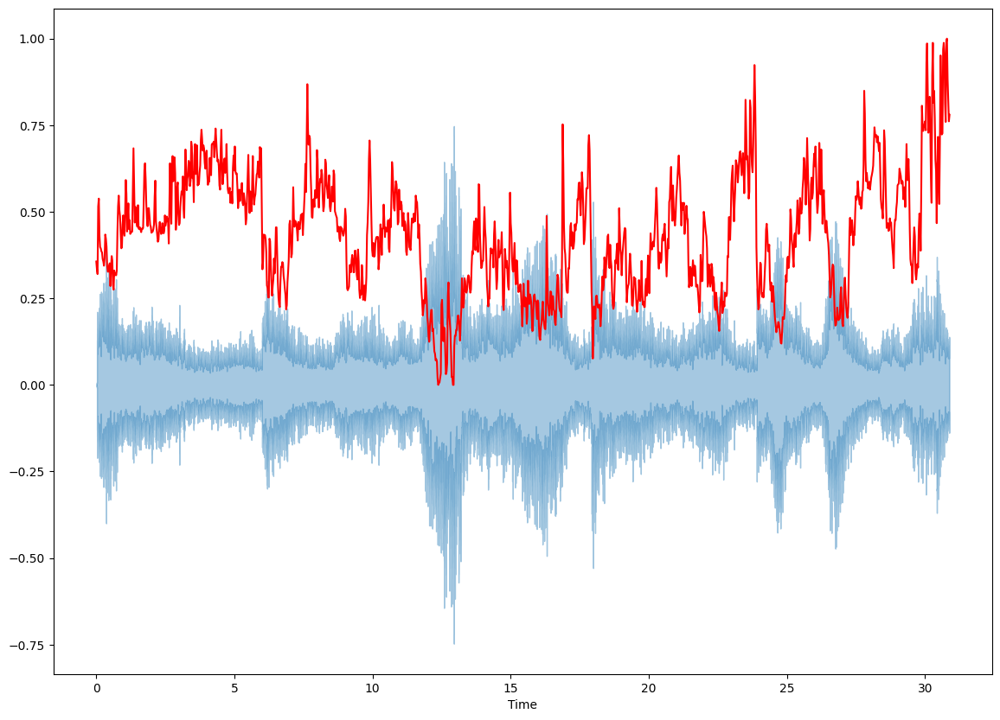

In [297]:
# Spectral Rolloff
spectral_rolloff = librosa.feature.spectral_rolloff(y=x+0.01, sr=sr)[0]
plt.figure(figsize=(14, 10))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='r')

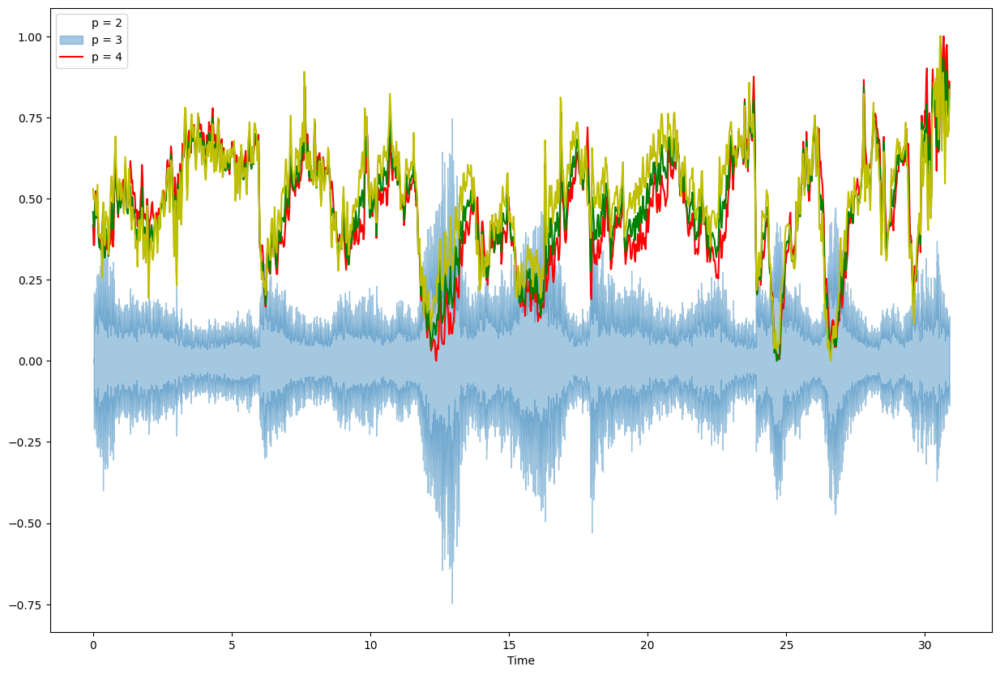

In [298]:
# Spectral Bandwidth
spectral_bandwidth_2 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr)[0]
spectral_bandwidth_3 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=3)[0]
spectral_bandwidth_4 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=4)[0]
plt.figure(figsize=(15, 10))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_bandwidth_2), color='r')
plt.plot(t, normalize(spectral_bandwidth_3), color='g')
plt.plot(t, normalize(spectral_bandwidth_4), color='y')
plt.legend(('p = 2', 'p = 3', 'p = 4'))

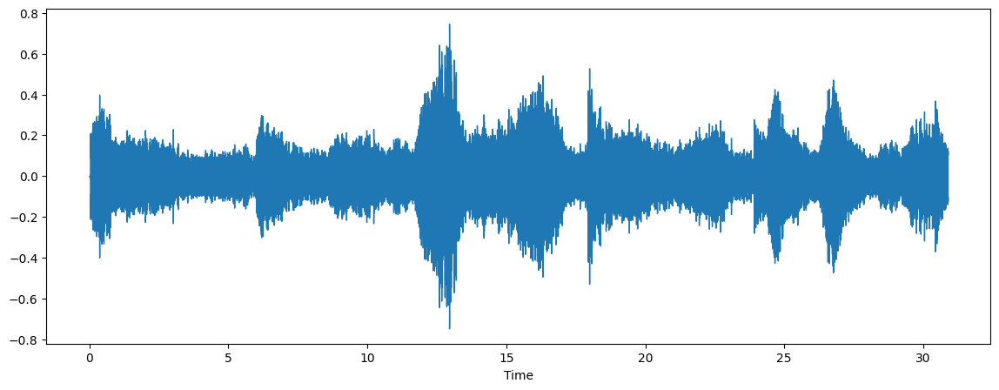

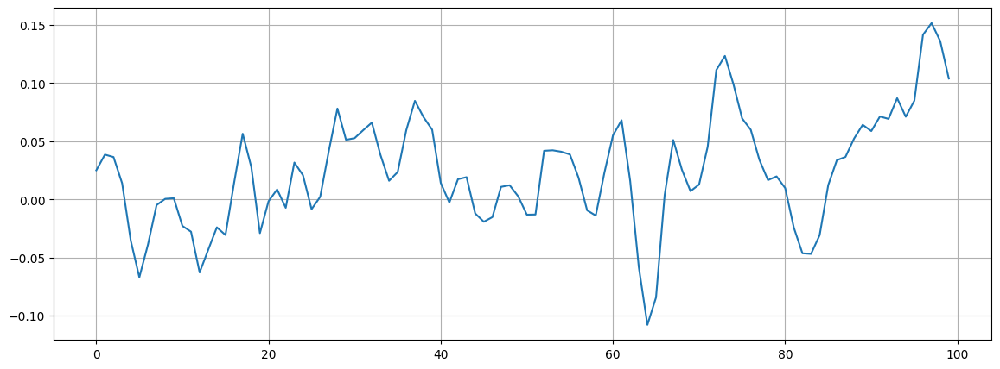

In [299]:
# Zero-Crossing Rate
x, sr = librosa.load(audio_data)
#Plot the signal:
plt.figure(figsize=(14, 5))
librosa.display.waveshow(x, sr=sr)
# Zooming in
n0 = 9000
n1 = 9100
plt.figure(figsize=(14, 5))
plt.plot(x[n0:n1])
plt.grid()

In [300]:
zero_crossings = librosa.zero_crossings(x[n0:n1], pad=False)
print(sum(zero_crossings))

22


(20, 1331)


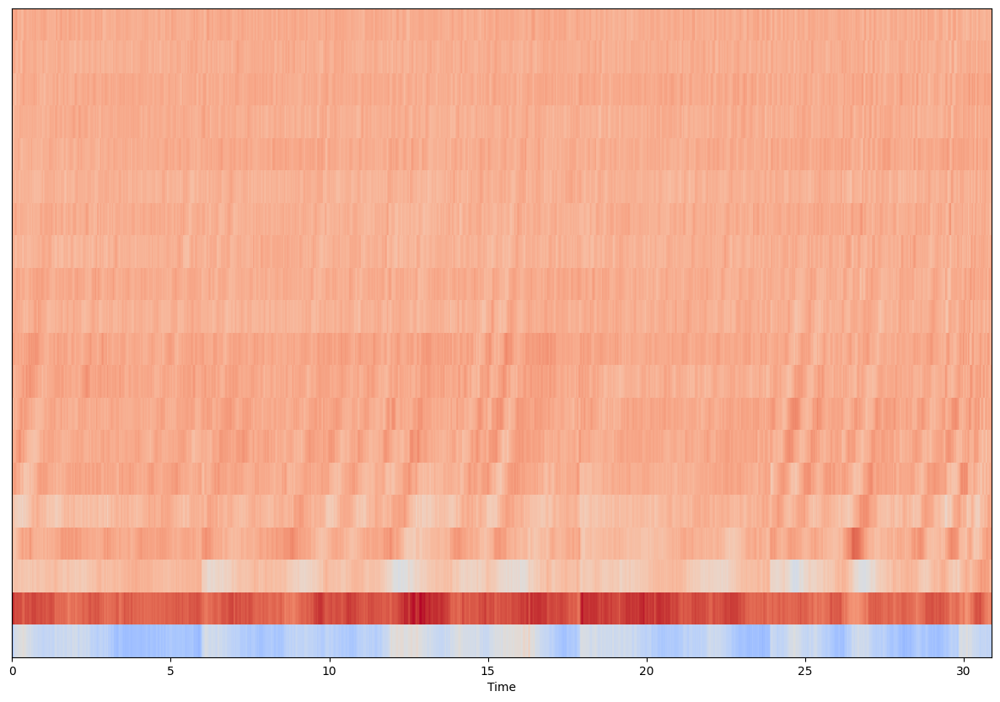

In [301]:
mfccs = librosa.feature.mfcc(y=x, sr=sr)
print(mfccs.shape)
plt.figure(figsize=(15, 10))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

In [302]:
librosa.load(audio_data, sr=44100)

(array([0.0000000e+00, 1.5085531e-10, 3.9470605e-10, ..., 7.5010937e-03,
        1.6088143e-02, 1.5781028e-02], dtype=float32),
 44100)

In [303]:
ipd.Audio(audio_data)

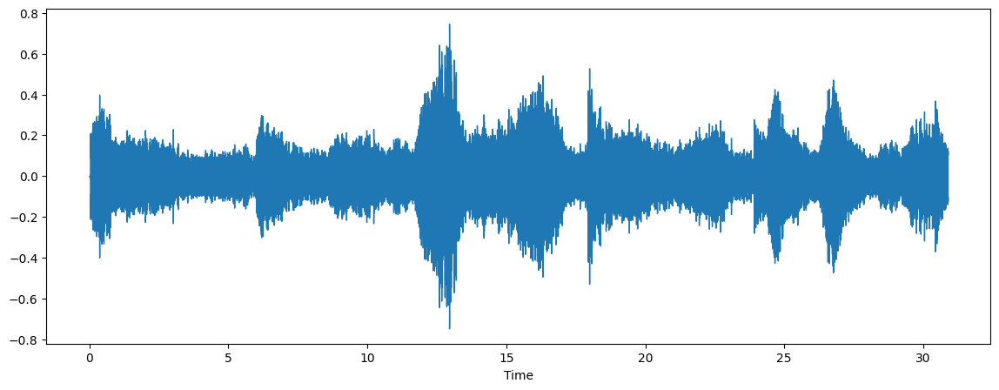

In [304]:
%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display
plt.figure(figsize=(14, 5))
librosa.display.waveshow(x, sr=sr)

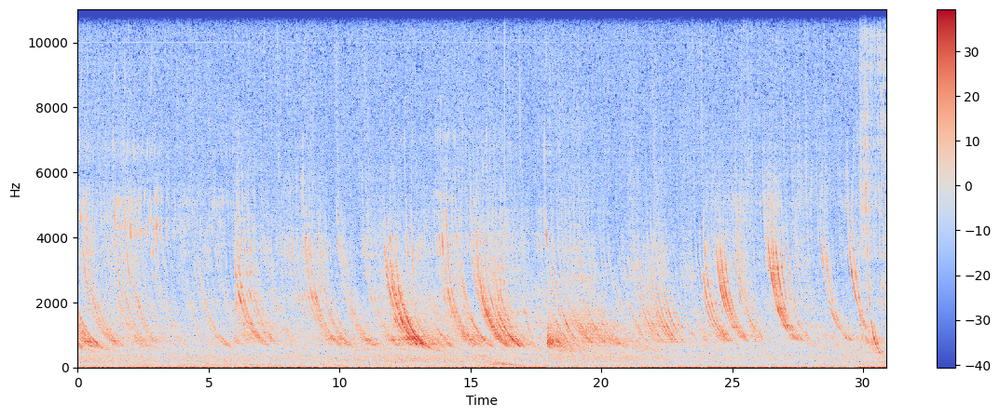

In [305]:
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()

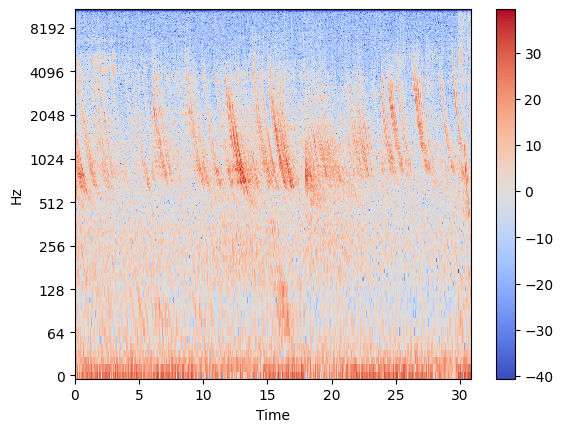

In [306]:
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()

In [307]:
import sklearn
spectral_centroids = librosa.feature.spectral_centroid(y=x, sr=sr)[0]
spectral_centroids.shape
# # Computing the time variable for visualization
# plt.figure(figsize=(12, 4))frames = range(len(spectral_centroids))
# t = librosa.frames_to_time(frames)
# # Normalising the spectral centroid for visualisation
# def normalize(x, axis=0):
#     return sklearn.preprocessing.minmax_scale(x, axis=axis)
# #Plotting the Spectral Centroid along the waveform
# librosa.display.waveplot(x, sr=sr, alpha=0.4)
# plt.plot(t, normalize(spectral_centroids), color='b')

(1331,)

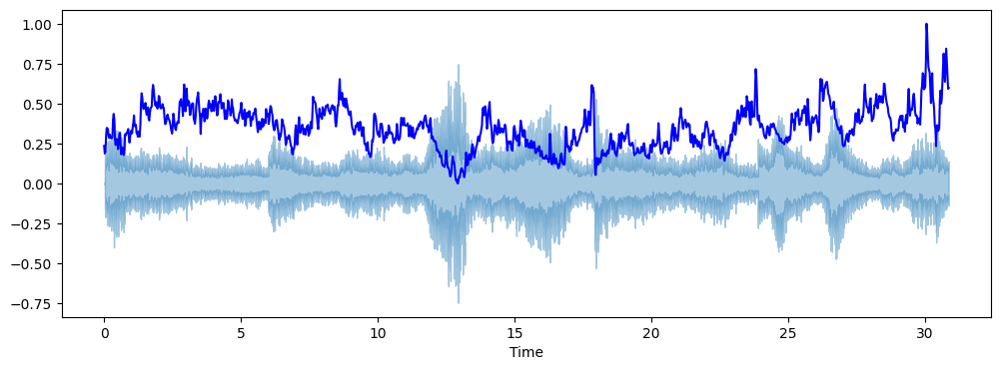

In [308]:
plt.figure(figsize=(12, 4))
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='b')

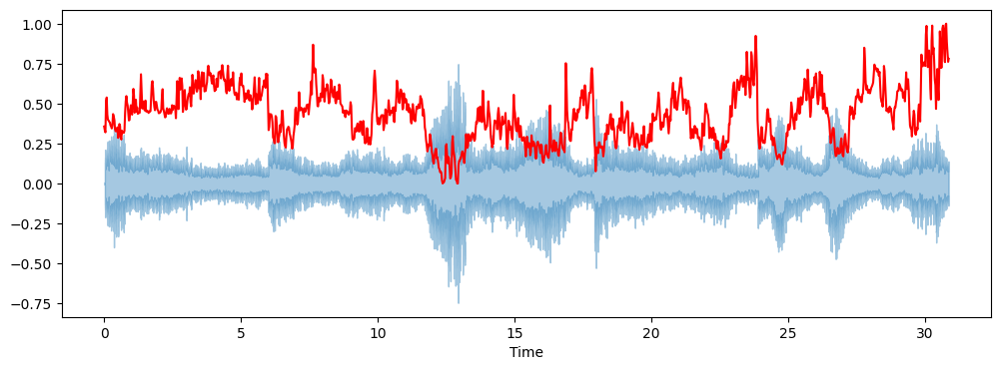

In [309]:
spectral_rolloff = librosa.feature.spectral_rolloff(y=x+0.01, sr=sr)[0]
plt.figure(figsize=(12, 4))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='r')

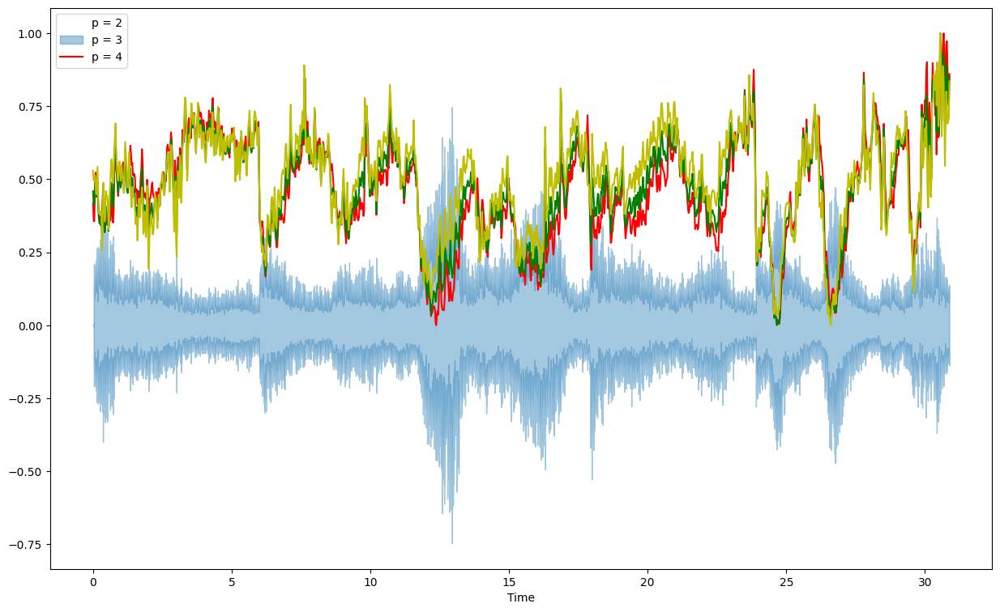

In [310]:
spectral_bandwidth_2 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr)[0]
spectral_bandwidth_3 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=3)[0]
spectral_bandwidth_4 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=4)[0]
plt.figure(figsize=(15, 9))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_bandwidth_2), color='r')
plt.plot(t, normalize(spectral_bandwidth_3), color='g')
plt.plot(t, normalize(spectral_bandwidth_4), color='y')
plt.legend(('p = 2', 'p = 3', 'p = 4'))

In [311]:
mfccs = librosa.feature.mfcc(y=x, sr=sr)
print(mfccs.shape)


(20, 1331)


In [312]:
mfccs

array([[-2.78617310e+02, -1.44903198e+02, -1.10869736e+02, ...,
        -1.19934502e+02, -1.22812416e+02, -1.50585541e+02],
       [ 9.61987457e+01,  1.04695816e+02,  1.05462845e+02, ...,
         4.53885193e+01,  4.89740028e+01,  5.30149384e+01],
       [-2.49514122e+01, -2.85955009e+01, -3.15091476e+01, ...,
        -1.39072728e+00, -3.19638014e+00, -5.48904181e+00],
       ...,
       [-1.75661802e-01, -2.42136335e+00, -6.63303089e+00, ...,
         1.15198412e+01,  6.10302687e+00,  4.33413148e-01],
       [-1.01249099e+00,  4.41004801e+00,  1.04450493e+01, ...,
        -1.74430072e+00,  6.69697642e-01,  5.18314266e+00],
       [ 1.06407452e+01,  1.02645569e+01,  1.04409599e+01, ...,
        -6.73161316e+00, -4.90991211e+00, -3.40643549e+00]], dtype=float32)

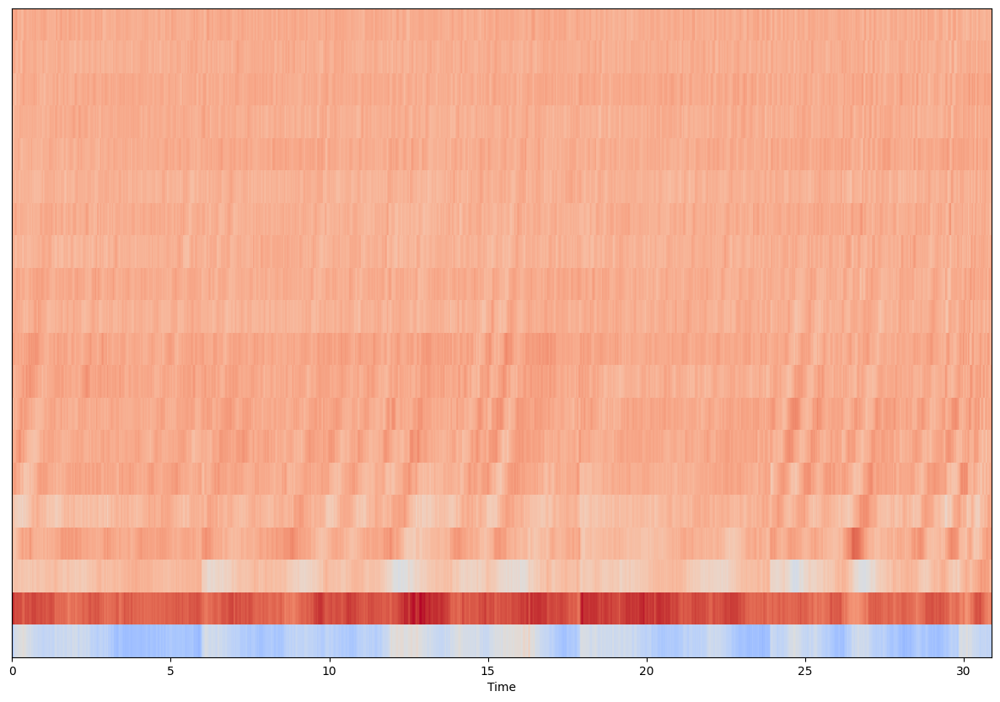

In [313]:
#Displaying  the MFCCs:
plt.figure(figsize=(15, 10))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

### Step 2: Compute Mel-Scaled Spectrogram
The Mel scale is a perceptual scale of pitches judged by listeners to be equal in distance from one another. The reference point between this scale and normal frequency measurement is defined by assigning a perceptual pitch of 1000 mels to a 1000 Hz tone, 40 dB above the listener's threshold.

This scale is used in speech and music processing, particularly for voice recognition, because it approximates human hearing much more closely than the linear frequency scale.

Now, we will compute a Mel-scaled spectrogram for the same audio file.

This process involves converting the conventional frequency scale into the Mel scale, which correlates better with human auditory perception.

In [314]:
y, sr = librosa.load(audio_data)
librosa.feature.melspectrogram(y=y, sr=sr)

array([[1.1427849e-01, 1.1176665e+00, 1.0281992e+00, ..., 5.8710055e+00,
        1.1639396e+01, 1.1991383e+01],
       [6.7488983e-02, 2.9396892e-01, 3.0430901e-01, ..., 2.3656297e-01,
        4.5493469e-01, 8.0710125e-01],
       [6.4815909e-02, 5.9949040e-01, 5.3416842e-01, ..., 1.6362582e-01,
        2.9034302e-01, 5.1595622e-01],
       ...,
       [3.6953839e-05, 9.0219820e-04, 2.5563613e-03, ..., 2.2244595e-02,
        2.7351115e-02, 5.9368834e-02],
       [3.1750376e-05, 6.9928402e-04, 1.5336535e-03, ..., 7.5041791e-03,
        5.9854579e-03, 8.7471753e-03],
       [3.0646386e-06, 8.4065927e-05, 1.4160994e-04, ..., 1.4233498e-03,
        8.1233826e-04, 7.9717103e-04]], dtype=float32)

In [315]:
S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128,
                                    fmax=8000)

[Text(0.5, 1.0, 'Mel-frequency spectrogram')]

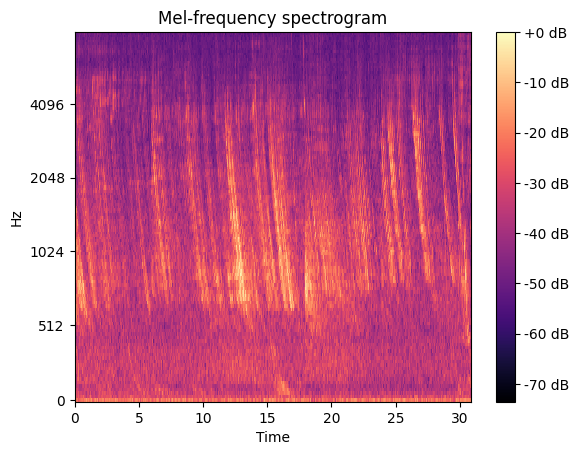

In [316]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
S_dB = librosa.power_to_db(S, ref=np.max)
img = librosa.display.specshow(S_dB, x_axis='time',
                         y_axis='mel', sr=sr,
                         fmax=8000, ax=ax)
fig.colorbar(img, ax=ax, format='%+2.0f dB')
ax.set(title='Mel-frequency spectrogram')

### Step 3: Short-Time Fourier Transform (STFT)

The Short-Time Fourier Transform (STFT) analyzes the frequency content of a signal over time by applying the Fourier Transform to overlapping short segments or windows of the signal. This produces a time-frequency representation called a spectrogram. The window length determines a trade-off: longer windows provide better frequency resolution but worse time resolution, and vice versa. Commonly used in audio and speech processing, the STFT reveals how the signal's frequency components evolve over time.


In [317]:
y, sr = librosa.load(audio_data)
S = np.abs(librosa.stft(y))
S

array([[1.3394426e+00, 4.7157087e+00, 6.3030782e+00, ..., 3.5962654e+01,
        3.8128712e+01, 2.5476608e+01],
       [1.3006734e+00, 4.2894859e+00, 2.6520152e+00, ..., 1.6706104e+01,
        2.2858936e+01, 2.1032970e+01],
       [1.1907251e+00, 3.8209174e+00, 3.3330772e+00, ..., 5.3803830e+00,
        9.1114092e+00, 1.1548626e+01],
       ...,
       [9.8703640e-07, 6.2666675e-07, 1.1696485e-06, ..., 1.2361945e-05,
        4.7753579e-03, 1.0914091e-02],
       [3.0419488e-07, 8.2641714e-07, 1.6822645e-06, ..., 1.4901629e-05,
        4.7701504e-03, 1.0896713e-02],
       [2.5650178e-07, 3.7579073e-07, 1.2452151e-06, ..., 1.4188138e-05,
        4.7690105e-03, 1.0900837e-02]], dtype=float32)

In [318]:
S_left = librosa.stft(y, center=False)

In [319]:
D_short = librosa.stft(y, hop_length=64)

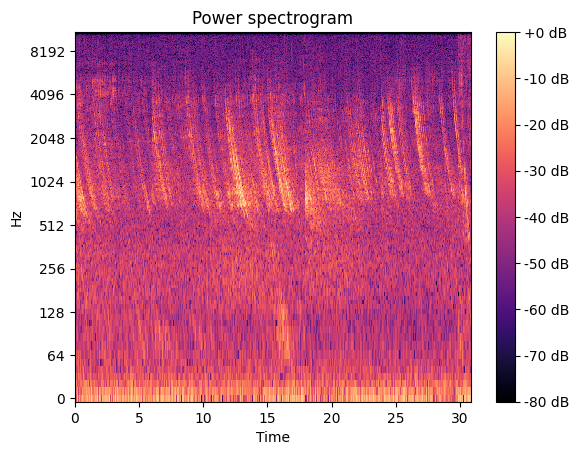

In [320]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
img = librosa.display.specshow(
    librosa.amplitude_to_db(S,ref=np.max),
    y_axis='log',
    x_axis='time',
    ax=ax
    )
ax.set_title('Power spectrogram')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

### Step 4: Beat Tracker

The `librosa` beat tracker detects the rhythmic pulse or "beats" in an audio signal. By analyzing the onset strength of a signal, which corresponds to sudden changes or events in the audio, it determines the timing of beats. Beat tracking is essential for various music analysis tasks, such as tempo estimation, rhythm analysis, and synchronization. In applications like DJ software, automatic music tagging, or dance choreography, the detected beats can be used to align tracks, categorize music, or coordinate movements to the rhythm.


In [321]:
y, sr = librosa.load(audio_data)

In [322]:
tempo, beats = librosa.beat.beat_track(y=y, sr=sr)

In [323]:
tempo

143.5546875

In [324]:
beats

array([   3,   22,   40,   59,   77,   94,  111,  128,  147,  166,  184,
        203,  221,  239,  257,  274,  292,  309,  327,  345,  364,  383,
        401,  419,  436,  453,  470,  488,  505,  522,  540,  558,  576,
        594,  614,  633,  651,  668,  685,  703,  721,  738,  756,  774,
        793,  812,  831,  849,  868,  886,  904,  922,  940,  957,  976,
        994, 1014, 1031, 1051, 1071, 1090, 1108, 1125, 1143, 1162, 1180,
       1199, 1218, 1235, 1252, 1270, 1288])

In [325]:
onset_env = librosa.onset.onset_strength(y=y, sr=sr,
                                         aggregate=np.median)
tempo, beats = librosa.beat.beat_track(onset_envelope=onset_env,
                                       sr=sr)

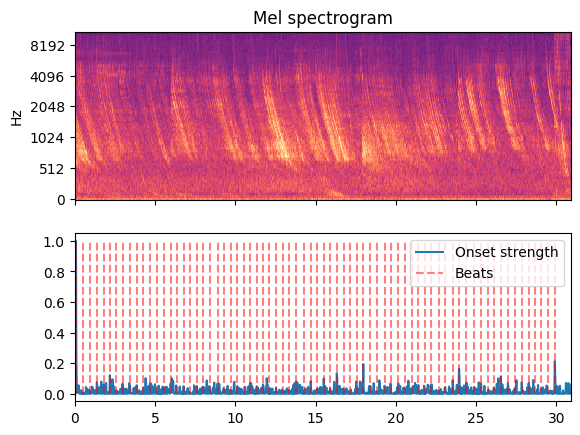

In [326]:
import matplotlib.pyplot as plt
hop_length = 512
fig, ax = plt.subplots(nrows=2, sharex=True)
times = librosa.times_like(onset_env, sr=sr, hop_length=hop_length)
M = librosa.feature.melspectrogram(y=y, sr=sr, hop_length=hop_length)
librosa.display.specshow(librosa.power_to_db(M, ref=np.max),
                         y_axis='mel', x_axis='time', hop_length=hop_length,
                         ax=ax[0])
ax[0].label_outer()
ax[0].set(title='Mel spectrogram')
ax[1].plot(times, librosa.util.normalize(onset_env),
         label='Onset strength')
ax[1].vlines(times[beats], 0, 1, alpha=0.5, color='r',
           linestyle='--', label='Beats')
ax[1].legend()

### Step 5: Compute Constant-Q Transform of Audio Signal

The Constant Q Transform (CQT) in librosa provides a time-frequency representation of an audio signal where the frequency bins are geometrically spaced. Unlike the linear spacing of the Short-Time Fourier Transform (STFT), the CQT's spacing mirrors the logarithmic perception of pitch in human hearing. This makes the CQT especially useful for musical analysis. In the CQT, the "Q-factor" (a ratio of the center frequency to bandwidth) remains constant across all frequencies, ensuring that each frequency bin has consistent resolution. When visualized, harmonics of musical notes align vertically in a CQT spectrogram, making it valuable for studying harmonic structures. In librosa, the cqt function efficiently computes this representation.

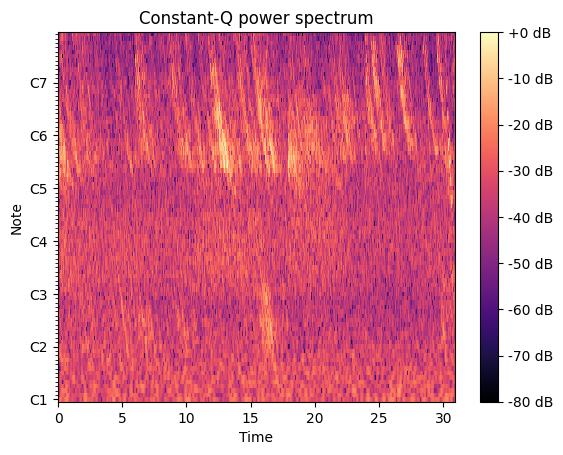

In [327]:
import matplotlib.pyplot as plt
y, sr = librosa.load(audio_data)
C = np.abs(librosa.cqt(y, sr=sr))
fig, ax = plt.subplots()
img = librosa.display.specshow(librosa.amplitude_to_db(C, ref=np.max),
                               sr=sr, x_axis='time', y_axis='cqt_note', ax=ax)
ax.set_title('Constant-Q power spectrum')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

In [328]:
print("The Constant-Q Transform of the Audio Signal is:")
print(C)

The Constant-Q Transform of the Audio Signal is:
[[1.12342171e-01 1.26050785e-01 1.41324878e-01 ... 3.96985412e-02
  4.78066504e-02 5.10550216e-02]
 [5.74341454e-02 5.51969558e-02 4.76815887e-02 ... 1.22214049e-01
  1.06365308e-01 9.16096270e-02]
 [3.79978456e-02 3.57552432e-02 3.49348150e-02 ... 1.14328533e-01
  8.96695703e-02 6.80020228e-02]
 ...
 [1.75899277e-08 4.90780035e-03 2.36993097e-02 ... 2.74629816e-02
  2.47025415e-02 5.98562099e-02]
 [1.13214265e-08 2.26041907e-03 1.79751385e-02 ... 1.00756176e-02
  1.59046482e-02 6.12920672e-02]
 [4.27971329e-08 3.49752163e-03 1.21977665e-02 ... 4.68980074e-02
  4.12406325e-02 2.28718948e-02]]


## KIC7671081B

### Setup

In [329]:
current_file = KIC7671081B_file_path

In [330]:
audio_data = current_file
x , sr = librosa.load(audio_data)
print(type(x), type(sr))
print(x.shape, sr)

<class 'numpy.ndarray'> <class 'int'>
(454054,) 22050


In [331]:
librosa.load(audio_data, sr=44100)

(array([ 1.5868711e-09,  6.4384622e-09, -6.2616473e-10, ...,
         4.0395800e-03,  3.1455609e-03,  0.0000000e+00], dtype=float32),
 44100)

In [332]:
import IPython.display as ipd
ipd.Audio(audio_data)

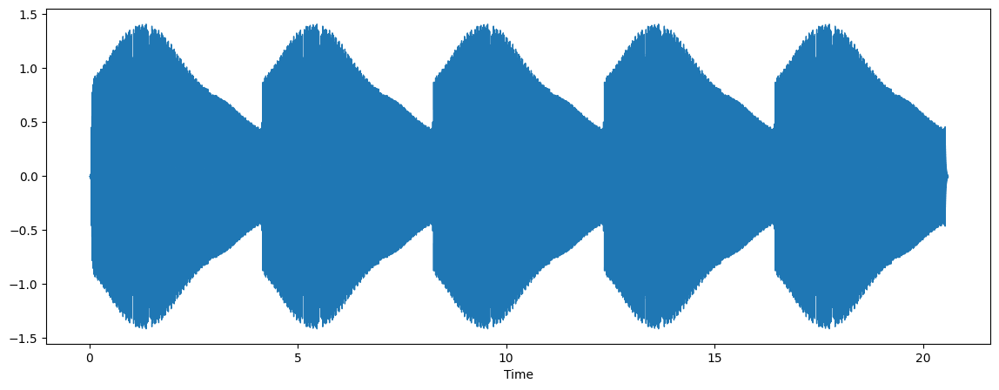

In [333]:
%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display
plt.figure(figsize=(14, 5))
librosa.display.waveshow(x, sr=sr)

In [334]:
# Build a simple chroma filter bank
chromafb = librosa.filters.chroma(sr=22050, n_fft=4096)

chromafb

array([[1.70601543e-05, 2.82992725e-04, 1.03555294e-03, ...,
        5.23030704e-21, 4.43047226e-21, 3.75236833e-21],
       [1.66987356e-05, 3.18591396e-04, 1.46405352e-03, ...,
        1.25662976e-13, 1.10109757e-13, 9.64649842e-14],
       [1.61444223e-05, 3.48842266e-04, 1.90847355e-03, ...,
        5.52980168e-08, 5.01214537e-08, 4.54209257e-08],
       ...,
       [1.68931711e-05, 3.02419503e-04, 1.25730084e-03, ...,
        4.03871397e-17, 4.63902409e-17, 5.32694454e-17],
       [1.71591892e-05, 2.65152019e-04, 8.56101280e-04, ...,
        2.25072222e-25, 2.67424414e-25, 3.17644285e-25],
       [1.72155414e-05, 2.44485302e-04, 6.75355259e-04, ...,
        3.98721026e-30, 3.26509862e-30, 2.67339596e-30]], dtype=float32)

In [335]:
# Use quarter-tones instead of semitones
librosa.filters.chroma(sr=22050, n_fft=4096, n_chroma=24)

array([[1.2062923e-05, 2.0009540e-04, 7.3222251e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.1952894e-05, 2.1304651e-04, 8.7951310e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.1807369e-05, 2.2526611e-04, 1.0352081e-03, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       ...,
       [1.2171624e-05, 1.7373025e-04, 4.8452709e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.2172794e-05, 1.7286799e-04, 4.7753262e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.2136448e-05, 1.8663100e-04, 5.9735152e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00]], dtype=float32)

In [336]:
# Equally weight all octaves
librosa.filters.chroma(sr=22050, n_fft=4096, octwidth=None)

array([[3.06632757e-01, 2.43654341e-01, 1.60742402e-01, ...,
        2.75466492e-20, 2.33491276e-20, 1.97881458e-20],
       [3.00136745e-01, 2.74304509e-01, 2.27255851e-01, ...,
        6.61833761e-13, 5.80291837e-13, 5.08708906e-13],
       [2.90173739e-01, 3.00350249e-01, 2.96240419e-01, ...,
        2.91240070e-07, 2.64146166e-07, 2.39527623e-07],
       ...,
       [3.03631455e-01, 2.60380656e-01, 1.95162937e-01, ...,
        2.12708409e-16, 2.44482217e-16, 2.80916862e-16],
       [3.08412760e-01, 2.28293657e-01, 1.32887244e-01, ...,
        1.18539604e-24, 1.40935927e-24, 1.67509979e-24],
       [3.09425622e-01, 2.10499778e-01, 1.04831174e-01, ...,
        2.09995848e-29, 1.72074678e-29, 1.40981758e-29]], dtype=float32)

### Step 1: Display Spectrogram, Chromogram, and CQT

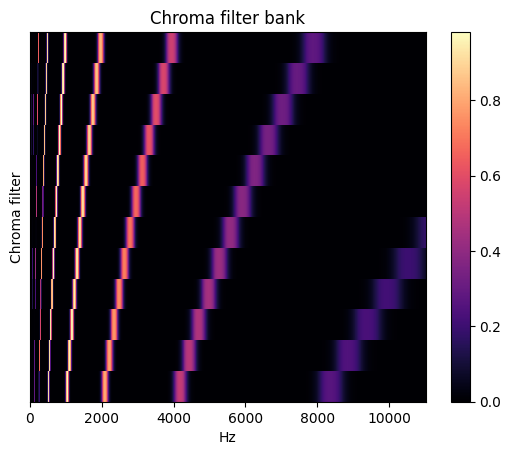

In [337]:
#https://librosa.org/doc-playground/main/generated/librosa.filters.chroma.html?highlight=chroma#librosa.filters.chroma
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
img = librosa.display.specshow(chromafb, x_axis='linear', ax=ax)
ax.set(ylabel='Chroma filter', title='Chroma filter bank')
fig.colorbar(img, ax=ax)


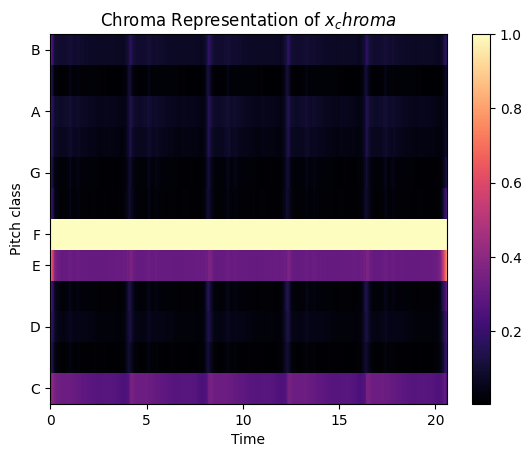

In [338]:
#https://librosa.org/doc-playground/main/auto_examples/plot_music_sync.html?highlight=chroma

# Extract Chroma Features

hop_length = 1024

x_chroma = librosa.feature.chroma_cqt(y=x, sr=sr,
                                         hop_length=hop_length)

fig, ax = plt.subplots(nrows=1, sharey=True)
img = librosa.display.specshow(x_chroma, x_axis='time',
                               y_axis='chroma',
                               hop_length=hop_length, ax=ax)
ax.set(title='Chroma Representation of $x_chroma$')
fig.colorbar(img, ax=ax)

In [339]:
#https://librosa.org/doc-playground/main/generated/librosa.feature.chroma_stft.html?highlight=ibrosa%20feature%20chroma_stft#librosa.feature.chroma_stft
#Energy
librosa.feature.chroma_stft(y=x, sr=sr)

array([[0.98678404, 1.        , 0.8762513 , ..., 0.58849585, 0.8497148 ,
        0.73142534],
       [0.96368575, 0.75981694, 0.66604835, ..., 0.642173  , 0.8829525 ,
        0.8241016 ],
       [0.9117428 , 0.7144738 , 0.67368484, ..., 0.7204063 , 0.92830575,
        0.9043823 ],
       ...,
       [0.9525556 , 0.73937756, 0.5925222 , ..., 0.44393933, 0.8629941 ,
        0.78075945],
       [0.9344758 , 0.8572534 , 0.61532223, ..., 0.4180444 , 0.8121715 ,
        0.7040912 ],
       [0.9384014 , 0.96628374, 0.7256243 , ..., 0.464583  , 0.7789609 ,
        0.6307637 ]], dtype=float32)

In [340]:
# Use an energy (magnitude) spectrum instead of power spectrogram
S = np.abs(librosa.stft(x))
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
chroma

array([[0.9990277 , 1.        , 1.        , ..., 0.87629676, 0.97832155,
        0.90926677],
       [1.        , 0.8966038 , 0.853927  , ..., 0.9081031 , 0.9775356 ,
        0.95153165],
       [0.97519577, 0.87979   , 0.8409543 , ..., 0.87292784, 0.9698786 ,
        0.9901047 ],
       ...,
       [0.9739226 , 0.94480735, 0.915363  , ..., 0.80402017, 1.        ,
        0.90890765],
       [0.9742544 , 0.9259232 , 0.85382026, ..., 0.7769785 , 0.9904456 ,
        0.9026484 ],
       [0.9695014 , 0.94563735, 0.8935383 , ..., 0.7742858 , 0.96958625,
        0.88933057]], dtype=float32)

In [341]:
# Use an energy (magnitude) spectrum instead of power spectrogram
S = np.abs(librosa.stft(x))
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
chroma

array([[0.9990277 , 1.        , 1.        , ..., 0.87629676, 0.97832155,
        0.90926677],
       [1.        , 0.8966038 , 0.853927  , ..., 0.9081031 , 0.9775356 ,
        0.95153165],
       [0.97519577, 0.87979   , 0.8409543 , ..., 0.87292784, 0.9698786 ,
        0.9901047 ],
       ...,
       [0.9739226 , 0.94480735, 0.915363  , ..., 0.80402017, 1.        ,
        0.90890765],
       [0.9742544 , 0.9259232 , 0.85382026, ..., 0.7769785 , 0.9904456 ,
        0.9026484 ],
       [0.9695014 , 0.94563735, 0.8935383 , ..., 0.7742858 , 0.96958625,
        0.88933057]], dtype=float32)

In [342]:
# Use a pre-computed power spectrogram with a larger frame
S = np.abs(librosa.stft(x, n_fft=4096))**2
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
chroma

array([[1.        , 0.6427941 , 0.48483643, ..., 0.25305456, 0.3391815 ,
        0.69407666],
       [0.7270594 , 0.31467408, 0.1763833 , ..., 0.11904071, 0.27684426,
        0.76333386],
       [0.67693436, 0.18495004, 0.03261527, ..., 0.03440254, 0.23044515,
        0.7765647 ],
       ...,
       [0.76408064, 0.2927245 , 0.15075676, ..., 0.01610347, 0.07449806,
        0.54066557],
       [0.8250919 , 0.18701826, 0.03244078, ..., 0.01063122, 0.0819602 ,
        0.5327648 ],
       [0.99833405, 0.42161494, 0.15565725, ..., 0.08775771, 0.19573228,
        0.596085  ]], dtype=float32)

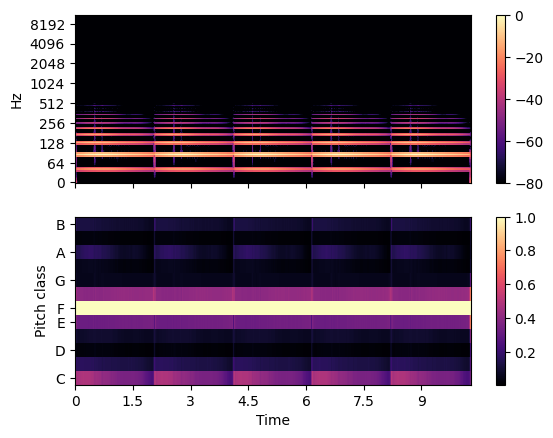

In [343]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(nrows=2, sharex=True)
img = librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),
                               y_axis='log', x_axis='time', ax=ax[0])
fig.colorbar(img, ax=[ax[0]])
ax[0].label_outer()
img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax[1])
fig.colorbar(img, ax=[ax[1]])

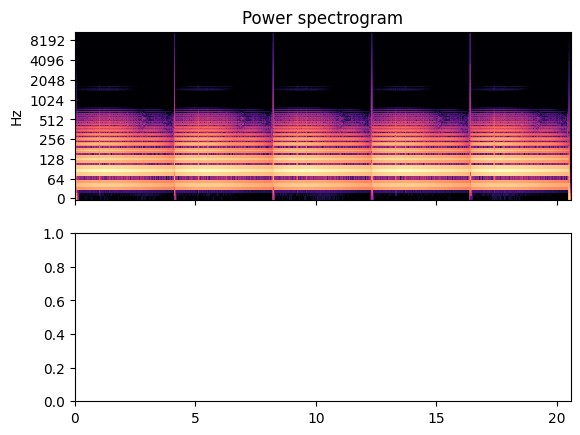

In [344]:
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()

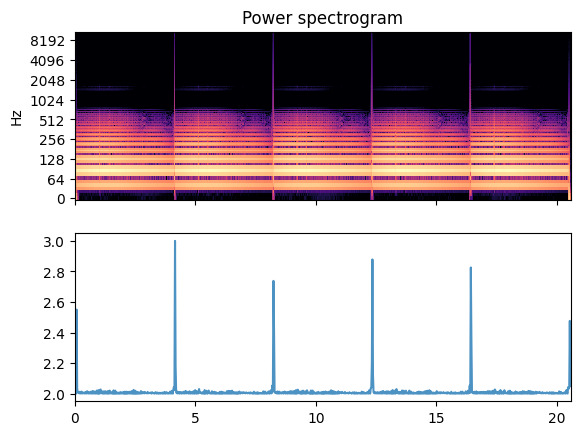

In [345]:
# Construct a standard onset function
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()
onset_env = librosa.onset.onset_strength(y=x, sr=sr)
ax[1].plot(times, 2 + onset_env / onset_env.max(), alpha=0.8,
           label='Mean (mel)')

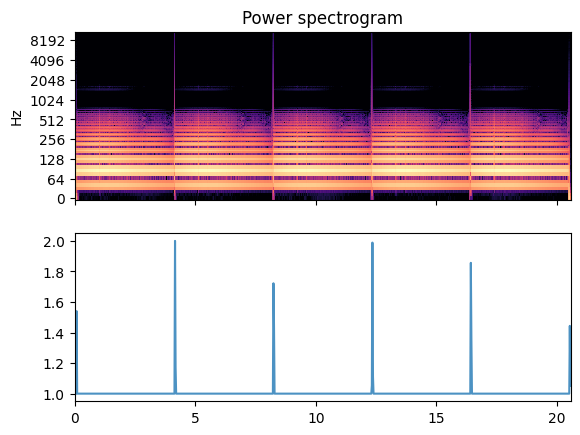

In [346]:
# Median aggregation, and custom mel options
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()

onset_env = librosa.onset.onset_strength(y=x, sr=sr,
                                         aggregate=np.median,
                                         fmax=8000, n_mels=256)
ax[1].plot(times, 1 + onset_env / onset_env.max(), alpha=0.8,
           label='Median (custom mel)')


[Text(0, 0.5, 'Normalized strength'), []]

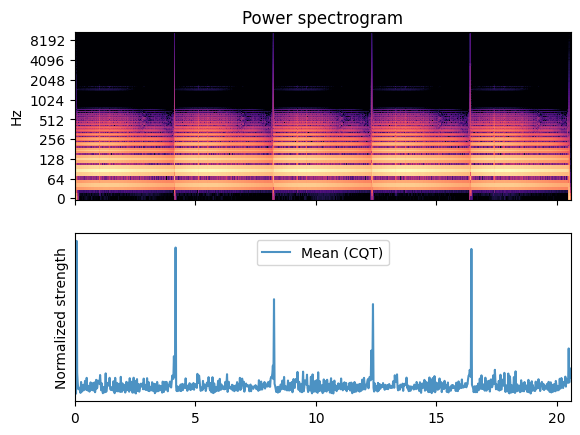

In [347]:
# Constant-Q spectrogram instead of Mel
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()


C = np.abs(librosa.cqt(y=x, sr=sr))
onset_env = librosa.onset.onset_strength(sr=sr, S=librosa.amplitude_to_db(C, ref=np.max))
ax[1].plot(times, onset_env / onset_env.max(), alpha=0.8,
         label='Mean (CQT)')
ax[1].legend()
ax[1].set(ylabel='Normalized strength', yticks=[])


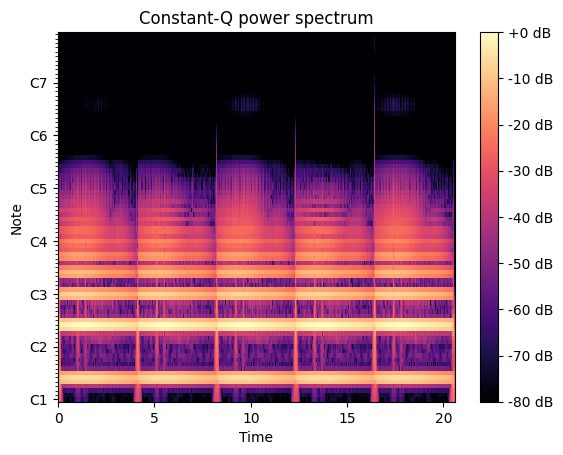

In [348]:
C = np.abs(librosa.cqt(x, sr=sr))
fig, ax = plt.subplots()
img = librosa.display.specshow(librosa.amplitude_to_db(C, ref=np.max),
                               sr=sr, x_axis='time', y_axis='cqt_note', ax=ax)
ax.set_title('Constant-Q power spectrum')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

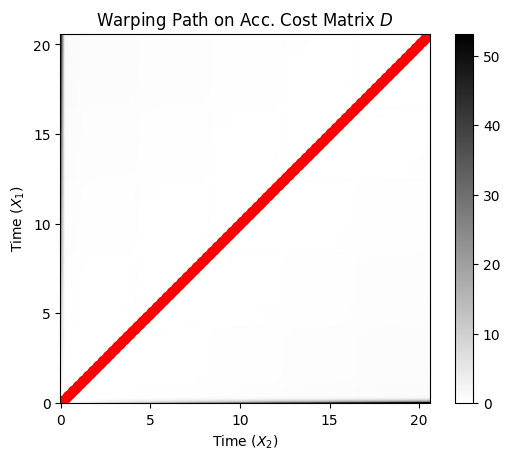

In [349]:
D, wp = librosa.sequence.dtw(X=x_chroma,Y=x_chroma, metric='cosine')
wp_s = librosa.frames_to_time(wp, sr=sr, hop_length=hop_length)

fig, ax = plt.subplots()
img = librosa.display.specshow(D, x_axis='time', y_axis='time', sr=sr,
                               cmap='gray_r', hop_length=hop_length, ax=ax)
ax.plot(wp_s[:, 1], wp_s[:, 0], marker='o', color='r')
ax.set(title='Warping Path on Acc. Cost Matrix $D$',
       xlabel='Time $(X_2)$', ylabel='Time $(X_1)$')
fig.colorbar(img, ax=ax)


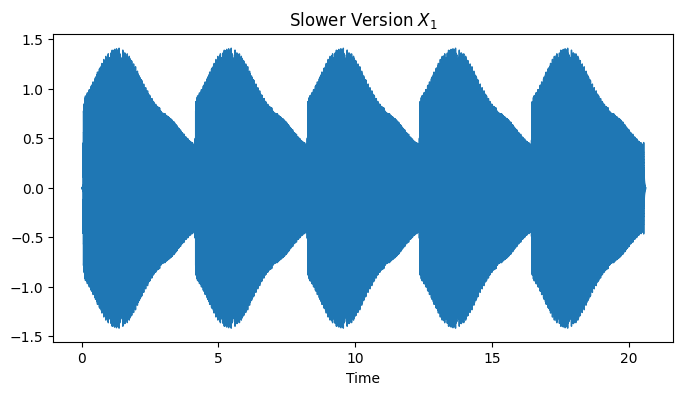

In [350]:
#Alternative Visualization in the Time Domain
fig, ax1 = plt.subplots(nrows=1, sharex=True, sharey=True, figsize=(8, 4))

# Plot x_1
librosa.display.waveshow(x, sr=sr, ax=ax1)
ax1.set(title='Slower Version $X_1$')
ax1.label_outer()


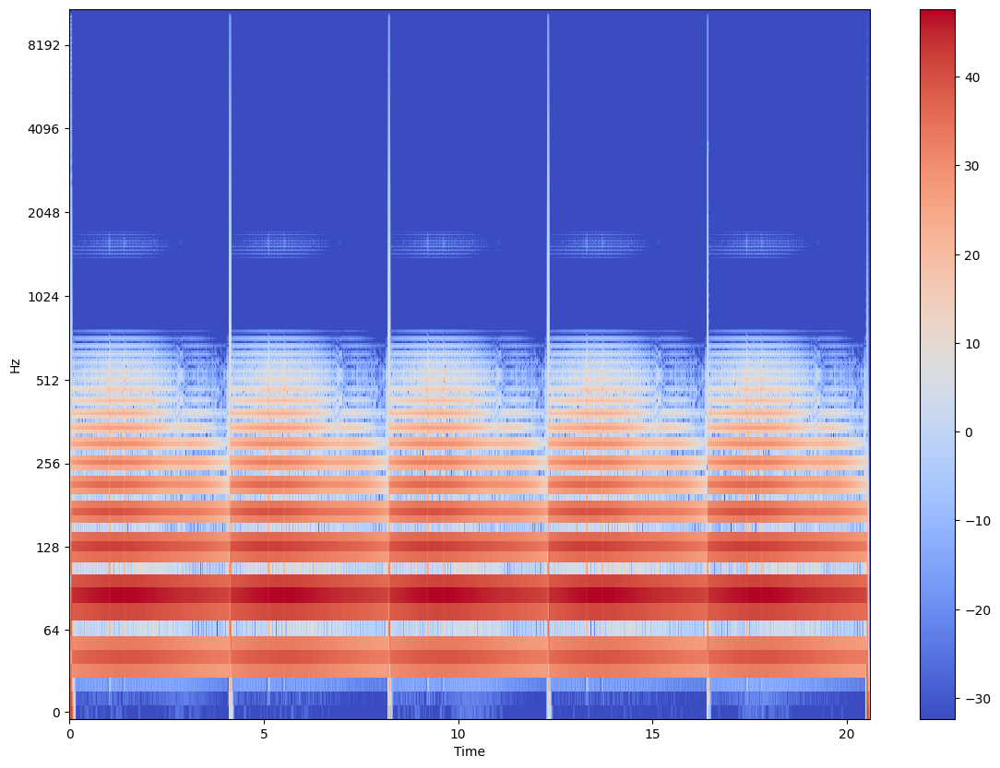

In [351]:
# Spectrogram
import matplotlib.pyplot as plt
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 10))

librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()

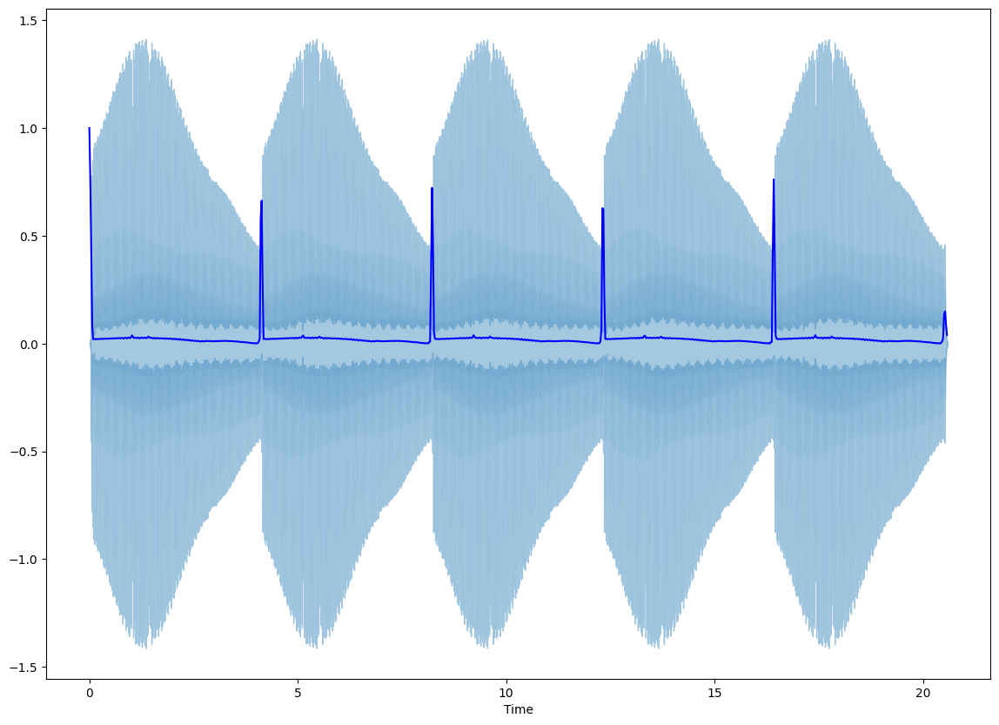

In [352]:
# Spectral Centroid
import sklearn
from sklearn import preprocessing
#https://zhuanlan.zhihu.com/p/144922679
#labelEncoder= preprocessing.LabelEncoder()

spectral_centroids = librosa.feature.spectral_centroid(y=x, sr=sr)[0]
spectral_centroids.shape
plt.figure(figsize=(14, 10))
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='b')

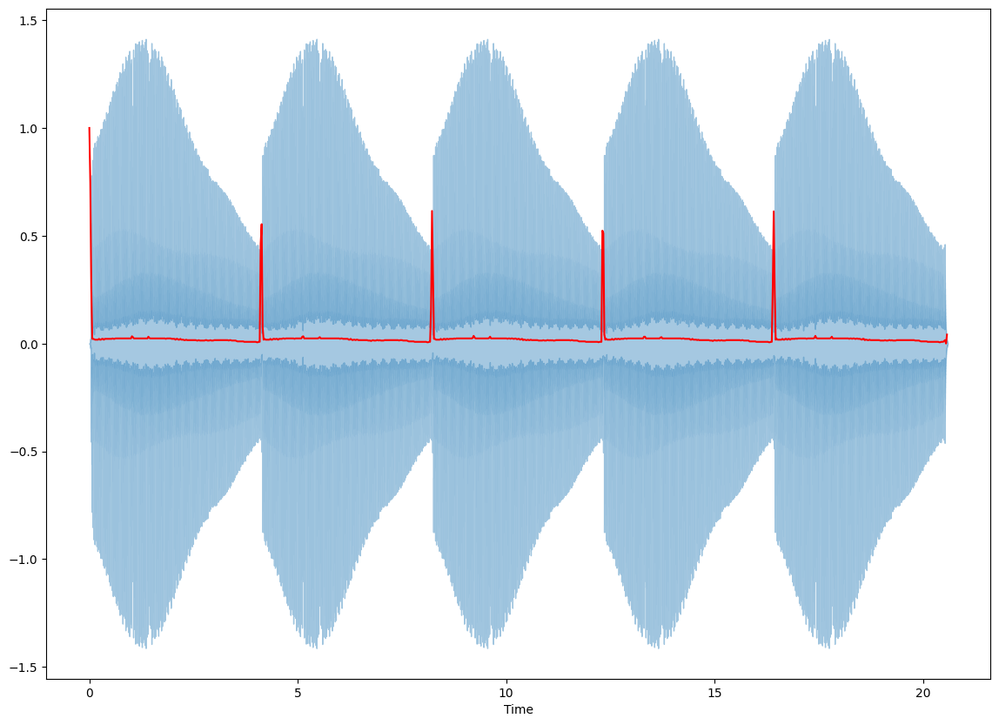

In [353]:
# Spectral Rolloff
spectral_rolloff = librosa.feature.spectral_rolloff(y=x+0.01, sr=sr)[0]
plt.figure(figsize=(14, 10))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='r')

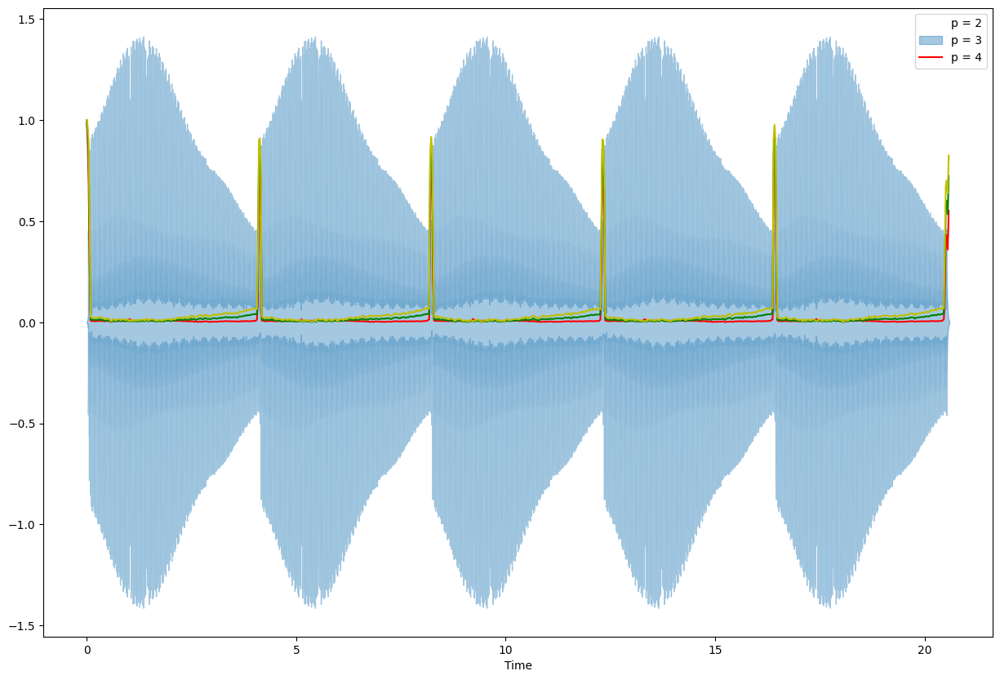

In [354]:
# Spectral Bandwidth
spectral_bandwidth_2 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr)[0]
spectral_bandwidth_3 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=3)[0]
spectral_bandwidth_4 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=4)[0]
plt.figure(figsize=(15, 10))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_bandwidth_2), color='r')
plt.plot(t, normalize(spectral_bandwidth_3), color='g')
plt.plot(t, normalize(spectral_bandwidth_4), color='y')
plt.legend(('p = 2', 'p = 3', 'p = 4'))

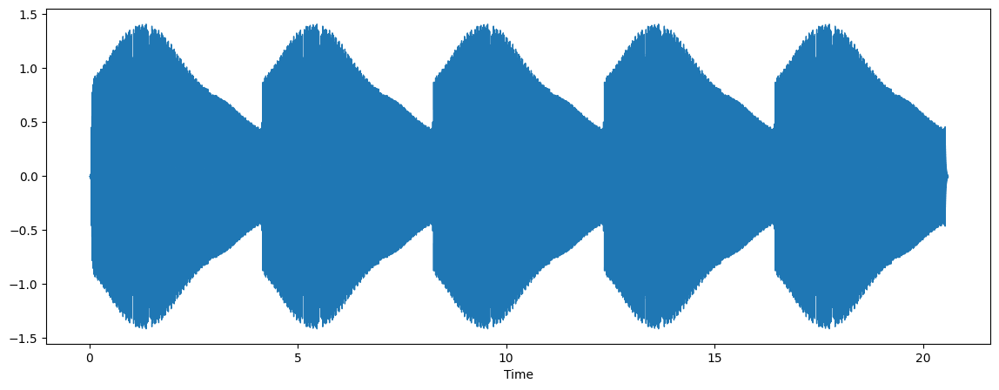

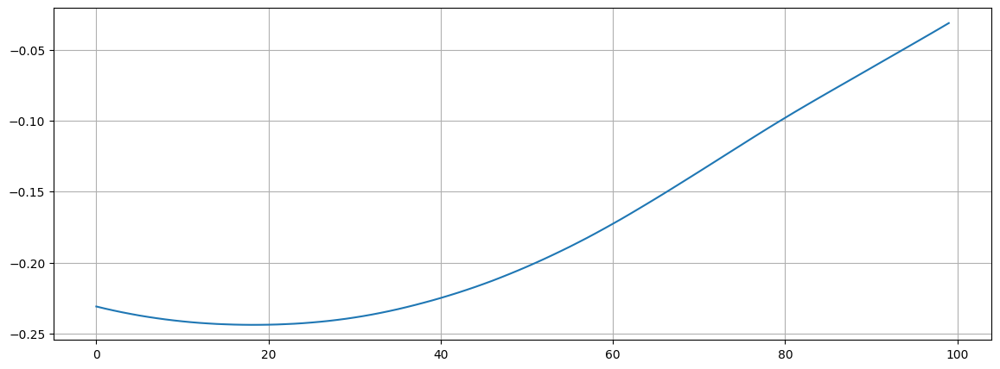

In [355]:
# Zero-Crossing Rate
x, sr = librosa.load(audio_data)
#Plot the signal:
plt.figure(figsize=(14, 5))
librosa.display.waveshow(x, sr=sr)
# Zooming in
n0 = 9000
n1 = 9100
plt.figure(figsize=(14, 5))
plt.plot(x[n0:n1])
plt.grid()

In [356]:
zero_crossings = librosa.zero_crossings(x[n0:n1], pad=False)
print(sum(zero_crossings))

0


(20, 887)


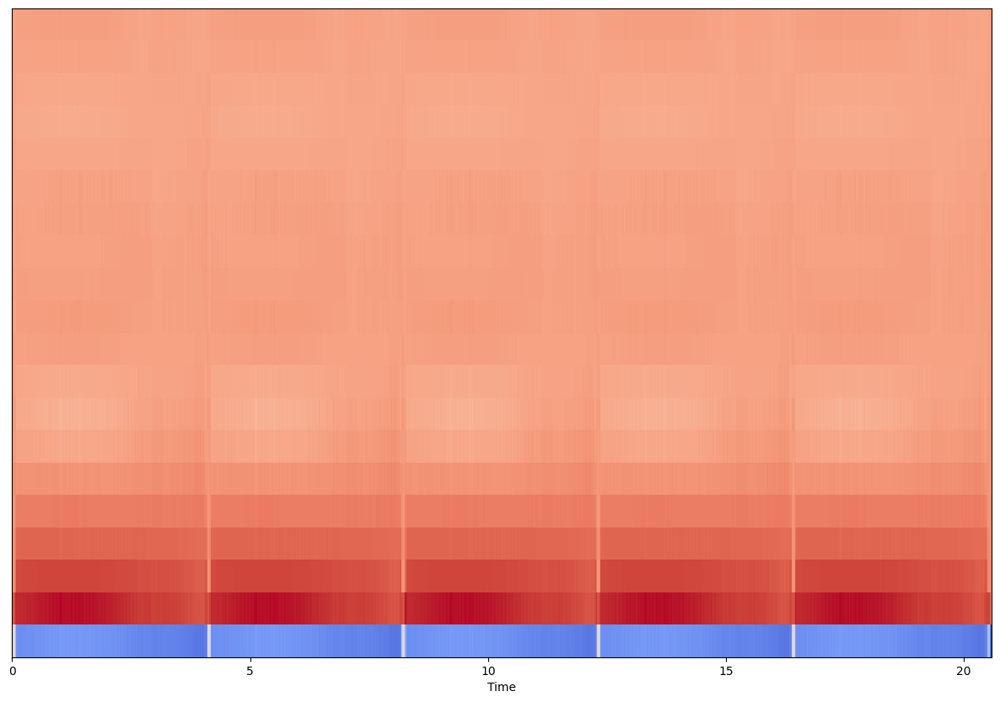

In [357]:
mfccs = librosa.feature.mfcc(y=x, sr=sr)
print(mfccs.shape)
plt.figure(figsize=(15, 10))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

In [358]:
librosa.load(audio_data, sr=44100)

(array([ 1.5868711e-09,  6.4384622e-09, -6.2616473e-10, ...,
         4.0395800e-03,  3.1455609e-03,  0.0000000e+00], dtype=float32),
 44100)

In [359]:
ipd.Audio(audio_data)

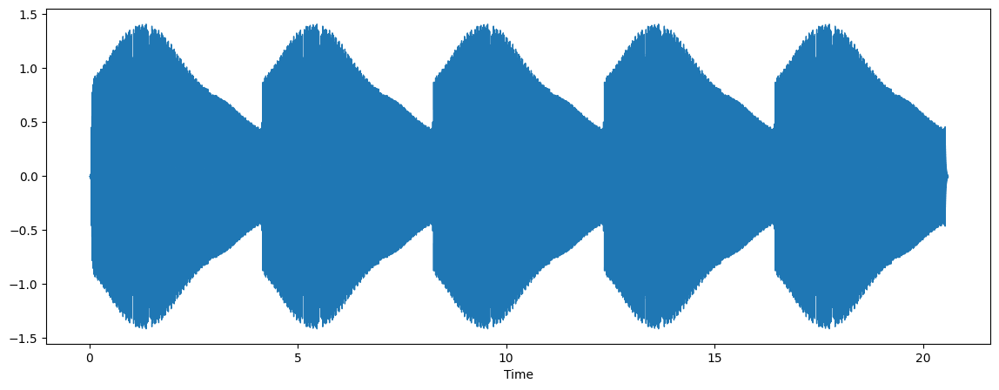

In [360]:
%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display
plt.figure(figsize=(14, 5))
librosa.display.waveshow(x, sr=sr)

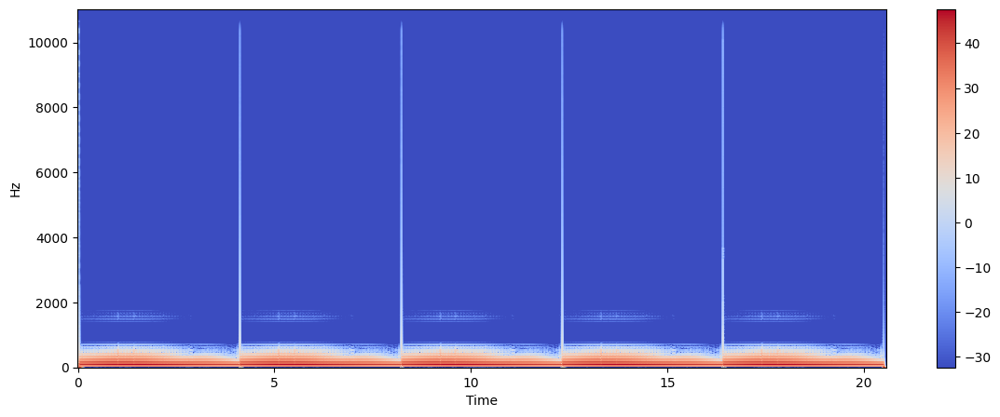

In [361]:
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()

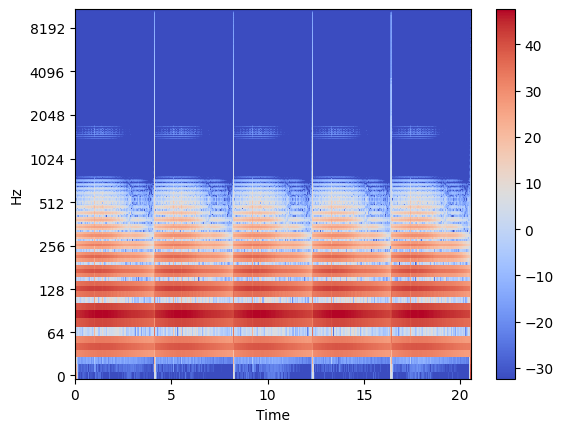

In [362]:
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()

In [363]:
import sklearn
spectral_centroids = librosa.feature.spectral_centroid(y=x, sr=sr)[0]
spectral_centroids.shape
# # Computing the time variable for visualization
# plt.figure(figsize=(12, 4))frames = range(len(spectral_centroids))
# t = librosa.frames_to_time(frames)
# # Normalising the spectral centroid for visualisation
# def normalize(x, axis=0):
#     return sklearn.preprocessing.minmax_scale(x, axis=axis)
# #Plotting the Spectral Centroid along the waveform
# librosa.display.waveplot(x, sr=sr, alpha=0.4)
# plt.plot(t, normalize(spectral_centroids), color='b')

(887,)

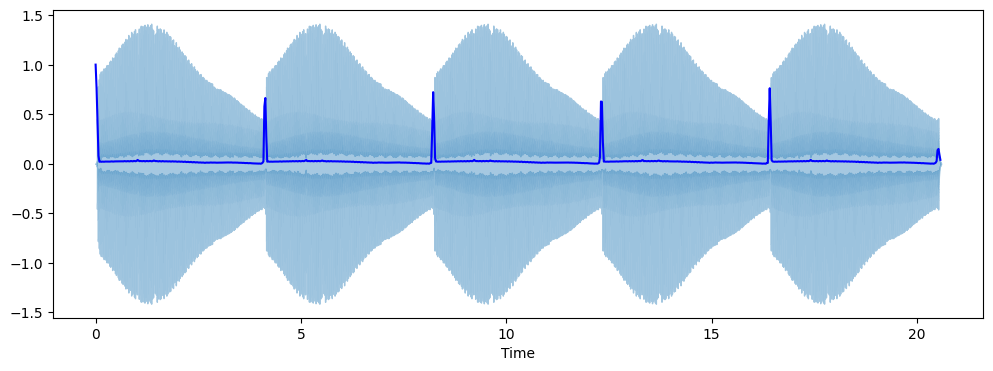

In [364]:
plt.figure(figsize=(12, 4))
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='b')

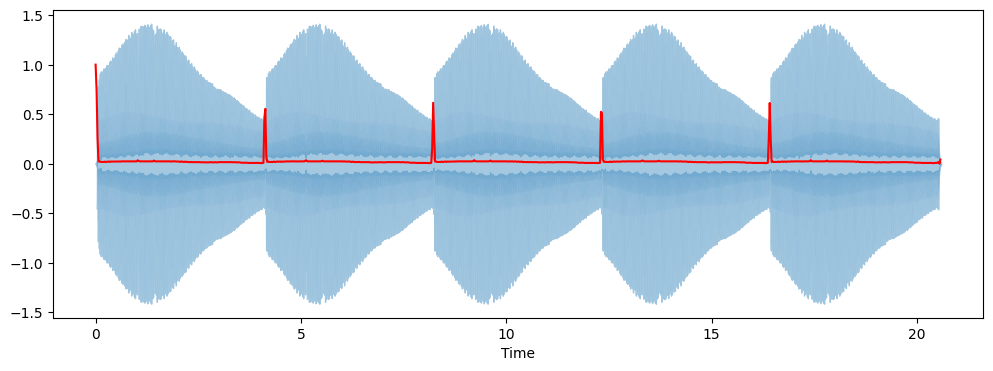

In [365]:
spectral_rolloff = librosa.feature.spectral_rolloff(y=x+0.01, sr=sr)[0]
plt.figure(figsize=(12, 4))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='r')

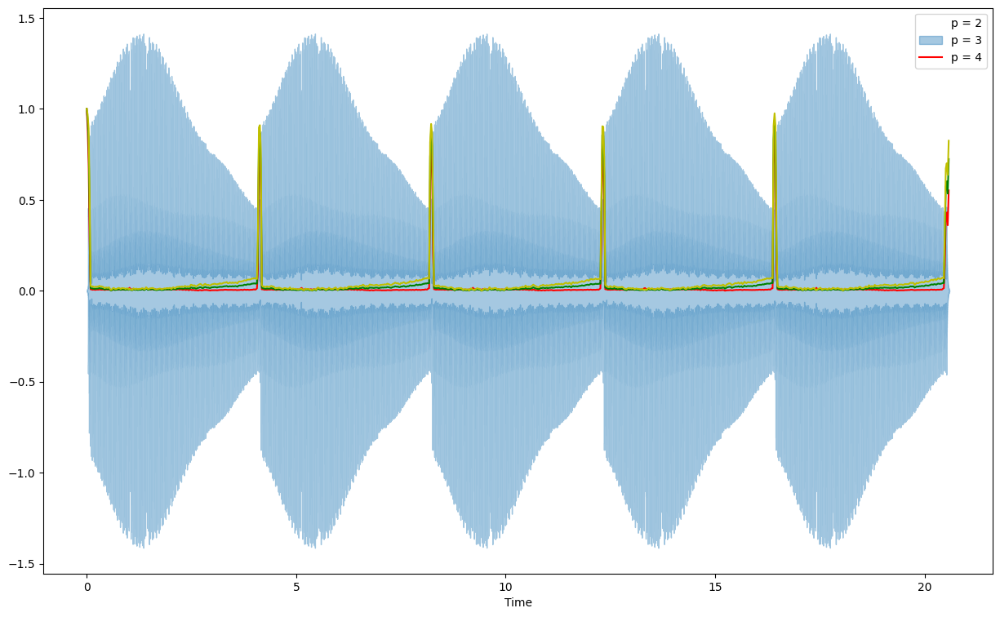

In [366]:
spectral_bandwidth_2 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr)[0]
spectral_bandwidth_3 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=3)[0]
spectral_bandwidth_4 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=4)[0]
plt.figure(figsize=(15, 9))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_bandwidth_2), color='r')
plt.plot(t, normalize(spectral_bandwidth_3), color='g')
plt.plot(t, normalize(spectral_bandwidth_4), color='y')
plt.legend(('p = 2', 'p = 3', 'p = 4'))

In [367]:
mfccs = librosa.feature.mfcc(y=x, sr=sr)
print(mfccs.shape)


(20, 887)


In [368]:
mfccs

array([[-2.8268515e+02, -1.3934024e+02, -1.4092224e+02, ...,
        -2.8372995e+02, -4.1264047e+02, -5.1073126e+02],
       [ 9.5203300e+01,  1.0751751e+02,  1.2354146e+02, ...,
         1.4129298e+02,  1.2017816e+02,  2.4750725e+01],
       [ 2.6922379e+01,  2.6851006e+01,  3.9010315e+01, ...,
         3.9757240e+01,  5.2412445e+01,  2.3922455e+01],
       ...,
       [ 3.5250511e+00,  3.3731999e+00,  1.0748349e+00, ...,
         4.1632080e+00,  3.6511829e+00,  7.4254704e+00],
       [ 3.3902431e-01,  6.3552803e-01, -1.1137195e+00, ...,
         2.3743575e+00,  3.9193096e+00,  7.2293863e+00],
       [ 3.4816442e+00,  3.7444592e+00,  2.0511563e+00, ...,
         1.5988381e+00,  1.8296603e+00,  6.9924326e+00]], dtype=float32)

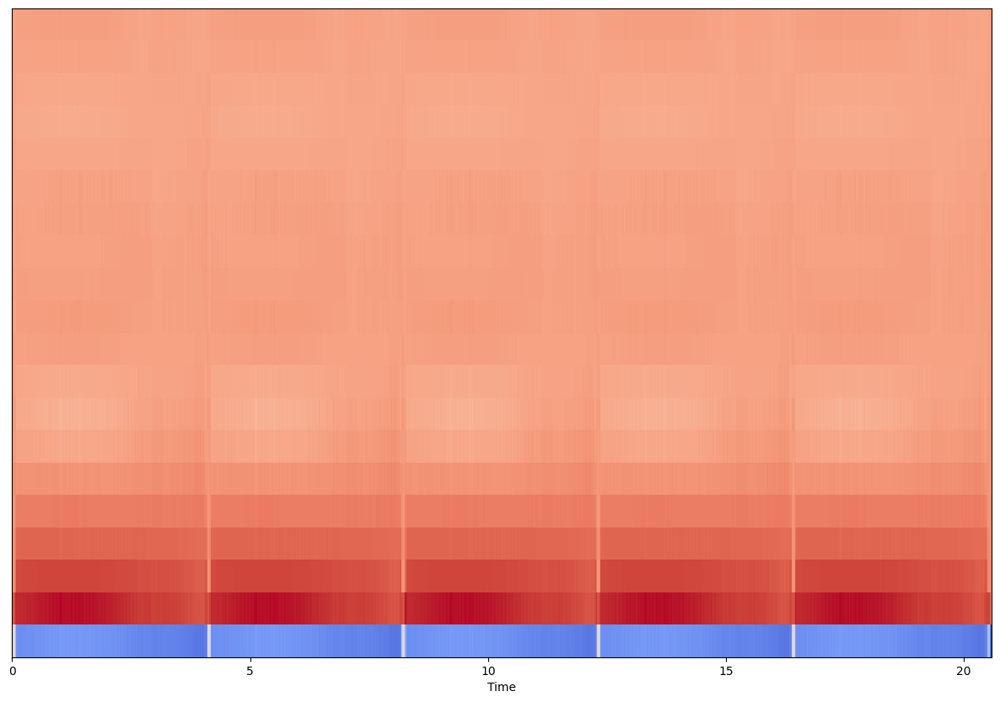

In [369]:
#Displaying  the MFCCs:
plt.figure(figsize=(15, 10))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

### Step 2: Compute Mel-Scaled Spectrogram
The Mel scale is a perceptual scale of pitches judged by listeners to be equal in distance from one another. The reference point between this scale and normal frequency measurement is defined by assigning a perceptual pitch of 1000 mels to a 1000 Hz tone, 40 dB above the listener's threshold.

This scale is used in speech and music processing, particularly for voice recognition, because it approximates human hearing much more closely than the linear frequency scale.

Now, we will compute a Mel-scaled spectrogram for the same audio file.

This process involves converting the conventional frequency scale into the Mel scale, which correlates better with human auditory perception.

In [370]:
y, sr = librosa.load(audio_data)
librosa.feature.melspectrogram(y=y, sr=sr)

array([[3.10056782e+00, 1.67872314e+02, 2.74215668e+02, ...,
        3.77804016e+02, 6.73296814e+01, 3.23711944e+00],
       [2.43983316e+00, 7.32457275e+01, 1.81656296e+02, ...,
        1.12735504e+02, 5.89805269e+00, 3.22323777e-02],
       [1.49981427e+00, 8.96920166e+01, 6.38711121e+02, ...,
        1.32452805e+02, 2.61135149e+00, 2.49235635e-03],
       ...,
       [2.80269538e-04, 2.88829440e-03, 1.88097148e-03, ...,
        7.76380621e-05, 5.18665547e-06, 4.57288394e-08],
       [2.40882349e-04, 2.67385668e-03, 1.79503392e-03, ...,
        4.69053848e-05, 2.99316753e-06, 3.11685682e-08],
       [8.90260526e-06, 1.10125300e-04, 8.10021666e-05, ...,
        3.95347342e-06, 2.76073678e-07, 8.19243340e-09]], dtype=float32)

In [371]:
S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128,
                                    fmax=8000)

[Text(0.5, 1.0, 'Mel-frequency spectrogram')]

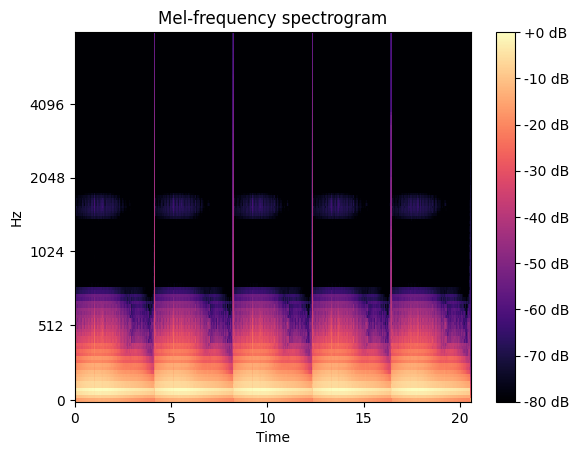

In [372]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
S_dB = librosa.power_to_db(S, ref=np.max)
img = librosa.display.specshow(S_dB, x_axis='time',
                         y_axis='mel', sr=sr,
                         fmax=8000, ax=ax)
fig.colorbar(img, ax=ax, format='%+2.0f dB')
ax.set(title='Mel-frequency spectrogram')

### Step 3: Short-Time Fourier Transform (STFT)

The Short-Time Fourier Transform (STFT) analyzes the frequency content of a signal over time by applying the Fourier Transform to overlapping short segments or windows of the signal. This produces a time-frequency representation called a spectrogram. The window length determines a trade-off: longer windows provide better frequency resolution but worse time resolution, and vice versa. Commonly used in audio and speech processing, the STFT reveals how the signal's frequency components evolve over time.


In [373]:
y, sr = librosa.load(audio_data)
S = np.abs(librosa.stft(y))
S

array([[6.20459938e+00, 6.55151596e+01, 1.09399300e+02, ...,
        1.10935181e+02, 7.81137924e+01, 2.03146420e+01],
       [6.17089033e+00, 6.05920296e+01, 8.69180069e+01, ...,
        9.37137299e+01, 5.34083252e+01, 1.31055470e+01],
       [6.00996637e+00, 4.80379677e+01, 5.03322678e+01, ...,
        6.56227112e+01, 2.21923962e+01, 3.50104403e+00],
       ...,
       [1.09328494e-06, 2.18824152e-06, 1.31258923e-06, ...,
        6.66349706e-07, 3.15585135e-06, 7.71191335e-05],
       [4.62001935e-07, 9.07197261e-07, 1.15945397e-06, ...,
        5.67889970e-07, 3.48884782e-06, 7.63014759e-05],
       [2.05323218e-07, 1.07201984e-07, 1.19350625e-06, ...,
        4.70025782e-07, 3.43887223e-06, 7.59721879e-05]], dtype=float32)

In [374]:
S_left = librosa.stft(y, center=False)

In [375]:
D_short = librosa.stft(y, hop_length=64)

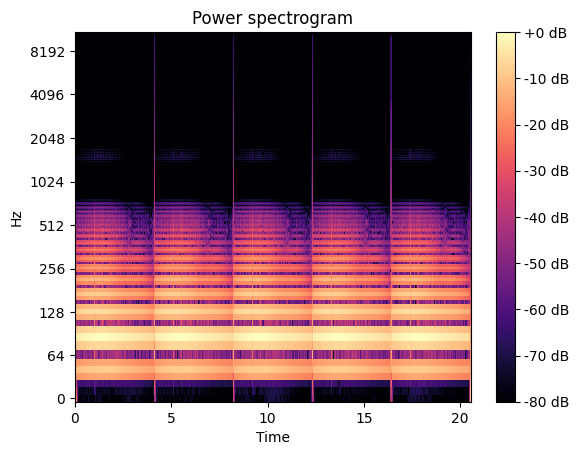

In [376]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
img = librosa.display.specshow(
    librosa.amplitude_to_db(S,ref=np.max),
    y_axis='log',
    x_axis='time',
    ax=ax
    )
ax.set_title('Power spectrogram')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

### Step 4: Beat Tracker

The `librosa` beat tracker detects the rhythmic pulse or "beats" in an audio signal. By analyzing the onset strength of a signal, which corresponds to sudden changes or events in the audio, it determines the timing of beats. Beat tracking is essential for various music analysis tasks, such as tempo estimation, rhythm analysis, and synchronization. In applications like DJ software, automatic music tagging, or dance choreography, the detected beats can be used to align tracks, categorize music, or coordinate movements to the rhythm.


In [377]:
y, sr = librosa.load(audio_data)

In [378]:
tempo, beats = librosa.beat.beat_track(y=y, sr=sr)

In [379]:
tempo

143.5546875

In [380]:
beats

array([  3,  20,  37,  54,  71,  89, 107, 125, 143, 161, 179, 196, 213,
       230, 247, 265, 283, 301, 319, 337, 355, 372, 389, 406, 424, 442,
       460, 478, 496, 514, 532, 549, 566, 583, 600, 618, 636, 654, 672,
       690, 708, 725, 742, 759, 777, 795, 813, 831, 849, 867])

In [381]:
onset_env = librosa.onset.onset_strength(y=y, sr=sr,
                                         aggregate=np.median)
tempo, beats = librosa.beat.beat_track(onset_envelope=onset_env,
                                       sr=sr)

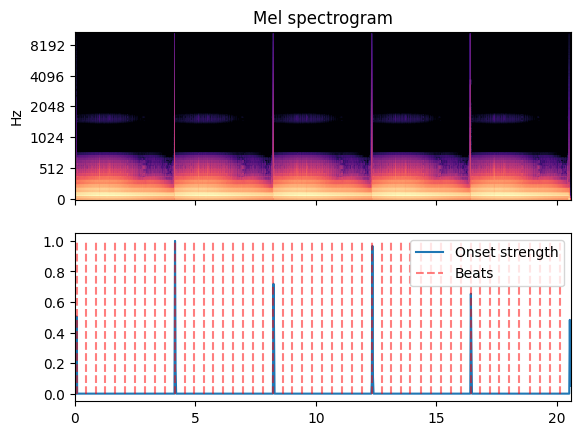

In [382]:
import matplotlib.pyplot as plt
hop_length = 512
fig, ax = plt.subplots(nrows=2, sharex=True)
times = librosa.times_like(onset_env, sr=sr, hop_length=hop_length)
M = librosa.feature.melspectrogram(y=y, sr=sr, hop_length=hop_length)
librosa.display.specshow(librosa.power_to_db(M, ref=np.max),
                         y_axis='mel', x_axis='time', hop_length=hop_length,
                         ax=ax[0])
ax[0].label_outer()
ax[0].set(title='Mel spectrogram')
ax[1].plot(times, librosa.util.normalize(onset_env),
         label='Onset strength')
ax[1].vlines(times[beats], 0, 1, alpha=0.5, color='r',
           linestyle='--', label='Beats')
ax[1].legend()

### Step 5: Compute Constant-Q Transform of Audio Signal

The Constant Q Transform (CQT) in librosa provides a time-frequency representation of an audio signal where the frequency bins are geometrically spaced. Unlike the linear spacing of the Short-Time Fourier Transform (STFT), the CQT's spacing mirrors the logarithmic perception of pitch in human hearing. This makes the CQT especially useful for musical analysis. In the CQT, the "Q-factor" (a ratio of the center frequency to bandwidth) remains constant across all frequencies, ensuring that each frequency bin has consistent resolution. When visualized, harmonics of musical notes align vertically in a CQT spectrogram, making it valuable for studying harmonic structures. In librosa, the cqt function efficiently computes this representation.

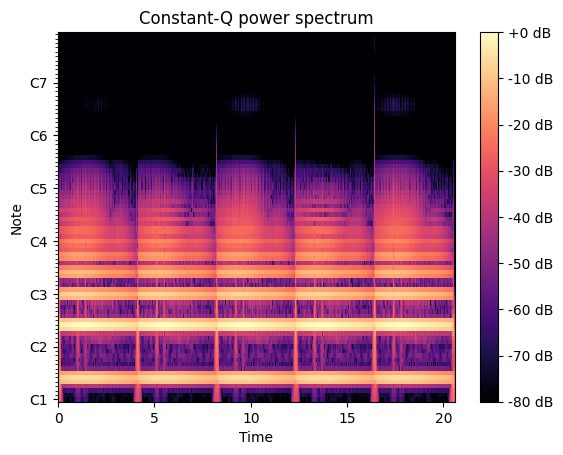

In [383]:
import matplotlib.pyplot as plt
y, sr = librosa.load(audio_data)
C = np.abs(librosa.cqt(y, sr=sr))
fig, ax = plt.subplots()
img = librosa.display.specshow(librosa.amplitude_to_db(C, ref=np.max),
                               sr=sr, x_axis='time', y_axis='cqt_note', ax=ax)
ax.set_title('Constant-Q power spectrum')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

In [384]:
print("The Constant-Q Transform of the Audio Signal is:")
print(C)

The Constant-Q Transform of the Audio Signal is:
[[8.1403822e-01 8.4632003e-01 8.4490663e-01 ... 9.3461126e-01
  9.0832335e-01 8.4862238e-01]
 [8.9123839e-01 9.3965244e-01 9.4209290e-01 ... 9.9418724e-01
  9.6143484e-01 8.8608974e-01]
 [1.0385288e+00 1.0772811e+00 1.0806196e+00 ... 1.0808529e+00
  1.0500959e+00 9.8115045e-01]
 ...
 [3.9170882e-08 6.9008474e-03 9.1248359e-05 ... 7.9636433e-04
  9.1771954e-06 1.9793172e-06]
 [6.1678243e-08 7.1465066e-03 5.9852631e-05 ... 7.4431626e-04
  6.0098396e-06 1.4219934e-06]
 [2.6370735e-08 8.4919538e-03 4.4009194e-05 ... 4.4937877e-04
  4.5313918e-06 1.0109566e-06]]


## KIC12268220C


### Setup

In [385]:
current_file = KIC12268220C_file_path

In [386]:
audio_data = current_file
x , sr = librosa.load(audio_data)
print(type(x), type(sr))
print(x.shape, sr)

<class 'numpy.ndarray'> <class 'int'>
(155056,) 22050


In [387]:
librosa.load(audio_data, sr=44100)

(array([ 4.0354620e-10,  5.7765237e-10,  2.9233271e-10, ...,
        -2.0171693e-02, -2.2792086e-02,  0.0000000e+00], dtype=float32),
 44100)

In [388]:
import IPython.display as ipd
ipd.Audio(audio_data)

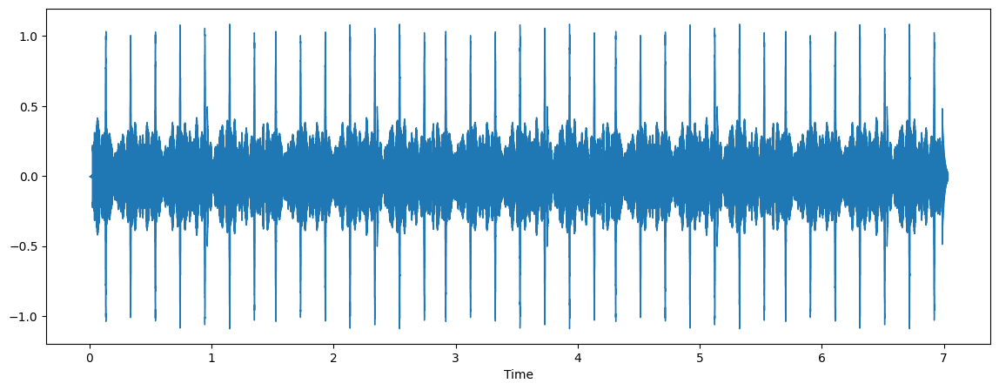

In [389]:
%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display
plt.figure(figsize=(14, 5))
librosa.display.waveshow(x, sr=sr)

In [390]:
# Build a simple chroma filter bank
chromafb = librosa.filters.chroma(sr=22050, n_fft=4096)

chromafb

array([[1.70601543e-05, 2.82992725e-04, 1.03555294e-03, ...,
        5.23030704e-21, 4.43047226e-21, 3.75236833e-21],
       [1.66987356e-05, 3.18591396e-04, 1.46405352e-03, ...,
        1.25662976e-13, 1.10109757e-13, 9.64649842e-14],
       [1.61444223e-05, 3.48842266e-04, 1.90847355e-03, ...,
        5.52980168e-08, 5.01214537e-08, 4.54209257e-08],
       ...,
       [1.68931711e-05, 3.02419503e-04, 1.25730084e-03, ...,
        4.03871397e-17, 4.63902409e-17, 5.32694454e-17],
       [1.71591892e-05, 2.65152019e-04, 8.56101280e-04, ...,
        2.25072222e-25, 2.67424414e-25, 3.17644285e-25],
       [1.72155414e-05, 2.44485302e-04, 6.75355259e-04, ...,
        3.98721026e-30, 3.26509862e-30, 2.67339596e-30]], dtype=float32)

In [391]:
# Use quarter-tones instead of semitones
librosa.filters.chroma(sr=22050, n_fft=4096, n_chroma=24)

array([[1.2062923e-05, 2.0009540e-04, 7.3222251e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.1952894e-05, 2.1304651e-04, 8.7951310e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.1807369e-05, 2.2526611e-04, 1.0352081e-03, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       ...,
       [1.2171624e-05, 1.7373025e-04, 4.8452709e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.2172794e-05, 1.7286799e-04, 4.7753262e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00],
       [1.2136448e-05, 1.8663100e-04, 5.9735152e-04, ..., 0.0000000e+00,
        0.0000000e+00, 0.0000000e+00]], dtype=float32)

In [392]:
# Equally weight all octaves
librosa.filters.chroma(sr=22050, n_fft=4096, octwidth=None)

array([[3.06632757e-01, 2.43654341e-01, 1.60742402e-01, ...,
        2.75466492e-20, 2.33491276e-20, 1.97881458e-20],
       [3.00136745e-01, 2.74304509e-01, 2.27255851e-01, ...,
        6.61833761e-13, 5.80291837e-13, 5.08708906e-13],
       [2.90173739e-01, 3.00350249e-01, 2.96240419e-01, ...,
        2.91240070e-07, 2.64146166e-07, 2.39527623e-07],
       ...,
       [3.03631455e-01, 2.60380656e-01, 1.95162937e-01, ...,
        2.12708409e-16, 2.44482217e-16, 2.80916862e-16],
       [3.08412760e-01, 2.28293657e-01, 1.32887244e-01, ...,
        1.18539604e-24, 1.40935927e-24, 1.67509979e-24],
       [3.09425622e-01, 2.10499778e-01, 1.04831174e-01, ...,
        2.09995848e-29, 1.72074678e-29, 1.40981758e-29]], dtype=float32)

### Step 1: Display Spectrogram, Chromogram, and CQT

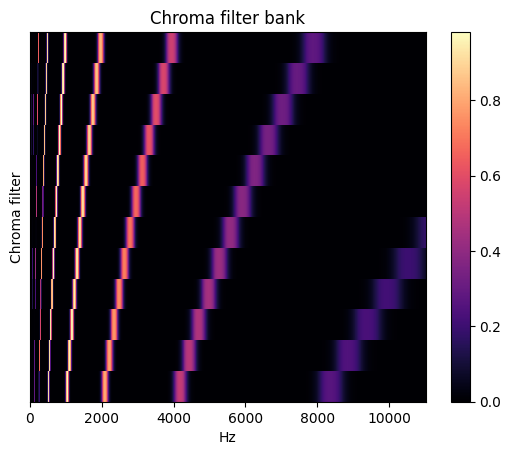

In [393]:
#https://librosa.org/doc-playground/main/generated/librosa.filters.chroma.html?highlight=chroma#librosa.filters.chroma
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
img = librosa.display.specshow(chromafb, x_axis='linear', ax=ax)
ax.set(ylabel='Chroma filter', title='Chroma filter bank')
fig.colorbar(img, ax=ax)


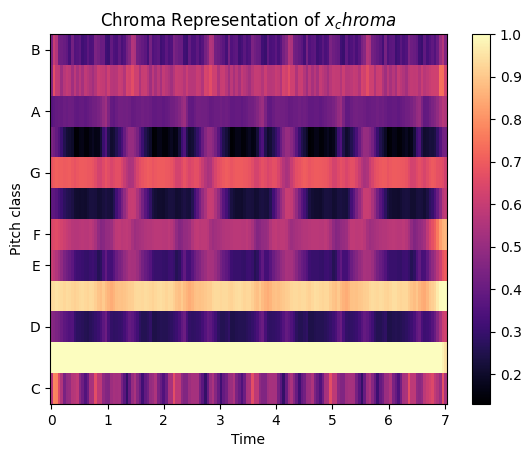

In [394]:
#https://librosa.org/doc-playground/main/auto_examples/plot_music_sync.html?highlight=chroma

# Extract Chroma Features

hop_length = 1024

x_chroma = librosa.feature.chroma_cqt(y=x, sr=sr,
                                         hop_length=hop_length)

fig, ax = plt.subplots(nrows=1, sharey=True)
img = librosa.display.specshow(x_chroma, x_axis='time',
                               y_axis='chroma',
                               hop_length=hop_length, ax=ax)
ax.set(title='Chroma Representation of $x_chroma$')
fig.colorbar(img, ax=ax)

In [395]:
#https://librosa.org/doc-playground/main/generated/librosa.feature.chroma_stft.html?highlight=ibrosa%20feature%20chroma_stft#librosa.feature.chroma_stft
#Energy
librosa.feature.chroma_stft(y=x, sr=sr)

array([[1.        , 1.        , 1.        , ..., 1.        , 1.        ,
        0.88113636],
       [0.5989229 , 0.28312474, 0.19532257, ..., 0.3866407 , 0.77755505,
        0.92881393],
       [0.25886604, 0.06828175, 0.02138191, ..., 0.2067864 , 0.6498852 ,
        0.9740127 ],
       ...,
       [0.19836926, 0.05788017, 0.0286102 , ..., 0.20303538, 0.56645113,
        0.9049252 ],
       [0.20076908, 0.15065752, 0.24496537, ..., 0.45466027, 0.5978928 ,
        0.85558015],
       [0.54818815, 0.5775217 , 0.5643385 , ..., 0.73440933, 0.82982236,
        0.8203861 ]], dtype=float32)

In [396]:
# Use an energy (magnitude) spectrum instead of power spectrogram
S = np.abs(librosa.stft(x))
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
chroma

array([[1.        , 1.        , 1.        , ..., 1.        , 1.        ,
        0.98862183],
       [0.8172466 , 0.54019547, 0.34547338, ..., 0.63359493, 0.83011883,
        0.9819745 ],
       [0.59584254, 0.327807  , 0.14566846, ..., 0.49505475, 0.73425245,
        0.9971601 ],
       ...,
       [0.49989745, 0.2931981 , 0.15531279, ..., 0.51196253, 0.70179164,
        0.9884707 ],
       [0.4977967 , 0.4408761 , 0.49003622, ..., 0.7303417 , 0.74033517,
        0.9763606 ],
       [0.7388563 , 0.7656534 , 0.7693912 , ..., 0.917293  , 0.94283056,
        0.96410054]], dtype=float32)

In [397]:
# Use an energy (magnitude) spectrum instead of power spectrogram
S = np.abs(librosa.stft(x))
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
chroma

array([[1.        , 1.        , 1.        , ..., 1.        , 1.        ,
        0.98862183],
       [0.8172466 , 0.54019547, 0.34547338, ..., 0.63359493, 0.83011883,
        0.9819745 ],
       [0.59584254, 0.327807  , 0.14566846, ..., 0.49505475, 0.73425245,
        0.9971601 ],
       ...,
       [0.49989745, 0.2931981 , 0.15531279, ..., 0.51196253, 0.70179164,
        0.9884707 ],
       [0.4977967 , 0.4408761 , 0.49003622, ..., 0.7303417 , 0.74033517,
        0.9763606 ],
       [0.7388563 , 0.7656534 , 0.7693912 , ..., 0.917293  , 0.94283056,
        0.96410054]], dtype=float32)

In [398]:
# Use a pre-computed power spectrogram with a larger frame
S = np.abs(librosa.stft(x, n_fft=4096))**2
chroma = librosa.feature.chroma_stft(S=S, sr=sr)
chroma

array([[1.        , 1.        , 1.        , ..., 0.95079845, 1.        ,
        1.        ],
       [0.24896924, 0.1711369 , 0.19810332, ..., 0.6070447 , 0.45035172,
        0.6494077 ],
       [0.05093704, 0.01665136, 0.06262264, ..., 0.5799273 , 0.3591636 ,
        0.48892623],
       ...,
       [0.04222316, 0.01822728, 0.06094937, ..., 0.56150824, 0.40301394,
        0.44872645],
       [0.1633569 , 0.15133043, 0.14605461, ..., 0.9026876 , 0.717588  ,
        0.5441065 ],
       [0.52683604, 0.4409009 , 0.3508545 , ..., 1.        , 0.9062449 ,
        0.79074   ]], dtype=float32)

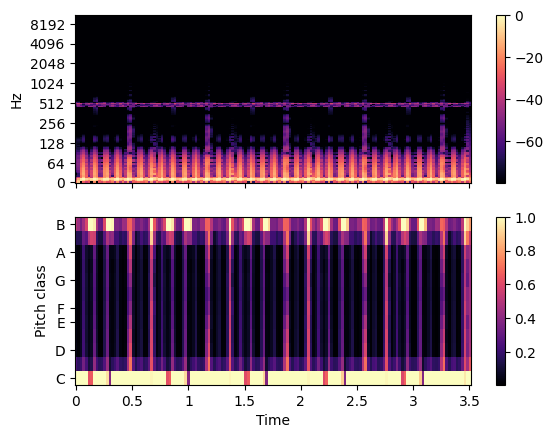

In [399]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(nrows=2, sharex=True)
img = librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),
                               y_axis='log', x_axis='time', ax=ax[0])
fig.colorbar(img, ax=[ax[0]])
ax[0].label_outer()
img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax[1])
fig.colorbar(img, ax=[ax[1]])

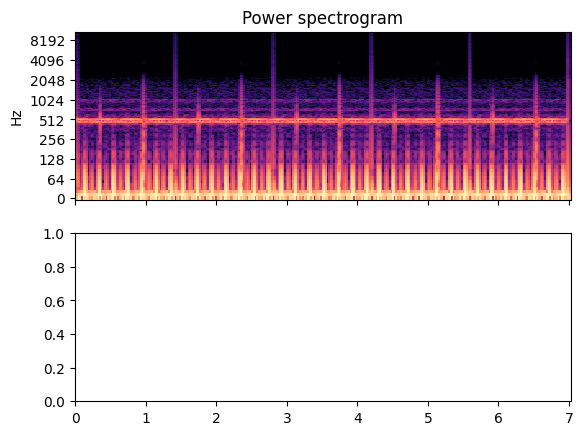

In [400]:
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()

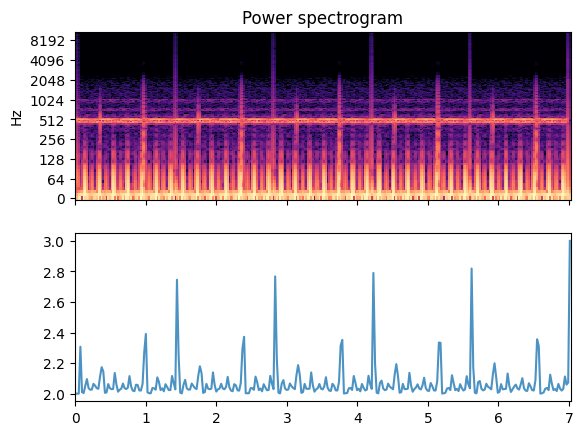

In [401]:
# Construct a standard onset function
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()
onset_env = librosa.onset.onset_strength(y=x, sr=sr)
ax[1].plot(times, 2 + onset_env / onset_env.max(), alpha=0.8,
           label='Mean (mel)')

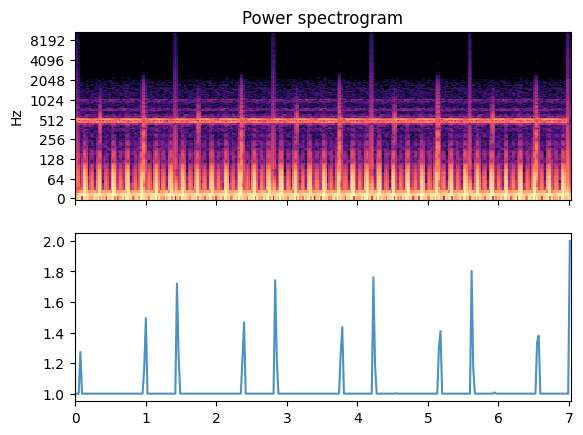

In [402]:
# Median aggregation, and custom mel options
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()

onset_env = librosa.onset.onset_strength(y=x, sr=sr,
                                         aggregate=np.median,
                                         fmax=8000, n_mels=256)
ax[1].plot(times, 1 + onset_env / onset_env.max(), alpha=0.8,
           label='Median (custom mel)')


[Text(0, 0.5, 'Normalized strength'), []]

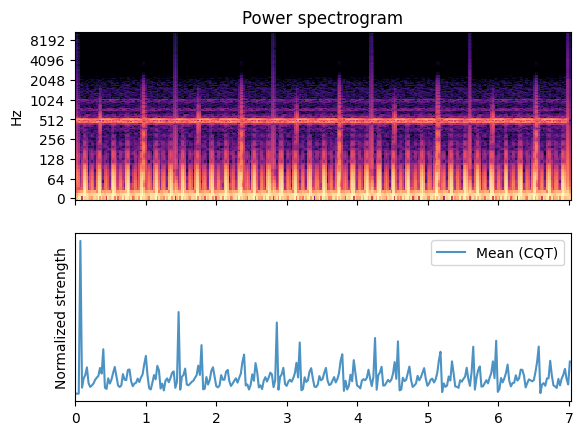

In [403]:
# Constant-Q spectrogram instead of Mel
# First, load some audio and plot the spectrogram
D = np.abs(librosa.stft(x))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows=2, sharex=True)
librosa.display.specshow(librosa.amplitude_to_db(D, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()


C = np.abs(librosa.cqt(y=x, sr=sr))
onset_env = librosa.onset.onset_strength(sr=sr, S=librosa.amplitude_to_db(C, ref=np.max))
ax[1].plot(times, onset_env / onset_env.max(), alpha=0.8,
         label='Mean (CQT)')
ax[1].legend()
ax[1].set(ylabel='Normalized strength', yticks=[])


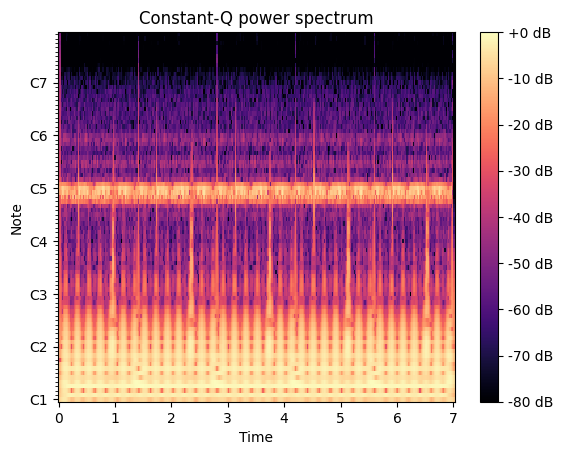

In [404]:
C = np.abs(librosa.cqt(x, sr=sr))
fig, ax = plt.subplots()
img = librosa.display.specshow(librosa.amplitude_to_db(C, ref=np.max),
                               sr=sr, x_axis='time', y_axis='cqt_note', ax=ax)
ax.set_title('Constant-Q power spectrum')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

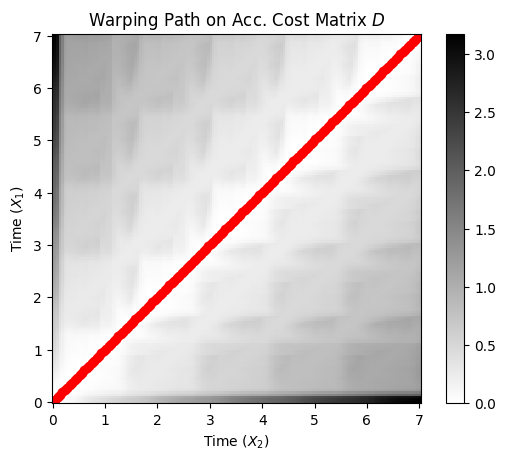

In [405]:
D, wp = librosa.sequence.dtw(X=x_chroma,Y=x_chroma, metric='cosine')
wp_s = librosa.frames_to_time(wp, sr=sr, hop_length=hop_length)

fig, ax = plt.subplots()
img = librosa.display.specshow(D, x_axis='time', y_axis='time', sr=sr,
                               cmap='gray_r', hop_length=hop_length, ax=ax)
ax.plot(wp_s[:, 1], wp_s[:, 0], marker='o', color='r')
ax.set(title='Warping Path on Acc. Cost Matrix $D$',
       xlabel='Time $(X_2)$', ylabel='Time $(X_1)$')
fig.colorbar(img, ax=ax)


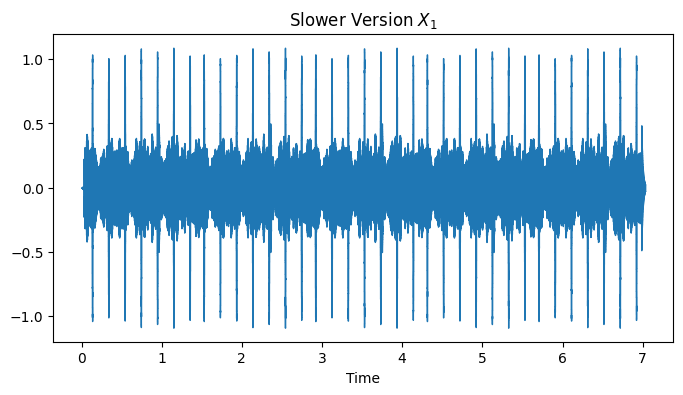

In [406]:
#Alternative Visualization in the Time Domain
fig, ax1 = plt.subplots(nrows=1, sharex=True, sharey=True, figsize=(8, 4))

# Plot x_1
librosa.display.waveshow(x, sr=sr, ax=ax1)
ax1.set(title='Slower Version $X_1$')
ax1.label_outer()


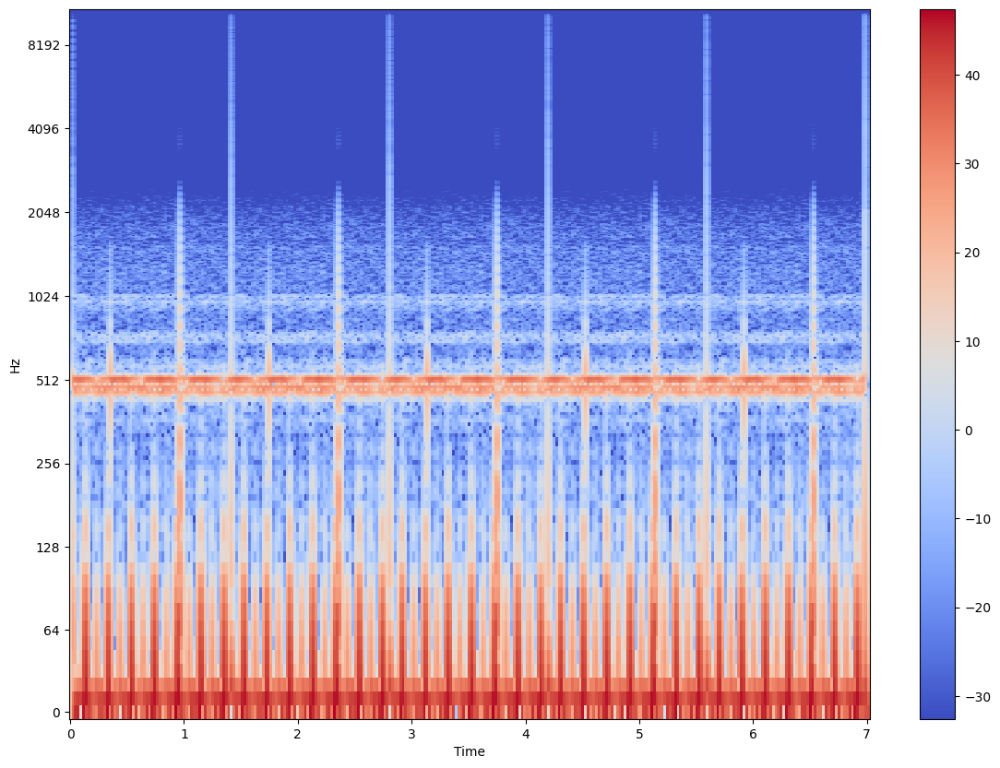

In [407]:
# Spectrogram
import matplotlib.pyplot as plt
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 10))

librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()

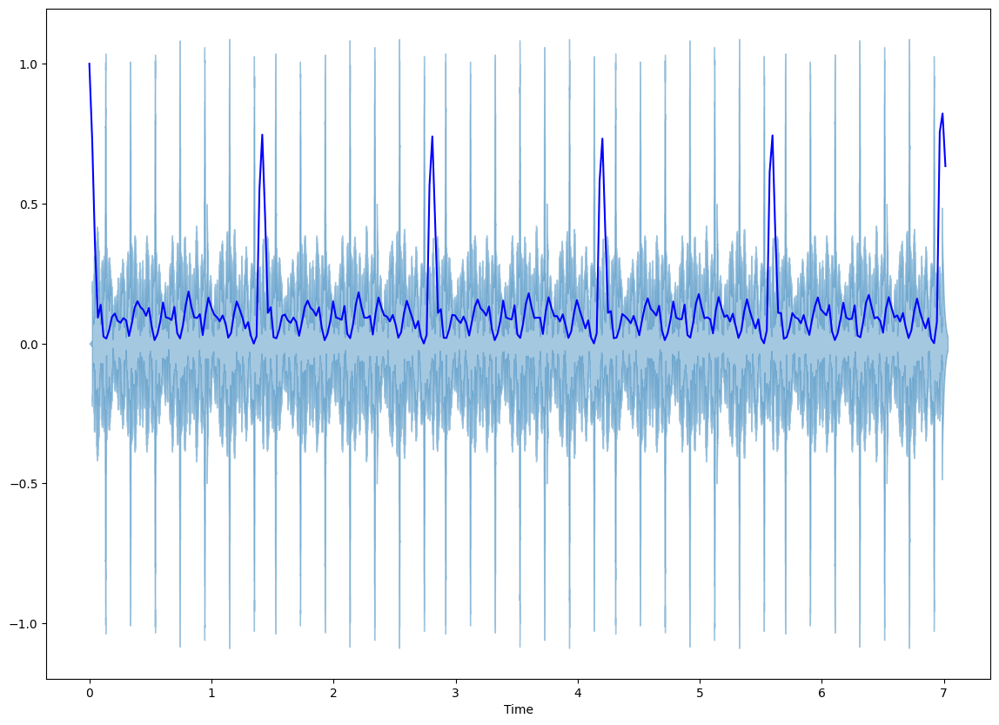

In [408]:
# Spectral Centroid
import sklearn
from sklearn import preprocessing
#https://zhuanlan.zhihu.com/p/144922679
#labelEncoder= preprocessing.LabelEncoder()

spectral_centroids = librosa.feature.spectral_centroid(y=x, sr=sr)[0]
spectral_centroids.shape
plt.figure(figsize=(14, 10))
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='b')

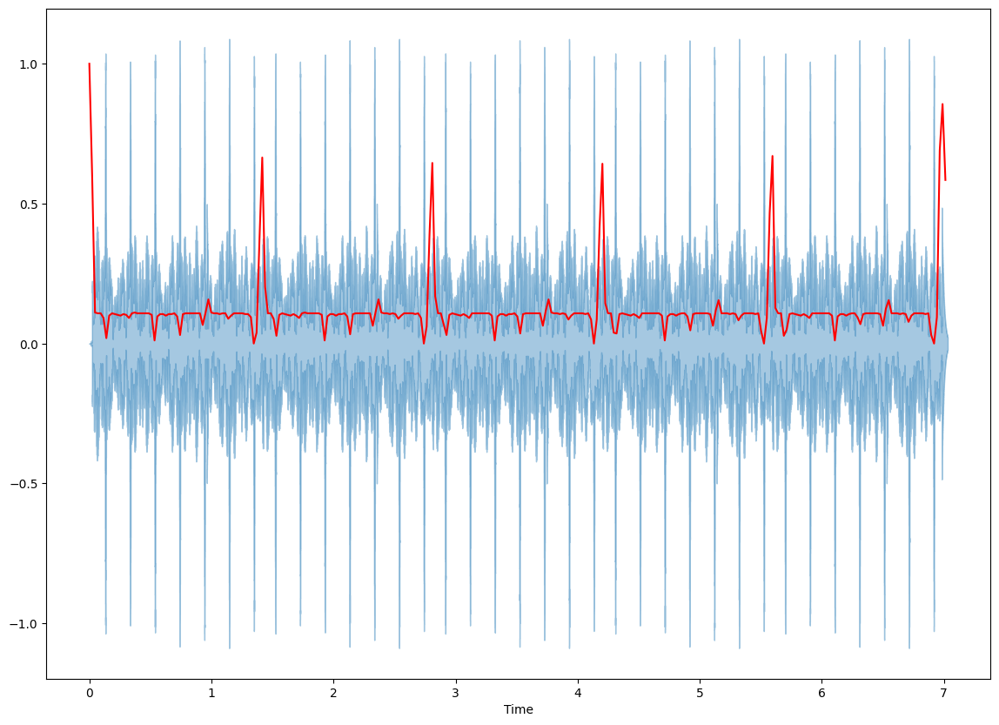

In [409]:
# Spectral Rolloff
spectral_rolloff = librosa.feature.spectral_rolloff(y=x+0.01, sr=sr)[0]
plt.figure(figsize=(14, 10))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='r')

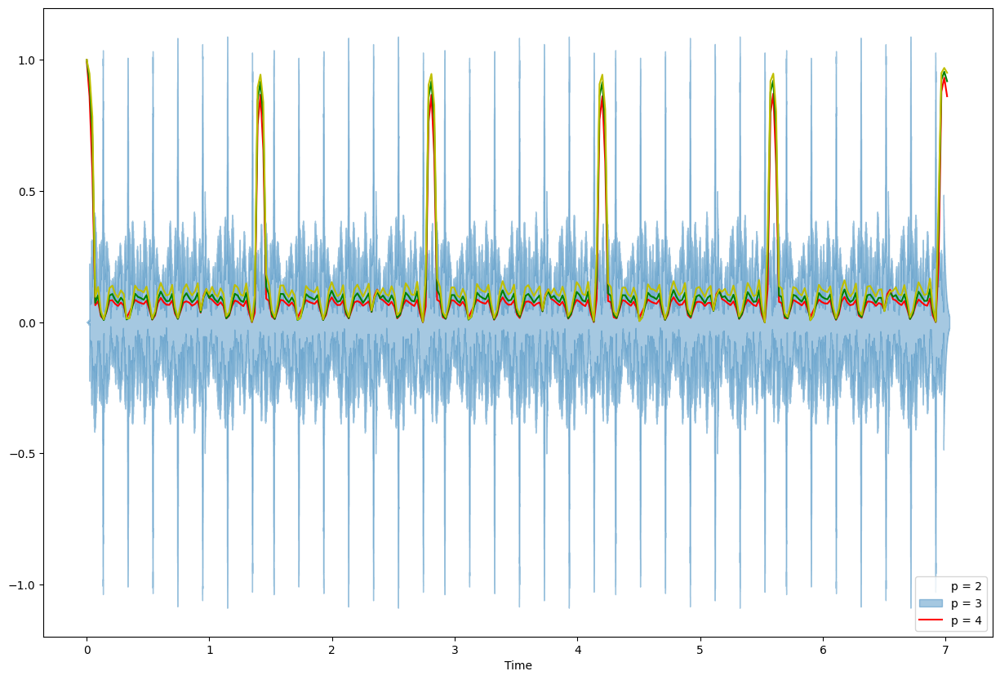

In [410]:
# Spectral Bandwidth
spectral_bandwidth_2 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr)[0]
spectral_bandwidth_3 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=3)[0]
spectral_bandwidth_4 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=4)[0]
plt.figure(figsize=(15, 10))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_bandwidth_2), color='r')
plt.plot(t, normalize(spectral_bandwidth_3), color='g')
plt.plot(t, normalize(spectral_bandwidth_4), color='y')
plt.legend(('p = 2', 'p = 3', 'p = 4'))

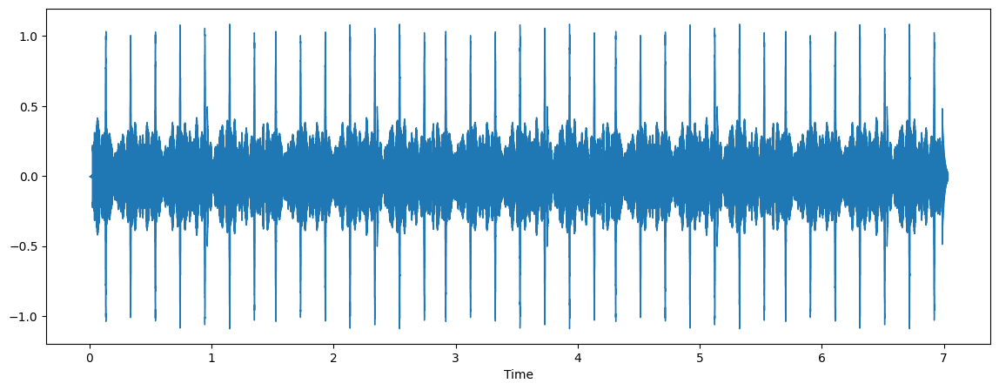

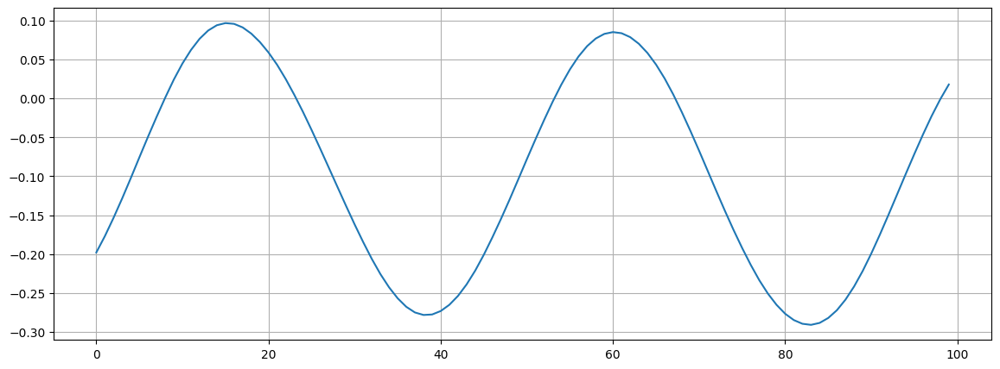

In [411]:
# Zero-Crossing Rate
x, sr = librosa.load(audio_data)
#Plot the signal:
plt.figure(figsize=(14, 5))
librosa.display.waveshow(x, sr=sr)
# Zooming in
n0 = 9000
n1 = 9100
plt.figure(figsize=(14, 5))
plt.plot(x[n0:n1])
plt.grid()

In [412]:
zero_crossings = librosa.zero_crossings(x[n0:n1], pad=False)
print(sum(zero_crossings))

5


(20, 303)


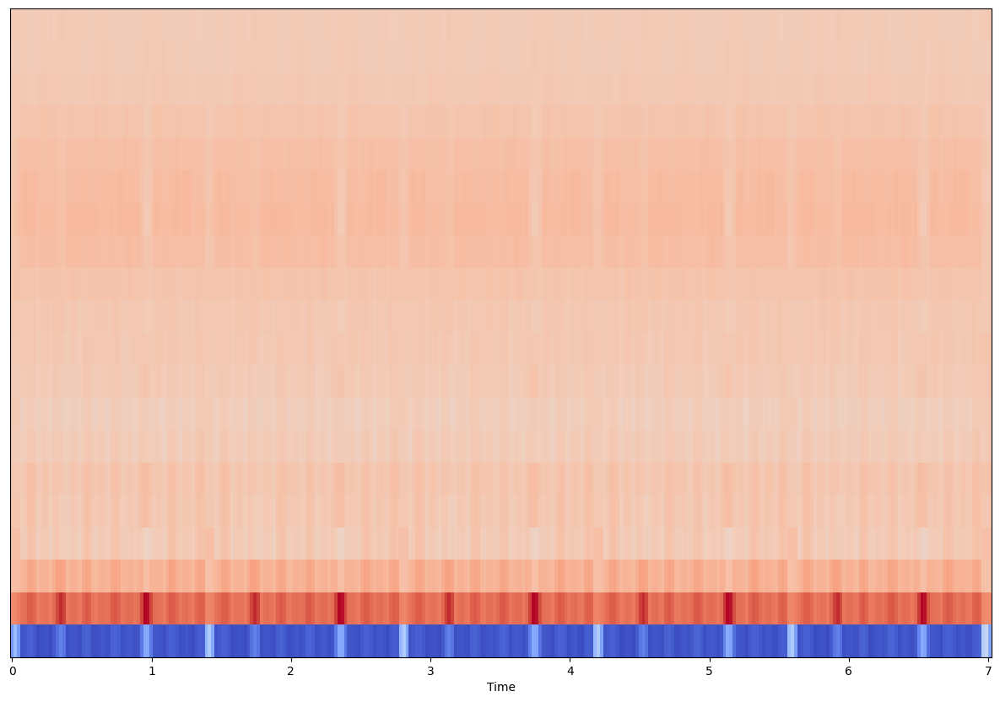

In [413]:
mfccs = librosa.feature.mfcc(y=x, sr=sr)
print(mfccs.shape)
plt.figure(figsize=(15, 10))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

In [414]:
librosa.load(audio_data, sr=44100)

(array([ 4.0354620e-10,  5.7765237e-10,  2.9233271e-10, ...,
        -2.0171693e-02, -2.2792086e-02,  0.0000000e+00], dtype=float32),
 44100)

In [415]:
ipd.Audio(audio_data)

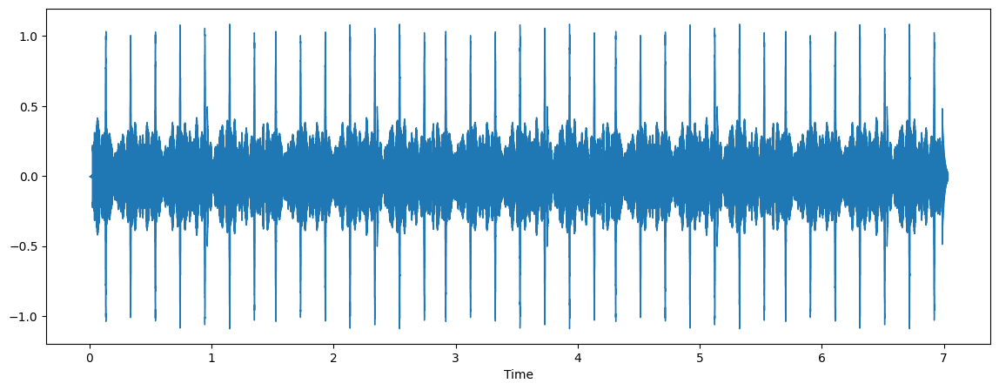

In [416]:
%matplotlib inline
import matplotlib.pyplot as plt
import librosa.display
plt.figure(figsize=(14, 5))
librosa.display.waveshow(x, sr=sr)

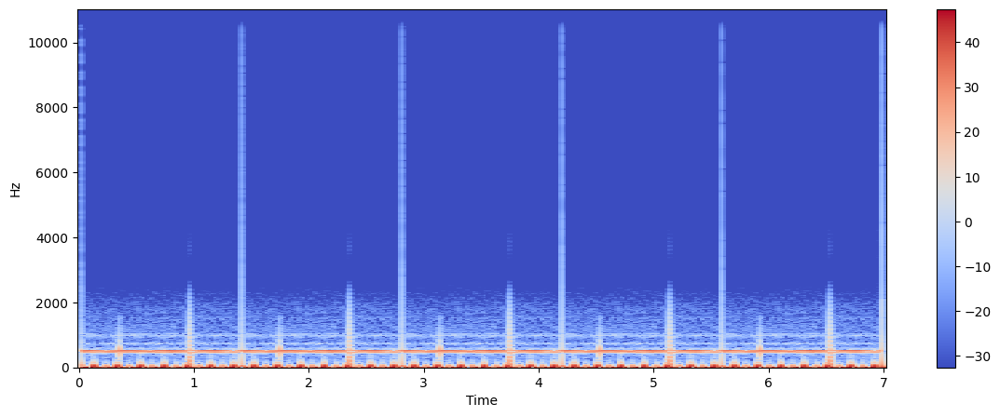

In [417]:
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(14, 5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()

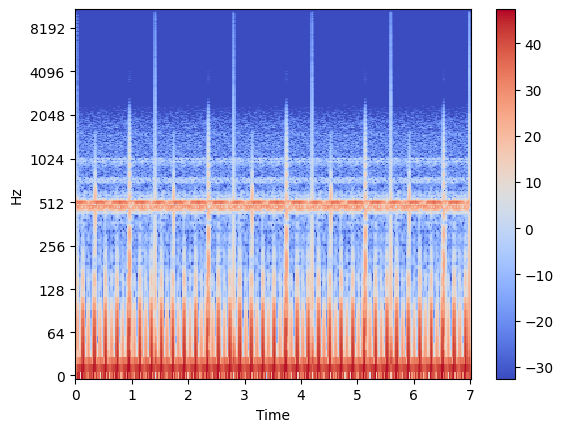

In [418]:
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()

In [419]:
import sklearn
spectral_centroids = librosa.feature.spectral_centroid(y=x, sr=sr)[0]
spectral_centroids.shape
# # Computing the time variable for visualization
# plt.figure(figsize=(12, 4))frames = range(len(spectral_centroids))
# t = librosa.frames_to_time(frames)
# # Normalising the spectral centroid for visualisation
# def normalize(x, axis=0):
#     return sklearn.preprocessing.minmax_scale(x, axis=axis)
# #Plotting the Spectral Centroid along the waveform
# librosa.display.waveplot(x, sr=sr, alpha=0.4)
# plt.plot(t, normalize(spectral_centroids), color='b')

(303,)

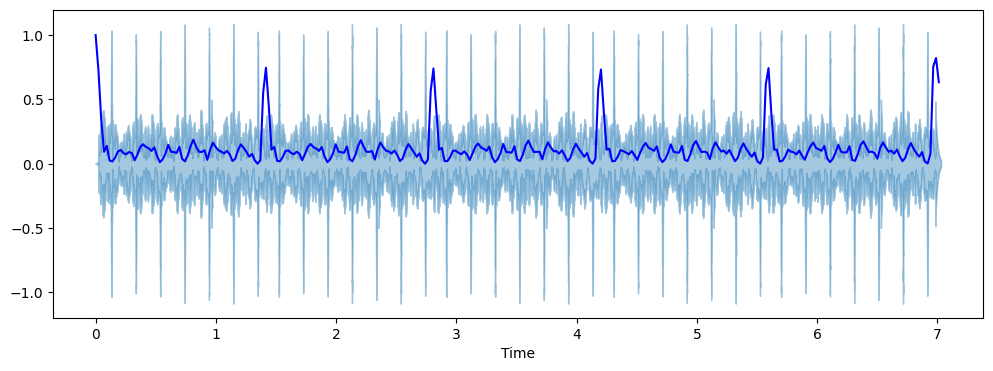

In [420]:
plt.figure(figsize=(12, 4))
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='b')

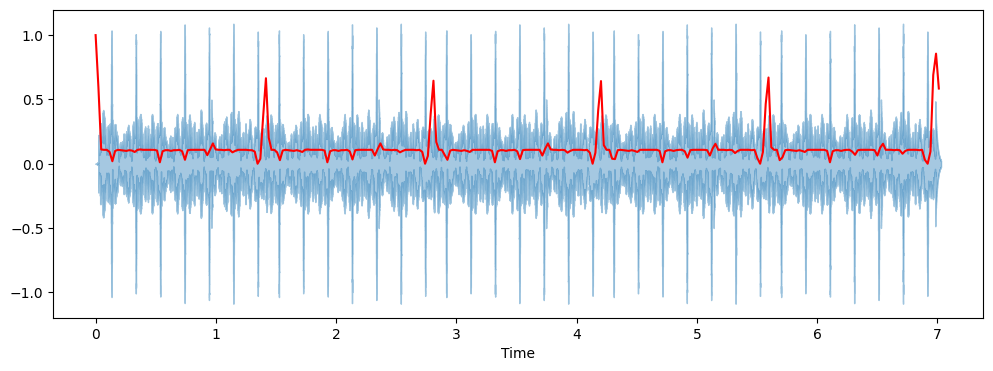

In [421]:
spectral_rolloff = librosa.feature.spectral_rolloff(y=x+0.01, sr=sr)[0]
plt.figure(figsize=(12, 4))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='r')

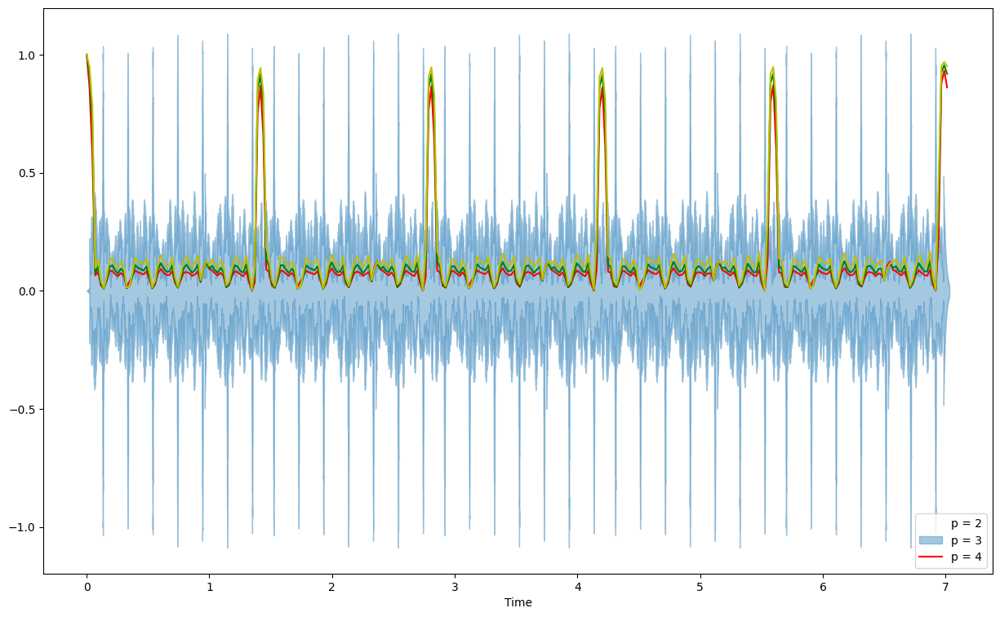

In [422]:
spectral_bandwidth_2 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr)[0]
spectral_bandwidth_3 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=3)[0]
spectral_bandwidth_4 = librosa.feature.spectral_bandwidth(y=x+0.01, sr=sr, p=4)[0]
plt.figure(figsize=(15, 9))
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_bandwidth_2), color='r')
plt.plot(t, normalize(spectral_bandwidth_3), color='g')
plt.plot(t, normalize(spectral_bandwidth_4), color='y')
plt.legend(('p = 2', 'p = 3', 'p = 4'))

In [423]:
mfccs = librosa.feature.mfcc(y=x, sr=sr)
print(mfccs.shape)


(20, 303)


In [424]:
mfccs

array([[-2.62364929e+02, -2.00158020e+02, -2.65782990e+02, ...,
        -1.48555267e+02, -1.22460197e+02, -2.40731400e+02],
       [ 1.12714775e+02,  1.20507278e+02,  1.32747040e+02, ...,
         1.21491302e+02,  1.16598633e+02,  1.11428917e+02],
       [ 2.68869495e+01,  2.89589806e+01,  3.39865379e+01, ...,
         2.38772888e+01,  2.07893524e+01,  1.80700588e+01],
       ...,
       [ 3.91435003e+00,  6.63008690e+00,  6.75136089e+00, ...,
         4.94232273e+00,  3.80328894e+00,  4.12115765e+00],
       [-3.80285668e+00, -4.16926193e+00, -3.00258112e+00, ...,
        -3.41987562e+00, -3.01593685e+00, -1.02167584e-01],
       [-2.22931719e+00, -2.69087076e+00, -2.58752322e+00, ...,
        -1.44130468e+00,  5.61790705e-01,  4.91527700e+00]], dtype=float32)

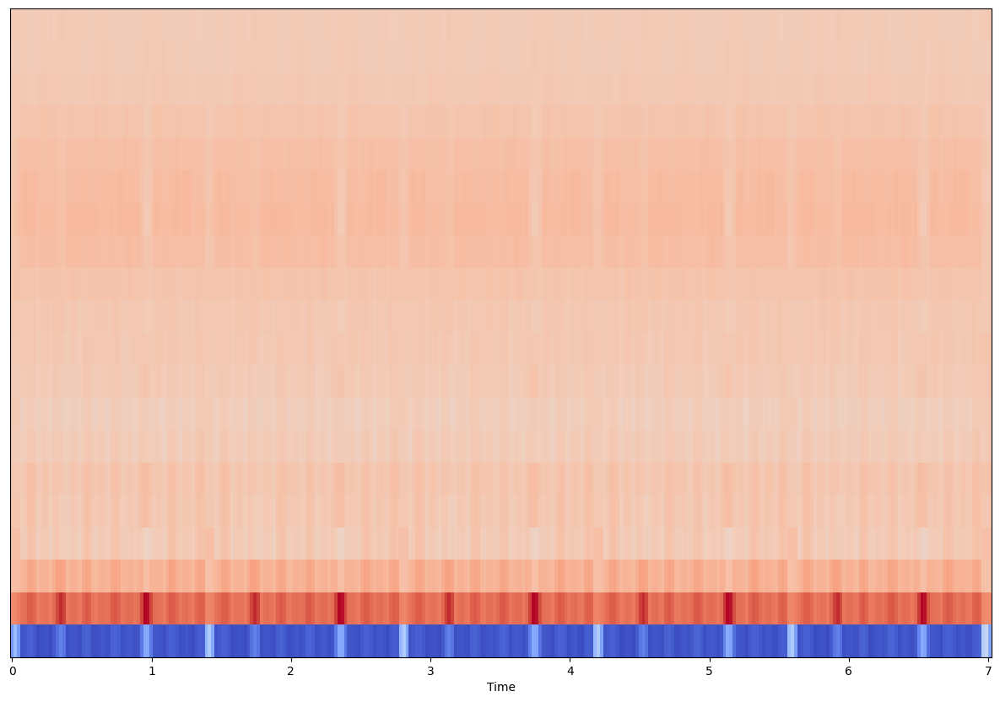

In [425]:
#Displaying  the MFCCs:
plt.figure(figsize=(15, 10))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

### Step 2: Compute Mel-Scaled Spectrogram
The Mel scale is a perceptual scale of pitches judged by listeners to be equal in distance from one another. The reference point between this scale and normal frequency measurement is defined by assigning a perceptual pitch of 1000 mels to a 1000 Hz tone, 40 dB above the listener's threshold.

This scale is used in speech and music processing, particularly for voice recognition, because it approximates human hearing much more closely than the linear frequency scale.

Now, we will compute a Mel-scaled spectrogram for the same audio file.

This process involves converting the conventional frequency scale into the Mel scale, which correlates better with human auditory perception.

In [426]:
y, sr = librosa.load(audio_data)
librosa.feature.melspectrogram(y=y, sr=sr)

array([[4.0755124e+00, 4.9570740e+01, 2.0643884e+02, ..., 4.3314871e+02,
        6.2186530e+02, 1.3207654e+02],
       [3.7264299e+00, 2.8279877e+01, 1.6180338e+01, ..., 4.8524940e+01,
        1.0476665e+02, 1.3030915e+01],
       [3.8961947e+00, 2.4408257e+01, 1.0783615e+01, ..., 2.0980267e+01,
        3.9536331e+01, 3.9571106e+00],
       ...,
       [1.9438818e-04, 5.6377577e-04, 1.0783761e-04, ..., 1.7114101e-03,
        3.1287842e-03, 2.9704630e-04],
       [1.4835600e-04, 2.7780578e-04, 3.9261944e-05, ..., 9.4307325e-04,
        1.7272758e-03, 1.6635834e-04],
       [1.2497708e-05, 2.2840904e-05, 3.1497220e-06, ..., 8.2289982e-05,
        1.5319434e-04, 1.5653819e-05]], dtype=float32)

In [427]:
S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=128,
                                    fmax=8000)

[Text(0.5, 1.0, 'Mel-frequency spectrogram')]

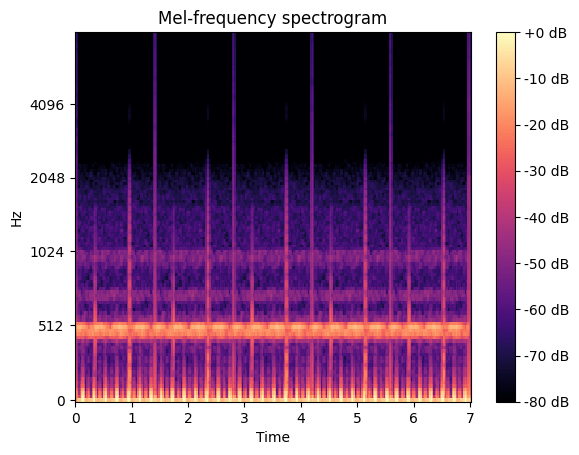

In [428]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
S_dB = librosa.power_to_db(S, ref=np.max)
img = librosa.display.specshow(S_dB, x_axis='time',
                         y_axis='mel', sr=sr,
                         fmax=8000, ax=ax)
fig.colorbar(img, ax=ax, format='%+2.0f dB')
ax.set(title='Mel-frequency spectrogram')

### Step 3: Short-Time Fourier Transform (STFT)

The Short-Time Fourier Transform (STFT) analyzes the frequency content of a signal over time by applying the Fourier Transform to overlapping short segments or windows of the signal. This produces a time-frequency representation called a spectrogram. The window length determines a trade-off: longer windows provide better frequency resolution but worse time resolution, and vice versa. Commonly used in audio and speech processing, the STFT reveals how the signal's frequency components evolve over time.


In [429]:
y, sr = librosa.load(audio_data)
S = np.abs(librosa.stft(y))
S

array([[9.32626247e+00, 6.31769485e+01, 1.58537491e+02, ...,
        7.13081589e+01, 9.00511703e+01, 9.72657547e+01],
       [8.64286613e+00, 4.69703674e+01, 1.04980644e+02, ...,
        1.23185593e+02, 1.20459190e+02, 7.25991058e+01],
       [6.98215389e+00, 1.55648479e+01, 2.73390484e+01, ...,
        6.78153381e+01, 9.44827347e+01, 3.18277302e+01],
       ...,
       [6.22980792e-07, 7.41570261e-07, 4.85183250e-07, ...,
        5.25853750e-07, 2.65077233e-05, 1.32439495e-03],
       [3.13919486e-07, 6.32029185e-08, 3.82067697e-07, ...,
        2.71532855e-07, 2.54348888e-05, 1.32266071e-03],
       [2.78514079e-07, 3.89912032e-07, 4.05498298e-07, ...,
        7.76614002e-07, 2.63452548e-05, 1.32271461e-03]], dtype=float32)

In [430]:
S_left = librosa.stft(y, center=False)

In [431]:
D_short = librosa.stft(y, hop_length=64)

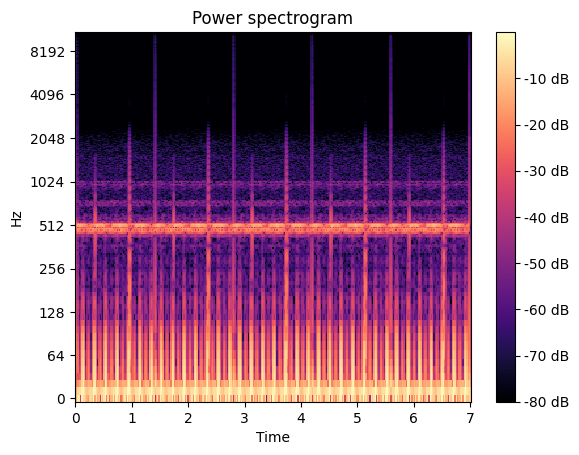

In [432]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
img = librosa.display.specshow(
    librosa.amplitude_to_db(S,ref=np.max),
    y_axis='log',
    x_axis='time',
    ax=ax
    )
ax.set_title('Power spectrogram')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

### Step 4: Beat Tracker

The `librosa` beat tracker detects the rhythmic pulse or "beats" in an audio signal. By analyzing the onset strength of a signal, which corresponds to sudden changes or events in the audio, it determines the timing of beats. Beat tracking is essential for various music analysis tasks, such as tempo estimation, rhythm analysis, and synchronization. In applications like DJ software, automatic music tagging, or dance choreography, the detected beats can be used to align tracks, categorize music, or coordinate movements to the rhythm.


In [433]:
y, sr = librosa.load(audio_data)

In [434]:
tempo, beats = librosa.beat.beat_track(y=y, sr=sr)

In [435]:
tempo

135.99917763157896

In [436]:
beats

array([ 43,  62,  82, 103, 122, 142, 163, 182, 202, 223, 242, 262, 283])

In [437]:
onset_env = librosa.onset.onset_strength(y=y, sr=sr,
                                         aggregate=np.median)
tempo, beats = librosa.beat.beat_track(onset_envelope=onset_env,
                                       sr=sr)

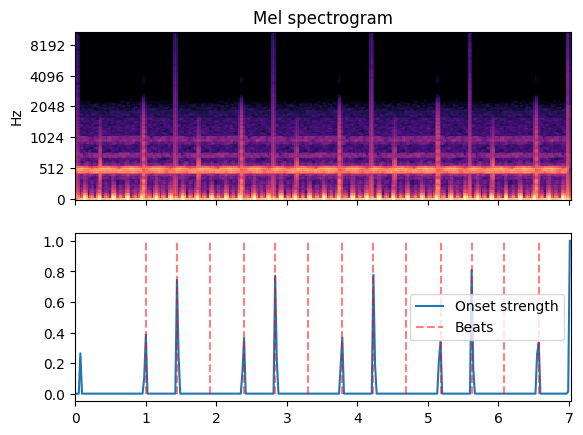

In [438]:
import matplotlib.pyplot as plt
hop_length = 512
fig, ax = plt.subplots(nrows=2, sharex=True)
times = librosa.times_like(onset_env, sr=sr, hop_length=hop_length)
M = librosa.feature.melspectrogram(y=y, sr=sr, hop_length=hop_length)
librosa.display.specshow(librosa.power_to_db(M, ref=np.max),
                         y_axis='mel', x_axis='time', hop_length=hop_length,
                         ax=ax[0])
ax[0].label_outer()
ax[0].set(title='Mel spectrogram')
ax[1].plot(times, librosa.util.normalize(onset_env),
         label='Onset strength')
ax[1].vlines(times[beats], 0, 1, alpha=0.5, color='r',
           linestyle='--', label='Beats')
ax[1].legend()

### Step 5: Compute Constant-Q Transform of Audio Signal

The Constant Q Transform (CQT) in librosa provides a time-frequency representation of an audio signal where the frequency bins are geometrically spaced. Unlike the linear spacing of the Short-Time Fourier Transform (STFT), the CQT's spacing mirrors the logarithmic perception of pitch in human hearing. This makes the CQT especially useful for musical analysis. In the CQT, the "Q-factor" (a ratio of the center frequency to bandwidth) remains constant across all frequencies, ensuring that each frequency bin has consistent resolution. When visualized, harmonics of musical notes align vertically in a CQT spectrogram, making it valuable for studying harmonic structures. In librosa, the cqt function efficiently computes this representation.

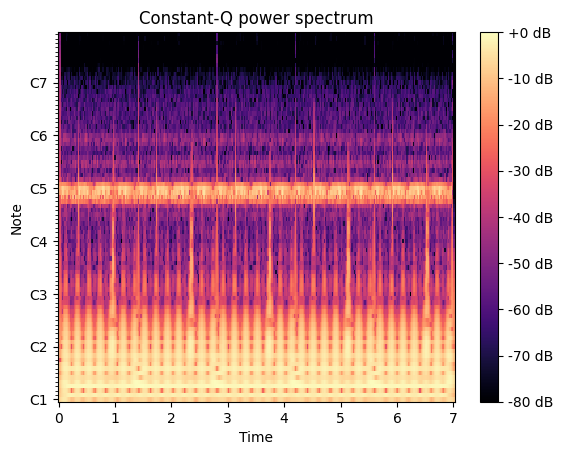

In [439]:
import matplotlib.pyplot as plt
y, sr = librosa.load(audio_data)
C = np.abs(librosa.cqt(y, sr=sr))
fig, ax = plt.subplots()
img = librosa.display.specshow(librosa.amplitude_to_db(C, ref=np.max),
                               sr=sr, x_axis='time', y_axis='cqt_note', ax=ax)
ax.set_title('Constant-Q power spectrum')
fig.colorbar(img, ax=ax, format="%+2.0f dB")

In [440]:
print("The Constant-Q Transform of the Audio Signal is:")
print(C)

The Constant-Q Transform of the Audio Signal is:
[[1.43573165e+00 1.79272783e+00 2.11045313e+00 ... 1.97474408e+00
  1.80309808e+00 1.56693041e+00]
 [1.10342038e+00 1.45776570e+00 1.76990592e+00 ... 1.49296439e+00
  1.25681520e+00 1.00438166e+00]
 [9.08496439e-01 1.32521117e+00 1.73568702e+00 ... 1.89519501e+00
  1.62100279e+00 1.29854620e+00]
 ...
 [2.65981583e-07 1.31486170e-02 2.65528361e-04 ... 7.46749574e-05
  1.04476197e-03 1.28346301e-05]
 [3.79460516e-07 1.70895606e-02 2.43292510e-04 ... 2.18605972e-04
  2.29542842e-03 7.78316189e-06]
 [2.13411340e-07 1.28429551e-02 1.01670754e-04 ... 2.28926903e-04
  1.36841636e-03 7.24733172e-06]]
